In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
!pip install fastai
!pip install colorama

import os, warnings
import numpy as np
import PIL.Image as Image
#import matplotlib.pyplot as plt
from PIL import Image, ImageFile
from colorama import Fore
from fastai.vision.all import *
from fastai.metrics import accuracy
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix

import pathlib, os, torch, gc
import matplotlib.pyplot as plt
from fastai.vision.models import resnet50
from fastai.metrics import error_rate, accuracy
from fastai.vision.all import *

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 107.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 84.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 42.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 92.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitli

In [4]:

Image.MAX_IMAGE_PIXELS = 933120000 # Change the max pixels to avoid warnings
ImageFile.LOAD_TRUNCATED_IMAGES = True


In [5]:

'''
trainPath = directory containing the train set
valid_pct = Percent of data used for validation set
bs = batch size
get_items = Function used extract the train set
get_y = Function used to classify the train set
item_tfms = Transforms to be performed on all of the data
batch_tfms = Transforms to be performed on each batch
'''

def loadData(trainPath, valid_pct, bs=None, get_items=get_image_files, get_y=parent_label,
             item_tfms=Resize(224, ResizeMethod.Pad, pad_mode='zeros'), batch_tfms=aug_transforms()):

    # parent_label --> simply gets the name of the folder a file is in

    loader = DataBlock(
        blocks = (ImageBlock, CategoryBlock),
        get_items = get_items,
        splitter = RandomSplitter(valid_pct=valid_pct, seed=24),
        get_y = get_y,
        item_tfms = item_tfms,
        batch_tfms = batch_tfms
    )
    dls = loader.dataloaders(trainPath, bs=bs)
    return dls


In [6]:
trainPath = '/content/drive/MyDrive/FastAI/CUB_200_2011/images'


dls = loadData(trainPath, valid_pct=0.2, bs=8, get_y=parent_label)


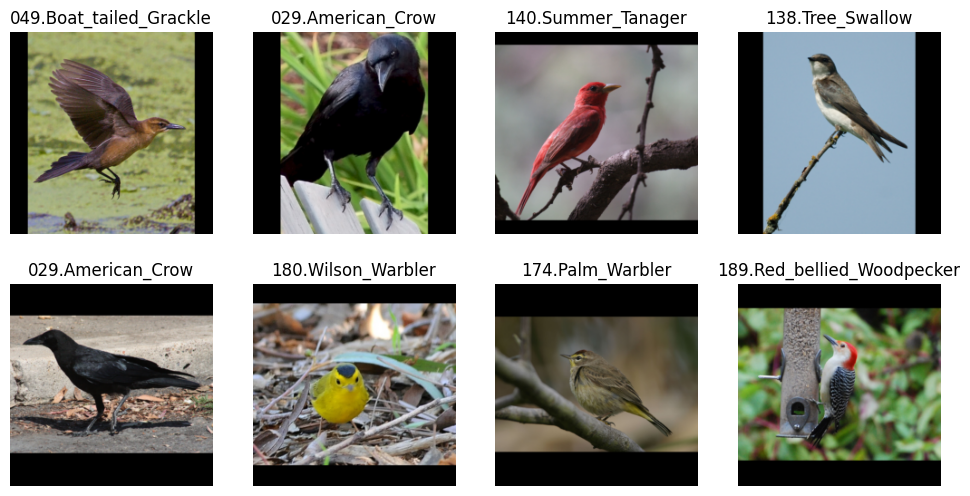

In [7]:

dls.valid.show_batch(max_n=8, nrows=2)

plt.show()


In [8]:
def trainModel(dls, arch, path, epoch_ct=5, metrics=[error_rate, accuracy], pretrained=True):
    model = cnn_learner(dls, arch, metrics=metrics, pretrained=pretrained)
    lr = model.lr_find()[0]
    model.fine_tune(epoch_ct, base_lr=lr)
    model.export(path)
    return model

'''
dls  = Fastai DataLoaders object
arch = Architecture, e.g. resnet50
path = Path to where the trained model should be exported
epoch_ct = Number of iterations
metrics = Metrics to print while training
pretrained = Whether or not to use a pretrained model (False = Create model from scratch)
'''





'\ndls  = Fastai DataLoaders object\narch = Architecture, e.g. resnet50\npath = Path to where the trained model should be exported\nepoch_ct = Number of iterations\nmetrics = Metrics to print while training\npretrained = Whether or not to use a pretrained model (False = Create model from scratch)\n'

/usr/local/lib/python3.11/dist-packages/fastai/vision/learner.py:303: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 90.4MB/s]


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,5.933435,4.729026,0.931269,0.068731,1:19:09


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,5.288840,4.344447,0.878659,0.121341,02:56
1,4.739501,3.713543,0.803564,0.196436,03:00
2,3.982207,3.059700,0.699194,0.300806,03:04
3,3.423540,2.521056,0.603309,0.396691,03:03
4,3.157957,2.203328,0.546033,0.453967,03:02
5,2.704681,1.992968,0.508273,0.491727,03:03
6,2.569910,1.865265,0.479847,0.520153,03:02
7,2.422787,1.797764,0.464574,0.535426,03:03
8,2.289257,1.746113,0.450148,0.549851,03:04
9,2.393911,1.777388,0.459482,0.540518,03:05


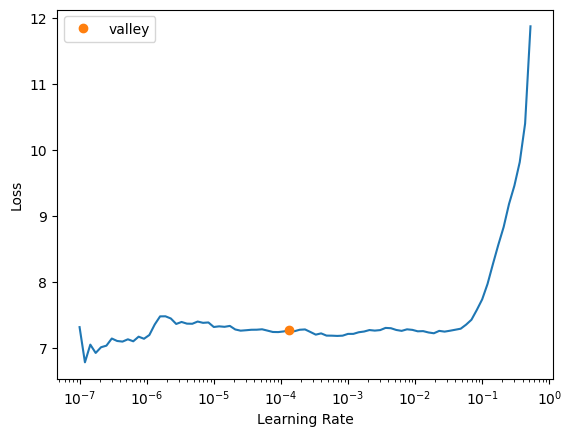

In [9]:

exportPath = './bestModelAdv.pkl'

model = trainModel(dls, resnet50, path=exportPath, epoch_ct=10, metrics=[error_rate, accuracy], pretrained=True)


In [10]:
def confusionMatrix(isModel, model=None, y_true=None, y_pred=None, labels=None, save_image=False, max_labels_for_text=50):
    """
    Plots a confusion matrix.

    Parameters:
    - isModel (bool): If True, uses FastAI model interpretation.
    - model (Learner): FastAI learner (required if isModel=True).
    - y_true, y_pred: Ground truth and predicted labels (required if isModel=False).
    - labels (list): List of class names (optional, recommended for large label sets).
    - save_image (bool): If True, saves the figure as PNG.
    - max_labels_for_text (int): Show matrix values only if label count is below this.
    """
    if isModel:
        interp = ClassificationInterpretation.from_learner(model)
        interp.plot_confusion_matrix(figsize=(12,12), dpi=100)
        if save_image:
            plt.savefig('confusion_matrix_model.png', dpi=300, bbox_inches='tight')
        plt.show()
    else:
        conf_matrix = confusion_matrix(y_true=y_true, y_pred=y_pred, labels=labels)
        num_classes = conf_matrix.shape[0]

        fig_size = max(10, num_classes * 0.2)
        fig, ax = plt.subplots(figsize=(fig_size, fig_size))
        cax = ax.matshow(conf_matrix, cmap=plt.cm.Blues, alpha=0.7)
        fig.colorbar(cax)

        if num_classes <= max_labels_for_text:
            for i in range(num_classes):
                for j in range(num_classes):
                    ax.text(x=j, y=i, s=conf_matrix[i, j], va='center', ha='center', size=6)

        ax.set_xlabel('Predictions', fontsize=14)
        ax.set_ylabel('Actuals', fontsize=14)
        ax.set_title('Confusion Matrix', fontsize=16)

        if labels is not None and num_classes <= 100:
            ax.set_xticks(np.arange(num_classes))
            ax.set_xticklabels(labels, rotation=90, fontsize=6)
            ax.set_yticks(np.arange(num_classes))
            ax.set_yticklabels(labels, fontsize=6)
        else:
            ax.set_xticks([])
            ax.set_yticks([])

        plt.tight_layout()
        if save_image:
            plt.savefig('confusion_matrix_large.png', dpi=300, bbox_inches='tight')
        plt.show()

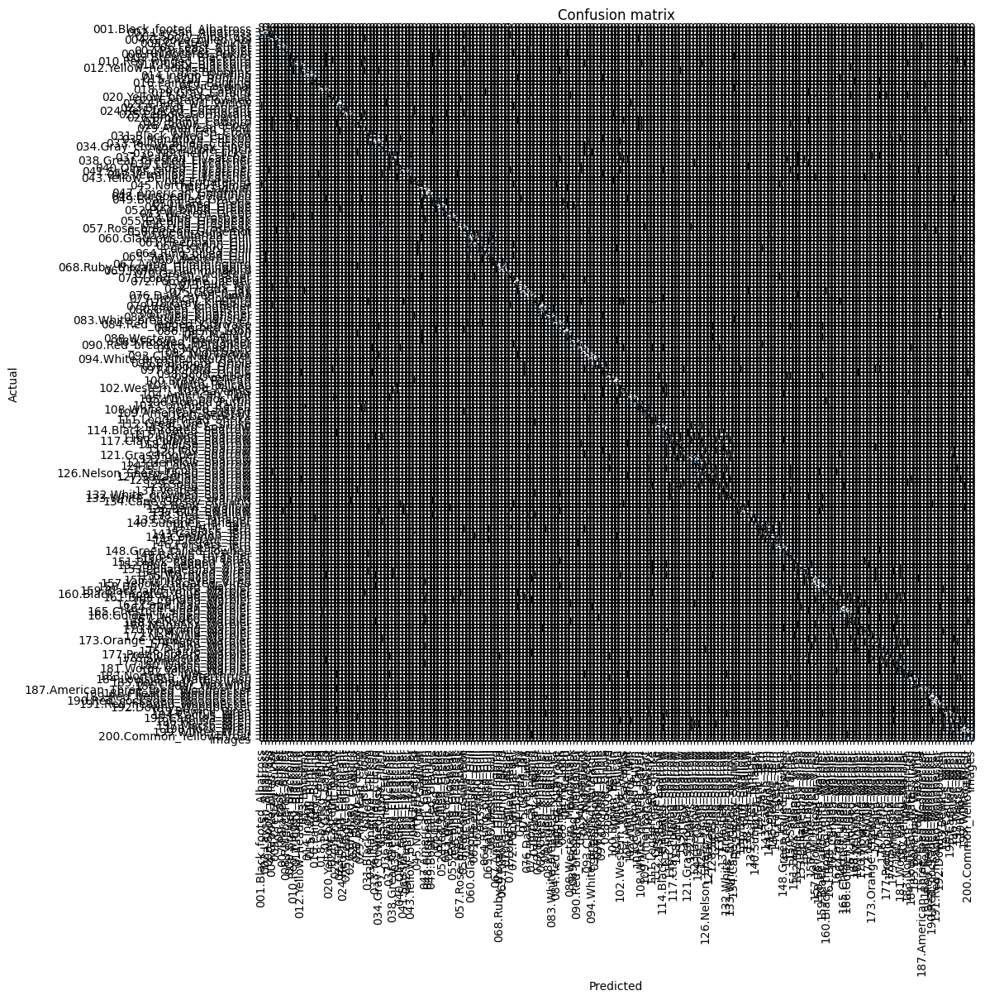

In [11]:
confusionMatrix(isModel=True, model=model)



Used seaborn.heatmap Instead of matplotlib.matshow

In [12]:
import seaborn as sns

def plot_clean_confusion(y_true, y_pred, labels, save_image=False, filename='confusion_matrix_clean.png'):
    cm = confusion_matrix(y_true, y_pred, labels=list(range(len(labels))))
    fig, ax = plt.subplots(figsize=(max(12, len(labels) * 0.3), max(12, len(labels) * 0.3)))
    sns.heatmap(cm, cmap='Blues', xticklabels=labels, yticklabels=labels, square=True, cbar=True, ax=ax)
    ax.set_title('Confusion Matrix')
    ax.set_xlabel('Predicted Labels')
    ax.set_ylabel('True Labels')
    plt.xticks(rotation=90, fontsize=6)
    plt.yticks(fontsize=6)
    plt.tight_layout()
    if save_image:
        plt.savefig(filename, dpi=300)
    plt.show()

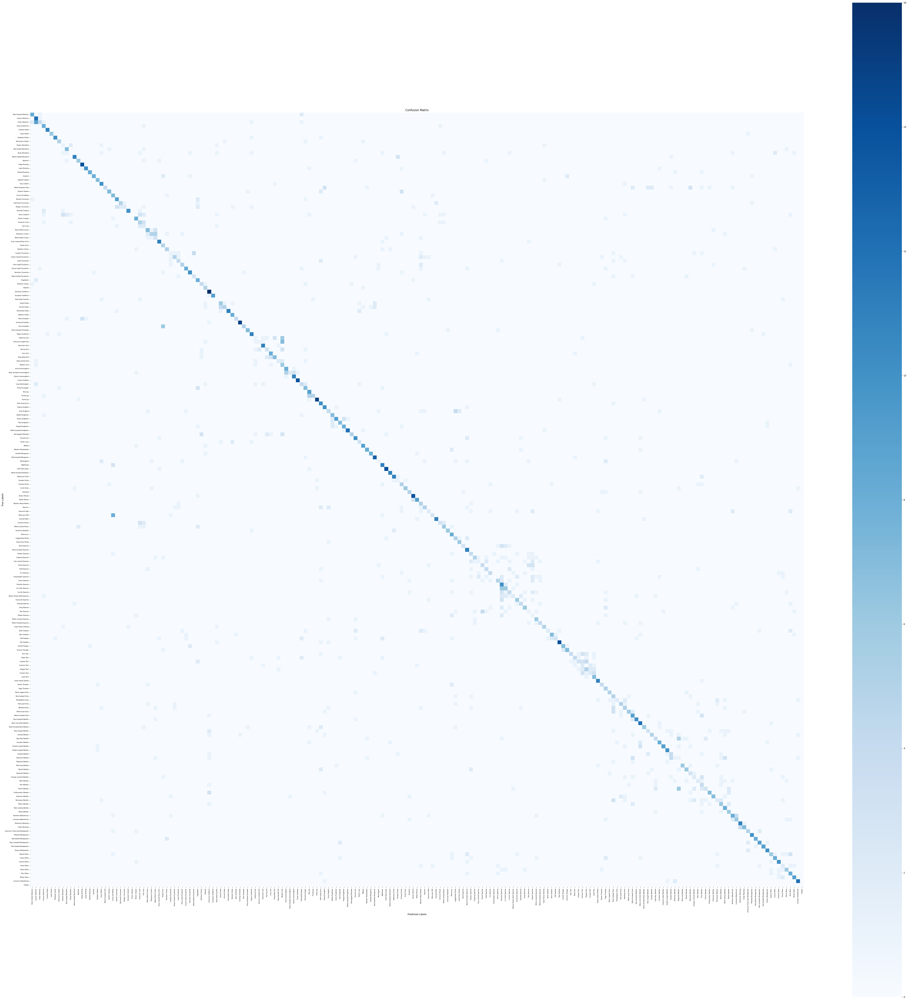

In [13]:
# STEP 1: Get predictions from your trained model
preds, targs = model.get_preds()  # Change to 'learn' if that's your actual variable name
y_true = targs.numpy()
y_pred = preds.argmax(dim=1).numpy()

# STEP 2: Get class names
class_names = dls.vocab
pretty_labels = [lbl.split('.')[-1].replace('_', ' ') for lbl in class_names]

# STEP 3: Plot confusion matrix
plot_clean_confusion(y_true, y_pred, labels=pretty_labels, save_image=True)


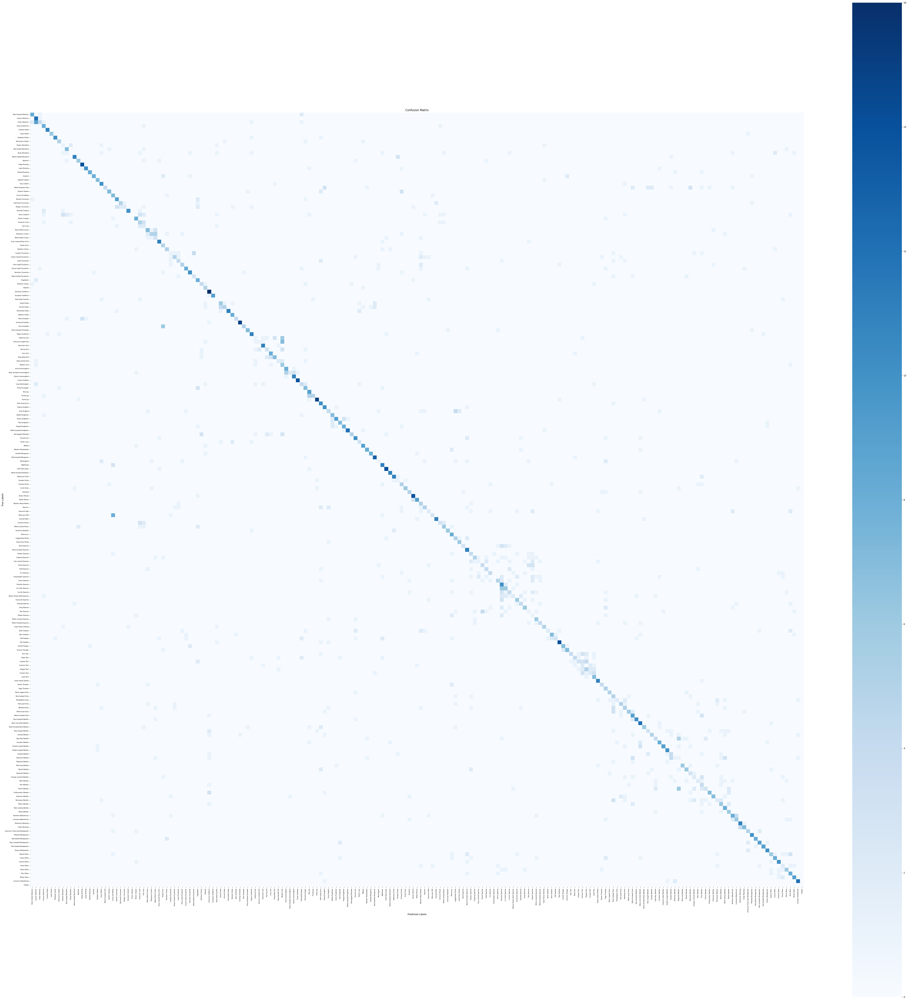

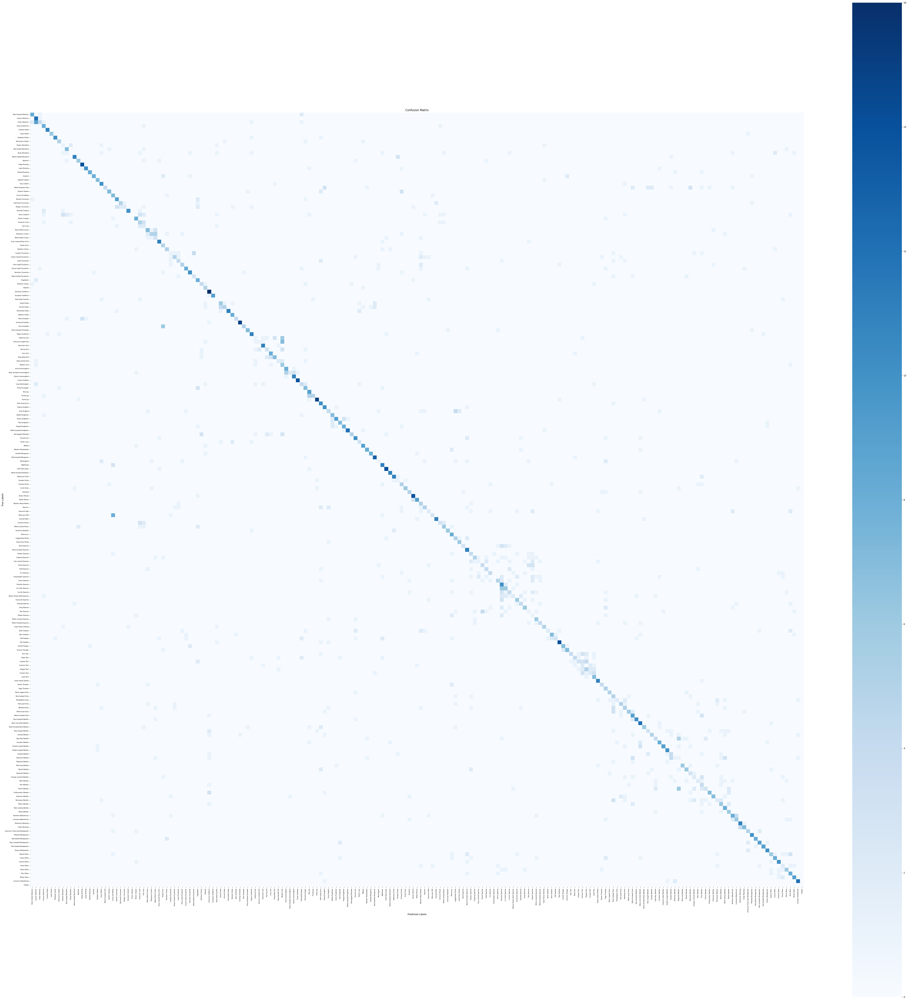

In [14]:
# Generate readable labels
pretty_labels = [lbl.split('.')[-1].replace('_', ' ') for lbl in class_names]

# Plot better version
plot_clean_confusion(y_true, y_pred, labels=pretty_labels, save_image=True)

class_names = dls.vocab
# 1. Get class labels from FastAI
class_names = dls.vocab

# 2. Clean them up for display
pretty_labels = [lbl.split('.')[-1].replace('_', ' ') for lbl in class_names]

# 3. Plot confusion matrix with pretty labels
plot_clean_confusion(y_true, y_pred, labels=pretty_labels, save_image=True)


In [15]:
plt.savefig('confusion_matrix_clean.png', dpi=300)


<Figure size 640x480 with 0 Axes>

In [16]:
'''from google.colab import drive
drive.mount('/content/drive')'''

"from google.colab import drive\ndrive.mount('/content/drive')"

In [17]:
import os

path = '/content/drive/MyDrive/FastAI/CUB_200_2011/images/001.Black_footed_Albatross/Black_Footed_Albatross_0002_55.jpg'
print("Exists?", os.path.exists(path))


Exists? True


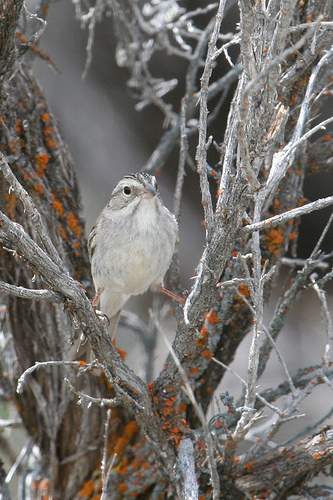

In [18]:
second_img = '///content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0052_107478.jpg'
img = PILImage.create( second_img )
img



In [19]:
get_image_files('/content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0052_107478.jpg')


(#0) []

In [20]:
the_class, _, probs = model.predict(img)
print(the_class)

print(probs)

115.Brewer_Sparrow
tensor([2.4889e-04, 1.5670e-03, 4.2452e-04, 3.4262e-04, 5.5438e-04, 4.9079e-04,
        4.9542e-03, 3.4376e-04, 1.6189e-04, 3.1849e-03, 8.1681e-04, 6.8153e-04,
        3.4331e-05, 6.6685e-04, 1.2669e-03, 5.7940e-04, 1.5177e-04, 8.1781e-05,
        3.9328e-03, 3.5353e-04, 2.7652e-03, 2.5640e-04, 1.7098e-04, 6.3347e-04,
        1.4259e-04, 6.1079e-04, 2.1555e-03, 1.1216e-03, 1.7687e-04, 5.2202e-04,
        3.1586e-04, 1.8742e-04, 1.0095e-03, 4.5953e-03, 2.5129e-05, 1.4220e-04,
        3.9829e-04, 2.9361e-03, 1.0222e-02, 1.8785e-04, 2.0267e-03, 1.2622e-04,
        3.5932e-04, 3.1519e-04, 5.6138e-04, 1.6512e-03, 2.2831e-04, 7.1939e-04,
        1.1729e-03, 1.5303e-04, 1.1830e-04, 6.2010e-04, 1.7914e-04, 6.6707e-04,
        1.0789e-04, 4.8504e-03, 8.5346e-05, 5.3671e-05, 5.1906e-04, 8.8417e-04,
        9.4712e-04, 1.6616e-03, 7.0953e-03, 3.6734e-03, 6.2835e-04, 2.1189e-04,
        3.9358e-04, 1.5024e-05, 5.7523e-04, 2.2490e-04, 1.0669e-04, 2.1507e-05,
        5.8151e-04, 4

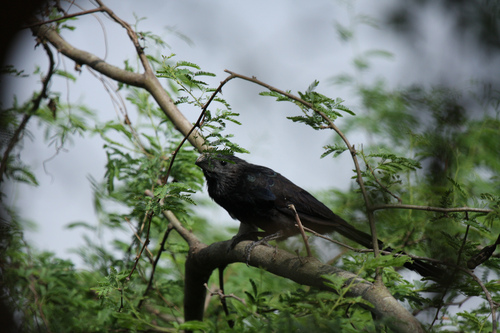

In [21]:
second_img = '/content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0006_1763.jpg'
img = PILImage.create( second_img )
img


In [22]:
the_class, _, probs = model.predict(img)
print(the_class)

print(probs)

004.Groove_billed_Ani
tensor([2.7192e-03, 2.6795e-04, 5.7683e-05, 8.2847e-01, 3.1129e-03, 3.0561e-04,
        9.4959e-05, 6.5997e-04, 1.6247e-03, 9.7601e-04, 1.2133e-03, 9.2000e-05,
        3.8488e-04, 1.0378e-04, 2.1695e-04, 2.5262e-05, 3.0652e-05, 1.0870e-04,
        1.4943e-03, 2.7296e-04, 1.5587e-04, 8.5369e-04, 1.9810e-03, 2.5208e-03,
        3.3627e-03, 3.9553e-03, 2.2695e-03, 3.5490e-03, 2.4360e-03, 7.3825e-03,
        4.6984e-04, 3.4574e-02, 1.6466e-02, 9.3307e-05, 2.2726e-05, 7.1653e-04,
        1.9172e-04, 2.9960e-04, 8.2281e-05, 1.1750e-04, 1.3273e-04, 5.6205e-05,
        3.5924e-04, 7.2139e-05, 3.5628e-05, 1.4483e-03, 1.1017e-04, 1.6446e-05,
        1.2578e-02, 2.8430e-05, 8.5648e-05, 4.5175e-04, 1.6741e-05, 9.7303e-04,
        3.3285e-05, 1.1576e-05, 3.5827e-05, 2.2812e-04, 4.8906e-04, 6.1307e-05,
        2.4426e-04, 3.1907e-04, 1.6766e-04, 5.0942e-05, 1.7922e-06, 8.5169e-05,
        6.2168e-04, 5.4979e-05, 5.2238e-05, 5.3028e-04, 3.3942e-04, 1.4759e-05,
        9.0634e-04

/content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0006_1763.jpg


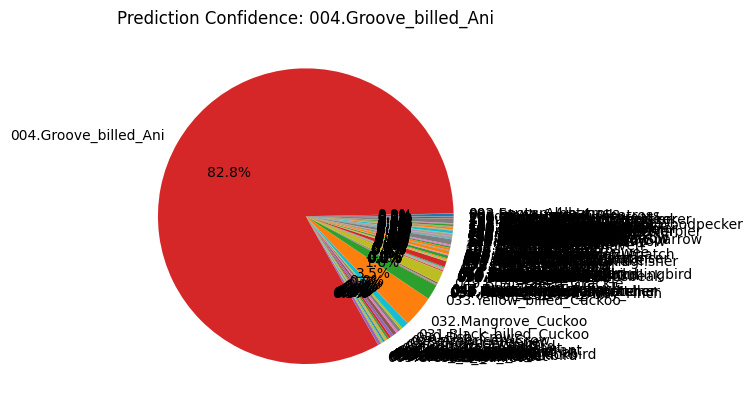

In [23]:
print(second_img)
label, _, probs = model.predict(img)

plt.pie(probs.numpy(), labels=dls.vocab, autopct='%1.1f%%')
plt.title(f"Prediction Confidence: {label}")
plt.show()


In [24]:

the_class, _, probs = model.predict(img)
print(the_class)

print(probs)


004.Groove_billed_Ani
tensor([2.7192e-03, 2.6795e-04, 5.7683e-05, 8.2847e-01, 3.1129e-03, 3.0561e-04,
        9.4959e-05, 6.5997e-04, 1.6247e-03, 9.7601e-04, 1.2133e-03, 9.2000e-05,
        3.8488e-04, 1.0378e-04, 2.1695e-04, 2.5262e-05, 3.0652e-05, 1.0870e-04,
        1.4943e-03, 2.7296e-04, 1.5587e-04, 8.5369e-04, 1.9810e-03, 2.5208e-03,
        3.3627e-03, 3.9553e-03, 2.2695e-03, 3.5490e-03, 2.4360e-03, 7.3825e-03,
        4.6984e-04, 3.4574e-02, 1.6466e-02, 9.3307e-05, 2.2726e-05, 7.1653e-04,
        1.9172e-04, 2.9960e-04, 8.2281e-05, 1.1750e-04, 1.3273e-04, 5.6205e-05,
        3.5924e-04, 7.2139e-05, 3.5628e-05, 1.4483e-03, 1.1017e-04, 1.6446e-05,
        1.2578e-02, 2.8430e-05, 8.5648e-05, 4.5175e-04, 1.6741e-05, 9.7303e-04,
        3.3285e-05, 1.1576e-05, 3.5827e-05, 2.2812e-04, 4.8906e-04, 6.1307e-05,
        2.4426e-04, 3.1907e-04, 1.6766e-04, 5.0942e-05, 1.7922e-06, 8.5169e-05,
        6.2168e-04, 5.4979e-05, 5.2238e-05, 5.3028e-04, 3.3942e-04, 1.4759e-05,
        9.0634e-04

In [25]:
the_class, class_idx, probs = model.predict(img)

print(f"Predicted class: {the_class}")
print(f"Confidence: {probs[class_idx] * 100:.2f}%")

# Print top 3 predictions
top_probs, top_idxs = probs.topk(3)
for i in range(3):
    print(f"{dls.vocab[top_idxs[i]]}: {top_probs[i]*100:.2f}%")


Predicted class: 004.Groove_billed_Ani
Confidence: 82.85%
004.Groove_billed_Ani: 82.85%
032.Mangrove_Cuckoo: 3.46%
033.Yellow_billed_Cuckoo: 1.65%


In [26]:
import os

# Use raw string to preserve spaces exactly
path = r'/content/drive/MyDrive/FastAI/CUB_200_2011/images'
print(os.listdir(path))


['177.Prothonotary_Warbler', '004.Groove_billed_Ani', '031.Black_billed_Cuckoo', '178.Swainson_Warbler', '159.Black_and_white_Warbler', '098.Scott_Oriole', '172.Nashville_Warbler', '100.Brown_Pelican', '005.Crested_Auklet', '015.Lazuli_Bunting', '156.White_eyed_Vireo', '081.Pied_Kingfisher', '067.Anna_Hummingbird', '200.Common_Yellowthroat', '086.Pacific_Loon', '135.Bank_Swallow', '127.Savannah_Sparrow', '149.Brown_Thrasher', '041.Scissor_tailed_Flycatcher', '076.Dark_eyed_Junco', '141.Artic_Tern', '023.Brandt_Cormorant', '099.Ovenbird', '013.Bobolink', '082.Ringed_Kingfisher', '104.American_Pipit', '040.Olive_sided_Flycatcher', '072.Pomarine_Jaeger', '185.Bohemian_Waxwing', '168.Kentucky_Warbler', '034.Gray_crowned_Rosy_Finch', '163.Cape_May_Warbler', '084.Red_legged_Kittiwake', '043.Yellow_bellied_Flycatcher', '144.Common_Tern', '126.Nelson_Sharp_tailed_Sparrow', '035.Purple_Finch', '089.Hooded_Merganser', '029.American_Crow', '116.Chipping_Sparrow', '114.Black_throated_Sparrow', '18

In [27]:
path = '/content/drive/MyDrive/FastAI/CUB_200_2011/images'
!ls -l $path


total 836
drwx------ 2 root root  4096 Apr 13 21:11 001.Black_footed_Albatross
drwx------ 2 root root  4096 Apr 13 21:11 002.Laysan_Albatross
drwx------ 2 root root  4096 Apr 13 21:11 003.Sooty_Albatross
drwx------ 2 root root  4096 Apr 13 21:10 004.Groove_billed_Ani
drwx------ 2 root root  4096 Apr 13 21:10 005.Crested_Auklet
drwx------ 2 root root  4096 Apr 13 21:11 006.Least_Auklet
drwx------ 2 root root  4096 Apr 13 21:11 007.Parakeet_Auklet
drwx------ 2 root root  4096 Apr 13 21:11 008.Rhinoceros_Auklet
drwx------ 2 root root  4096 Apr 13 21:11 009.Brewer_Blackbird
drwx------ 2 root root  4096 Apr 13 21:10 010.Red_winged_Blackbird
drwx------ 2 root root  4096 Apr 13 21:11 011.Rusty_Blackbird
drwx------ 2 root root  4096 Apr 13 21:11 012.Yellow_headed_Blackbird
drwx------ 2 root root  4096 Apr 13 21:10 013.Bobolink
drwx------ 2 root root  4096 Apr 13 21:11 014.Indigo_Bunting
drwx------ 2 root root  4096 Apr 13 21:10 015.Lazuli_Bunting
drwx------ 2 root root  4096 Apr 13 21:11 016.P

In [28]:
from fastai.vision.all import *

# Automatically get all image folders (class names)
path = Path('/content/drive/MyDrive/FastAI/CUB_200_2011/images')
folders = [f.name for f in path.ls() if f.is_dir()]
print(f" Found class folders: {folders}")


 Found class folders: ['177.Prothonotary_Warbler', '004.Groove_billed_Ani', '031.Black_billed_Cuckoo', '178.Swainson_Warbler', '159.Black_and_white_Warbler', '098.Scott_Oriole', '172.Nashville_Warbler', '100.Brown_Pelican', '005.Crested_Auklet', '015.Lazuli_Bunting', '156.White_eyed_Vireo', '081.Pied_Kingfisher', '067.Anna_Hummingbird', '200.Common_Yellowthroat', '086.Pacific_Loon', '135.Bank_Swallow', '127.Savannah_Sparrow', '149.Brown_Thrasher', '041.Scissor_tailed_Flycatcher', '076.Dark_eyed_Junco', '141.Artic_Tern', '023.Brandt_Cormorant', '099.Ovenbird', '013.Bobolink', '082.Ringed_Kingfisher', '104.American_Pipit', '040.Olive_sided_Flycatcher', '072.Pomarine_Jaeger', '185.Bohemian_Waxwing', '168.Kentucky_Warbler', '034.Gray_crowned_Rosy_Finch', '163.Cape_May_Warbler', '084.Red_legged_Kittiwake', '043.Yellow_bellied_Flycatcher', '144.Common_Tern', '126.Nelson_Sharp_tailed_Sparrow', '035.Purple_Finch', '089.Hooded_Merganser', '029.American_Crow', '116.Chipping_Sparrow', '114.Black_

In [29]:
path = Path("/content/drive/MyDrive/FastAI/CUB_200_2011/images")
folders = [f.name for f in path.ls() if f.is_dir()]
print(f" Class folders found: {folders}")



 Class folders found: ['177.Prothonotary_Warbler', '004.Groove_billed_Ani', '031.Black_billed_Cuckoo', '178.Swainson_Warbler', '159.Black_and_white_Warbler', '098.Scott_Oriole', '172.Nashville_Warbler', '100.Brown_Pelican', '005.Crested_Auklet', '015.Lazuli_Bunting', '156.White_eyed_Vireo', '081.Pied_Kingfisher', '067.Anna_Hummingbird', '200.Common_Yellowthroat', '086.Pacific_Loon', '135.Bank_Swallow', '127.Savannah_Sparrow', '149.Brown_Thrasher', '041.Scissor_tailed_Flycatcher', '076.Dark_eyed_Junco', '141.Artic_Tern', '023.Brandt_Cormorant', '099.Ovenbird', '013.Bobolink', '082.Ringed_Kingfisher', '104.American_Pipit', '040.Olive_sided_Flycatcher', '072.Pomarine_Jaeger', '185.Bohemian_Waxwing', '168.Kentucky_Warbler', '034.Gray_crowned_Rosy_Finch', '163.Cape_May_Warbler', '084.Red_legged_Kittiwake', '043.Yellow_bellied_Flycatcher', '144.Common_Tern', '126.Nelson_Sharp_tailed_Sparrow', '035.Purple_Finch', '089.Hooded_Merganser', '029.American_Crow', '116.Chipping_Sparrow', '114.Black_

In [30]:
from PIL import Image
import os
from fastai.vision.all import *

# Correct original image path
image_folder = "/content/drive/MyDrive/FastAI/"
original_img = get_image_files(image_folder)[0]

# Output adversarial image path
output_dir = "/content/drive/MyDrive/FastAI/CUB_200_2011/images"
os.makedirs(output_dir, exist_ok=True)
output_img = f"{output_dir}/1.jpg"

# Create adversarial-looking image
img = Image.open(original_img).convert("RGBA")
overlay = Image.new("RGBA", (60, 40), (255, 255, 255, 160))
img.paste(overlay, (10, 10), overlay)
img.convert("RGB").save(output_img)


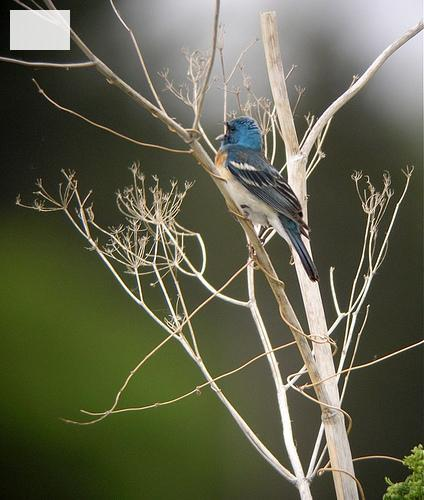

In [31]:
img = PILImage.create(output_img)
img


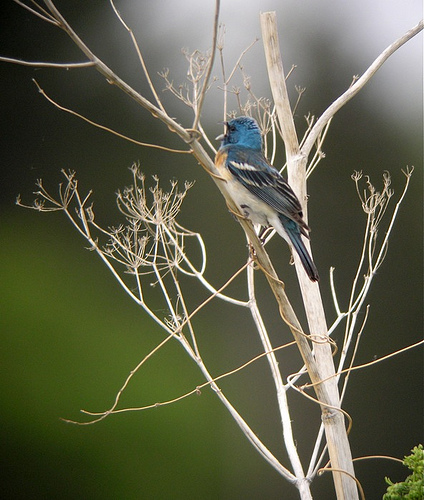

In [32]:
second_img = '/content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0015_14690.jpg'
img = PILImage.create(second_img)
img


In [33]:

the_class, _, probs = model.predict(img)
print(the_class)

print(probs)


054.Blue_Grosbeak
tensor([9.5639e-05, 3.6964e-05, 1.3561e-03, 9.8302e-04, 3.8473e-04, 2.7771e-04,
        1.5322e-04, 7.9777e-05, 2.9634e-04, 2.8857e-03, 1.0424e-04, 3.1273e-04,
        7.3638e-03, 1.7614e-02, 1.9569e-01, 5.0897e-04, 3.3811e-04, 1.2670e-04,
        4.1853e-04, 1.7584e-04, 6.3122e-04, 3.5703e-05, 6.8429e-04, 2.1230e-04,
        1.7847e-04, 5.4281e-04, 1.4815e-04, 3.5630e-05, 2.2374e-04, 1.5078e-04,
        5.8133e-05, 1.4144e-04, 5.1256e-04, 5.0570e-05, 2.3029e-03, 8.8360e-05,
        1.5862e-04, 3.3781e-05, 4.6705e-04, 4.1270e-05, 1.5419e-03, 2.6624e-04,
        1.1025e-04, 8.5631e-05, 2.8028e-05, 1.9578e-04, 4.5749e-04, 2.1273e-04,
        1.6158e-03, 3.7197e-05, 1.3072e-04, 1.0371e-04, 5.6642e-05, 3.9226e-01,
        1.7820e-04, 9.6407e-04, 3.6546e-04, 2.6348e-04, 5.7098e-05, 1.7755e-04,
        1.4039e-04, 1.2986e-04, 3.2057e-04, 1.7930e-04, 2.1395e-04, 1.7139e-04,
        1.5903e-04, 8.5083e-05, 3.4403e-04, 1.1662e-02, 9.2333e-05, 5.5587e-04,
        5.0436e-02, 6.

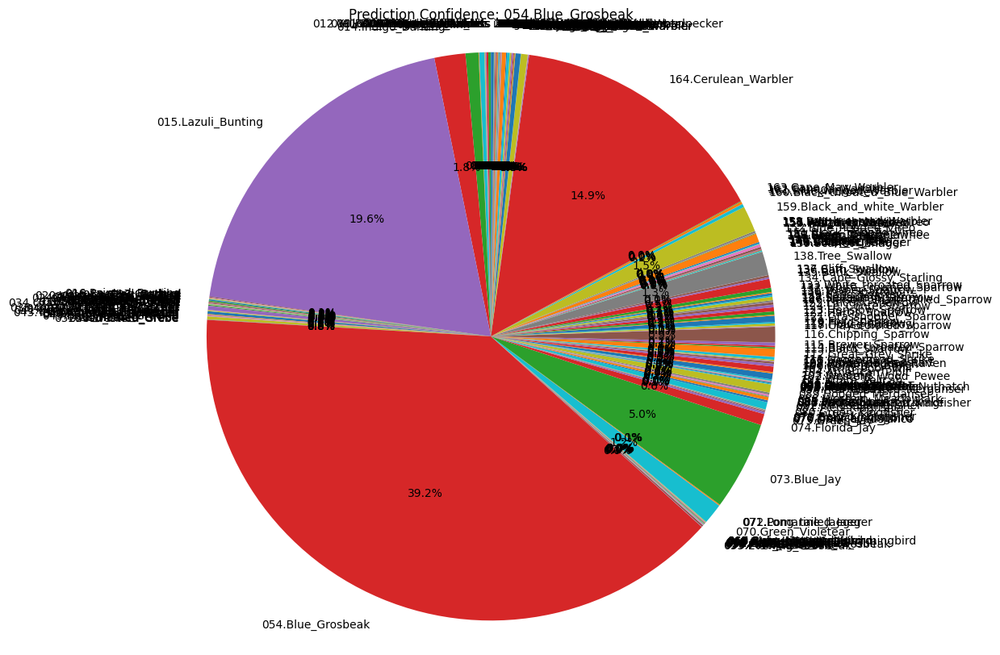

In [34]:
import matplotlib.pyplot as plt

# Assume 'probs' contains prediction probabilities from:
# the_class, _, probs = model.predict(img)

# Convert tensor to numpy
np_data = probs.numpy()

# Use actual class names from the dataset
labels = dls.vocab  # this will be a list like ['biryani', 'samosa', ...]

# Create pie chart of prediction probabilities
plt.figure(figsize=(10, 10))
plt.pie(np_data, labels=labels, autopct='%1.1f%%', startangle=90)
plt.title(f"Prediction Confidence: {the_class}")
plt.axis('equal')  # ensures the pie is drawn as a circle
plt.show()



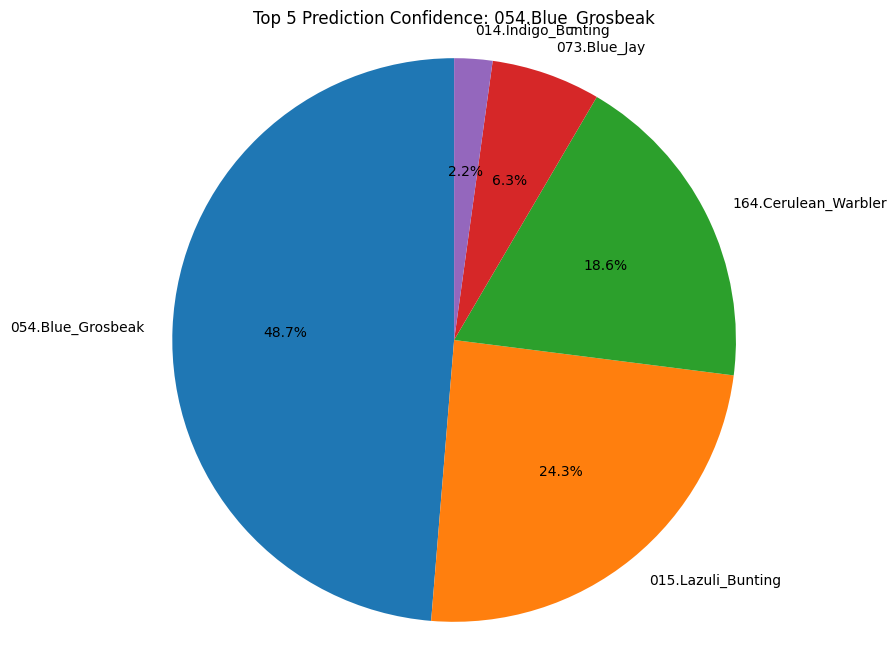

In [35]:
import matplotlib.pyplot as plt
import torch

# Get top 5 predictions from the model's output
top_probs, top_idxs = torch.topk(probs, 5)

# Convert to numpy for plotting
top_probs = top_probs.numpy()
top_labels = [dls.vocab[i] for i in top_idxs]

# Plot pie chart
plt.figure(figsize=(8, 8))
plt.pie(top_probs, labels=top_labels, autopct='%1.1f%%', startangle=90)
plt.title(f"Top 5 Prediction Confidence: {the_class}")
plt.axis('equal')
plt.show()


In [36]:
#import os

# Path to the root of your adversarial images
mypath = "/content/drive/MyDrive/FastAI/CUB_200_2011/images"

# Get all image file paths recursively
ras5 = [os.path.join(dirpath, f) for (dirpath, dirnames, filenames) in os.walk(mypath) for f in filenames if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

print(f" Found {len(ras5)} adversarial image(s)")
print(ras5[:5])  # Show first 5 paths as preview



 Found 11789 adversarial image(s)
['/content/drive/MyDrive/FastAI/CUB_200_2011/images/1.jpg', '/content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0069_174210.jpg', '/content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0062_174412.jpg', '/content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0076_174118.jpg', '/content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0046_174104.jpg']


In [37]:
for img_path in ras5:
    img = PILImage.create(img_path)
    pred_class, _, pred_probs = model.predict(img)

    print(f" Image: {img_path}")
    print(f" Predicted: {pred_class}")
    print(f" Top confidence: {pred_probs.max().item() * 100:.2f}%")
    print("-" * 60)


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/1.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 31.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0069_174210.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 90.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0062_174412.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 86.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0076_174118.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 88.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0046_174104.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 31.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0124_173686.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 66.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0098_173913.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 24.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0008_173425.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 93.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0088_173606.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 95.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0112_174594.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 43.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0063_173830.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 95.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0079_173899.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 34.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0084_173939.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 57.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0066_174318.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 86.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0082_173970.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 24.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0109_174121.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 31.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0055_173419.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 56.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0097_174554.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 98.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0116_173444.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 60.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0021_173816.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 98.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0064_174106.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 33.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0020_174122.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 27.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0045_173536.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 53.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0037_173418.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 91.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0073_174607.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 72.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0058_173440.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 39.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0038_173867.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 26.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0083_173929.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 68.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0110_173857.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 34.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0108_174125.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 94.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0070_174650.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 70.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0096_174372.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 32.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0074_173443.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 88.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0004_173475.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 81.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0033_174123.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 67.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0018_174196.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 14.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0127_174149.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 84.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0022_174138.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 30.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0089_174636.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 76.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0102_174595.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 43.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0047_174340.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 23.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0023_173788.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 90.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0090_174183.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 24.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0059_173434.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 65.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0094_173607.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 74.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0031_174578.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 96.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0040_173447.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 69.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0085_173829.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 64.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0100_174539.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 44.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0054_174556.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 25.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0117_174622.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 74.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0049_174213.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 51.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0106_174221.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 12.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0065_173422.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 62.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0019_173838.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 16.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0057_173865.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 81.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0121_174643.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 92.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0081_173510.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 86.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0071_173690.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 96.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0107_173921.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 58.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/177.Prothonotary_Warbler/Prothonotary_Warbler_0105_174097.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 31.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0080_1549.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 73.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0044_1731.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 22.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0090_1567.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 91.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0051_1650.jpg
 Predicted: 107.Common_Raven
 Top confidence: 25.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0058_1751.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 84.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0007_1615.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 92.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0071_1559.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 60.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0018_1613.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 78.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0076_1661.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 76.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0032_1776.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 95.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0072_1696.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 97.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0004_1528.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 69.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0012_1784.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 71.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0077_1724.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 59.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0061_1510.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 75.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0056_1493.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 37.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0036_1604.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 90.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0015_1653.jpg
 Predicted: 110.Geococcyx
 Top confidence: 18.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0006_1763.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 82.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0105_1562.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 95.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0085_1612.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 33.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0091_1728.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 54.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0047_1706.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 45.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0023_1485.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 62.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0002_1670.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 78.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0033_1494.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 95.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0065_1502.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 31.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0027_1754.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 77.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0055_1501.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 86.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0019_1585.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 75.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0069_1546.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 37.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0074_1730.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 70.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0010_1704.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 72.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0087_1765.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 29.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0088_1678.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 88.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0053_1672.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 86.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0109_1592.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 91.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0100_1646.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 61.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0040_1715.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 88.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0082_1697.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 88.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0092_1516.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 93.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0031_1588.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 51.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0101_1700.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 92.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0107_1590.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 78.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0062_1767.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 60.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0059_1480.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 93.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0046_1663.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 79.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0005_1750.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 19.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0035_1591.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 84.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0068_1538.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 79.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0075_1617.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 73.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0029_1620.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 62.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0108_1639.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 71.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0014_1755.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 30.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0078_1780.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 94.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0094_1540.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 61.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0009_1522.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 90.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0017_1561.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 80.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0037_1560.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 22.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/004.Groove_billed_Ani/Groove_Billed_Ani_0060_1505.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 38.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0024_795331.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 76.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0069_795326.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 11.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0047_26176.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 17.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0082_26241.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 19.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0028_26165.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 58.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0058_795292.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 38.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0061_795327.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 7.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0093_795316.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 72.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0084_26175.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 37.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0079_26180.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 22.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0055_26223.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 60.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0092_795313.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 39.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0053_795321.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 17.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0081_26209.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 15.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0019_795329.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 49.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0066_26303.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 79.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0057_795323.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 55.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0090_26311.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 32.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0086_26188.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 26.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0087_795300.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 19.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0054_26313.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 11.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0001_26242.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 18.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0077_26222.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 81.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0070_795310.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 82.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0096_26204.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 21.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0075_795298.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 66.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0005_26161.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 39.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0088_26217.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 86.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0074_795286.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 36.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0031_26318.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 43.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0062_795309.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 62.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0042_795308.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 48.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0091_26246.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 60.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0065_26203.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 28.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0017_26221.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 20.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0043_795324.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 50.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0023_26258.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 30.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0006_26233.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 16.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0051_795318.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 27.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0037_795330.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 18.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0018_26218.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 11.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0095_795307.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 50.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0073_795304.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 18.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0076_26177.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 60.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0045_26194.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 43.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0083_795315.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 37.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0015_26208.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 14.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0030_26240.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 49.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0085_795294.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 81.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0022_795319.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 25.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0034_795320.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 18.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0032_26292.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 4.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0052_26232.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 19.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0007_26320.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 40.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0027_26319.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 10.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0071_26288.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 74.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0008_795305.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 26.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0044_26243.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 39.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0046_795328.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 25.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/031.Black_billed_Cuckoo/Black_Billed_Cuckoo_0089_795322.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 71.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0019_174692.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 18.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0040_794860.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 29.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0024_794885.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 17.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0004_794874.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 41.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0049_794880.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 21.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0023_174717.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 22.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0018_174715.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 28.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0017_174685.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 16.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0007_174745.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 26.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0025_794881.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 48.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0051_794900.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 11.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0039_794859.jpg
 Predicted: 196.House_Wren
 Top confidence: 54.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0021_794898.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 22.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0044_794894.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 52.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0054_174689.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 5.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0032_174728.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 12.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0043_794865.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 18.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0034_794890.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 37.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0011_174680.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 38.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0041_794893.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 20.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0037_174691.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 57.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0020_794863.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 9.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0048_794887.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 27.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0047_794870.jpg
 Predicted: 099.Ovenbird
 Top confidence: 11.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0022_794868.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 23.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0038_794882.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 13.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0002_174683.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 10.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0030_794864.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 60.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0036_174699.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 24.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0045_794876.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 39.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0050_794861.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 27.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0031_174696.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 25.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0033_794856.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 20.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0016_174705.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 10.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0008_794886.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 31.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0055_794899.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 11.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0015_794891.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 41.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0009_174746.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 14.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0056_794871.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 30.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0014_794858.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 45.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0026_794884.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 16.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0027_794877.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 11.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0053_174678.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 18.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0001_794869.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 7.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0006_794857.jpg
 Predicted: 068.Ruby_throated_Hummingbird
 Top confidence: 17.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0010_174724.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 23.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0029_794883.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 61.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0005_794888.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 18.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0012_174739.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 19.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0013_794892.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 26.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0042_794895.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 13.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0003_794866.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 12.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0052_794875.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 25.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0035_174741.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 47.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0028_794896.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 25.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/178.Swainson_Warbler/Swainson_Warbler_0046_794872.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 80.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0102_160073.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 90.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0022_160512.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 98.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0077_160440.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 58.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0078_160365.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 9.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0035_160102.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 97.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0119_160898.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 77.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0060_160764.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 97.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0007_160758.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 90.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0048_160287.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 72.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0046_160202.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 22.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0081_110906.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 64.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0028_160371.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 98.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0117_160369.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 89.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0057_160037.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 88.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0098_160808.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 92.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0074_160361.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 42.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0018_160438.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 28.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0095_160406.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 90.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0065_160111.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 79.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0053_160010.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 93.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0115_160654.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 89.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0072_160353.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 86.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0127_160031.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 43.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0041_160639.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 99.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0001_160352.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 35.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0021_160686.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 93.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0086_160836.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 86.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0051_160603.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 89.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0080_160375.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 97.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0031_160773.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 93.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0122_160106.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 59.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0111_160342.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 74.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0135_160334.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 99.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0076_160173.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 27.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0085_160110.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 95.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0089_160370.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 75.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0114_160537.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 99.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0002_160376.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 95.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0083_160237.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 98.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0061_160404.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 83.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0091_160896.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 96.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0118_160363.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 91.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0106_160014.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 70.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0073_160539.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 38.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0032_160569.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 71.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0109_160245.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 84.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0010_160200.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 91.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0003_160228.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 85.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0030_160592.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 78.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0125_160482.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 83.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0024_160057.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 25.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0128_160803.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 91.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0034_160695.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 44.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0071_160308.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 96.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0049_160749.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 71.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0090_160247.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 56.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0025_160584.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 86.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0070_160354.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 29.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0088_160668.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 48.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/159.Black_and_white_Warbler/Black_And_White_Warbler_0047_160547.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 51.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0029_795846.jpg
 Predicted: 013.Bobolink
 Top confidence: 42.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0078_795833.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 91.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0016_92398.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 55.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0058_795849.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 56.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0005_92362.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 34.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0068_795804.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 29.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0043_795828.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 12.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0022_92356.jpg
 Predicted: 075.Green_Jay
 Top confidence: 12.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0045_92237.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 20.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0001_795826.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 25.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0064_92321.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 17.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0003_92247.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 18.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0042_795844.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 88.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0025_92207.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 28.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0019_795815.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 90.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0031_90270.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 43.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0030_795830.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 29.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0023_795835.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 32.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0032_795810.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 73.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0024_92302.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 23.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0067_795858.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 39.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0012_795837.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 86.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0075_795817.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 90.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0040_795839.jpg
 Predicted: 013.Bobolink
 Top confidence: 18.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0077_795831.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 12.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0069_92271.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 71.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0008_795814.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 16.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0056_795816.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 56.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0051_795807.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 72.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0085_92206.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 13.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0083_795821.jpg
 Predicted: 018.Spotted_Catbird
 Top confidence: 10.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0028_92270.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 34.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0018_795840.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 44.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0063_795812.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 49.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0046_92371.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 22.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0038_795818.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 67.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0044_92262.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 13.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0011_795836.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 7.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0002_795829.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 53.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0014_795827.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 27.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0036_795850.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 47.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0053_795805.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 44.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0070_795808.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 53.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0054_92310.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 20.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0084_795860.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 45.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0052_92440.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 10.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0081_92374.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 30.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0072_795822.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 48.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0073_92369.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 23.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0007_92439.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 15.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0017_795832.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 37.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0065_795819.jpg
 Predicted: 013.Bobolink
 Top confidence: 41.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0015_795862.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 26.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0035_795851.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 46.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0079_92248.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 8.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0010_795852.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 23.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0057_795856.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 45.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0034_795813.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 19.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0071_795848.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 88.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/098.Scott_Oriole/Scott_Oriole_0055_795825.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 32.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0032_167385.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 22.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0110_167268.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 21.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0118_167350.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 20.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0048_167071.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 17.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0081_167234.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 16.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0051_167250.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 20.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0079_167213.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 55.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0092_167457.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 69.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0076_167389.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 12.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0100_167226.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 17.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0129_167053.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 40.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0006_167497.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 31.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0102_167195.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 20.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0036_167461.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 28.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0064_167411.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 17.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0121_167078.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 22.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0128_166444.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 23.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0023_167242.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 59.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0098_167293.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 22.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0108_167259.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 19.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0035_167283.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 15.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0068_167266.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 21.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0104_167096.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 23.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0053_167403.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 44.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0055_167331.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 22.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0028_167065.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 9.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0103_167455.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 13.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0050_167475.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 17.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0060_167347.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 16.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0040_167454.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 15.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0127_167494.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 35.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0029_167044.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 21.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0014_167190.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 12.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0086_167045.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 42.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0004_167146.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 17.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0109_167428.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 10.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0018_167191.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 29.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0130_167101.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 16.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0015_167429.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 19.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0042_167346.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 30.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0115_167039.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 24.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0054_167258.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 24.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0005_167103.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 18.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0056_167123.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 22.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0041_167534.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 9.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0061_167355.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 24.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0105_167452.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 35.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0075_167419.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 16.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0020_167198.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 10.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0123_167324.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 8.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0057_167008.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 73.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0037_167280.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 37.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0120_167149.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 18.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0027_167224.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 24.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0126_167274.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 43.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0001_167117.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 74.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0124_167285.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 37.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0013_167326.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 45.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0044_167357.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 59.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/172.Nashville_Warbler/Nashville_Warbler_0107_167186.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 32.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0025_95218.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 75.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0002_94773.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 68.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0095_94290.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 98.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0115_93731.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 75.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0013_93589.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 68.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0071_94549.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 69.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0129_94074.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 81.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0103_94787.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 72.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0011_94683.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 89.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0067_94529.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 98.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0043_94506.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 75.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0085_95053.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 98.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0036_93843.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 70.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0118_93475.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 68.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0121_94067.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 89.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0088_94076.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 82.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0140_93438.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 79.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0010_94370.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 77.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0068_94430.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 86.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0056_95229.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 96.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0111_93872.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 78.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0123_94368.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 89.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0007_94078.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 98.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0020_95422.jpg
 Predicted: 044.Frigatebird
 Top confidence: 23.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0131_94464.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 87.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0086_93757.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 82.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0080_93439.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 75.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0031_93874.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 66.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0077_93464.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 97.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0100_94434.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 80.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0125_93461.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 66.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0141_94533.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 99.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0139_93995.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 47.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0040_94051.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 93.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0110_93622.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 80.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0070_93678.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 82.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0122_94022.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 80.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0017_94383.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 94.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0072_94974.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 97.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0003_94427.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 89.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0019_95158.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 92.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0102_93727.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 99.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0124_93684.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 75.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0012_94079.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 90.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0075_95357.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 75.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0066_94840.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 69.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0018_94432.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 85.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0051_94578.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 91.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0074_93692.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 84.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0127_93700.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 81.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0039_95216.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 94.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0097_93767.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 96.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0009_94256.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 54.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0073_94823.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 82.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0081_94085.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 81.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0087_94358.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 55.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0049_94598.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 99.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0059_94504.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 96.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0041_93720.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 40.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/100.Brown_Pelican/Brown_Pelican_0128_94059.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 59.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0072_785260.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 33.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0010_794907.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 90.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0057_794932.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 80.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0061_794904.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 85.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0033_794964.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 11.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0077_785257.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 30.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0076_785252.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 89.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0039_794944.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 89.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0047_794918.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 95.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0067_785249.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 86.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0040_794912.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 54.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0069_785258.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 23.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0012_794960.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 35.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0063_794901.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 38.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0003_794962.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 31.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0019_794925.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 87.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0030_794937.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 96.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0018_1817.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 36.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0066_785251.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 59.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0052_794952.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 36.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0001_794941.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 86.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0013_794914.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 49.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0032_794931.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 59.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0073_785248.jpg
 Predicted: 007.Parakeet_Auklet
 Top confidence: 7.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0071_785255.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 37.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0029_1824.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 78.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0075_785259.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 13.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0005_794922.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 94.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0045_794940.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 97.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0062_794968.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 73.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0053_794966.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 54.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0068_785253.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 38.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0070_785261.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 93.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0041_794910.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 18.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0021_794938.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 74.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0006_1813.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 73.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0028_794951.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 95.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0042_794902.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 98.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0044_1825.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 26.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0011_794927.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 74.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0048_1791.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 23.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0059_794929.jpg
 Predicted: 007.Parakeet_Auklet
 Top confidence: 78.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0036_794905.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 78.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/005.Crested_Auklet/Crested_Auklet_0074_794949.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 54.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0015_14690.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 39.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0074_14854.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 65.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0004_14887.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 98.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0020_14837.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 92.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0086_14992.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 51.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0054_14714.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 62.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0105_15017.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 34.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0107_14705.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 58.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0039_15081.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 67.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0027_14895.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 79.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0055_15043.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 92.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0089_14598.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 62.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0010_14915.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 70.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0067_14672.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 63.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0095_14919.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 92.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0034_14864.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 50.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0080_14893.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 94.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0046_14787.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 62.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0045_14954.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 78.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0031_15018.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 84.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0102_14605.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 92.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0041_15152.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 42.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0081_14709.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 58.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0009_15163.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 98.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0082_15047.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 98.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0073_14594.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 92.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0008_15195.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 64.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0087_15096.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 82.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0061_15155.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 75.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0014_14824.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 94.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0084_14815.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 51.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0066_14914.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 82.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0076_14662.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 44.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0059_14749.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 42.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0097_14617.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 47.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0057_14775.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 83.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0052_14618.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 84.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0056_15032.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 87.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0048_14844.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 58.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0047_14863.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 76.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0035_14920.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 56.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0021_14686.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 99.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0037_15021.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 39.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0042_14820.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 86.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0030_14986.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 97.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0040_14923.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 95.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0085_14627.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 20.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0078_15164.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 98.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0101_14873.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 41.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0001_14916.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 94.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0070_14665.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 98.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0093_15030.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 97.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0025_15079.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 67.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0092_14656.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 50.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0032_14778.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 90.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0028_14950.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 64.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0026_14669.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 40.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/015.Lazuli_Bunting/Lazuli_Bunting_0094_11894.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 50.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0009_158830.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 27.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0125_159078.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 20.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0129_158823.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 26.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0040_159101.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 19.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0110_158947.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 12.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0128_158993.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 11.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0050_158829.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 19.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0002_159180.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 33.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0066_159477.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 16.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0015_159081.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 25.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0082_159186.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 28.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0071_159072.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 13.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0126_159341.jpg
 Predicted: 176.Prairie_Warbler
 Top confidence: 14.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0102_159420.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 9.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0032_159145.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 25.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0122_159284.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 8.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0080_159087.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 17.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0019_159095.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 16.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0012_159495.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 23.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0118_159036.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 28.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0136_156418.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 21.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0016_158978.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 45.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0064_159286.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 16.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0074_159279.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 25.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0033_159079.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 20.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0030_159265.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 42.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0029_159334.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 33.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0042_159012.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 16.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0085_159119.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 16.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0094_158894.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 11.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0041_159032.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 29.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0088_159084.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 9.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0132_158908.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 34.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0116_159028.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 12.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0001_159237.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 24.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0018_159450.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 14.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0086_159202.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 9.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0135_158955.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 18.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0051_159033.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 17.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0061_159042.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 12.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0134_158889.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 34.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0111_158864.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 13.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0095_158886.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 7.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0024_159193.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 29.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0120_158991.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 36.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0112_159147.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 23.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0083_159203.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 14.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0046_158849.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 19.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0114_159206.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 16.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0099_158933.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 63.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0091_159045.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 13.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0130_159075.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 27.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0090_158958.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 20.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0026_158963.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 18.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0022_159037.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 22.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0045_159232.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 16.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0059_159225.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 12.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0078_159382.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 16.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0115_158932.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 23.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/156.White_eyed_Vireo/White_Eyed_Vireo_0049_158835.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 30.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0122_71789.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 84.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0083_72430.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 88.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0017_72316.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0063_71999.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 90.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0062_72379.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 24.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0080_72199.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 93.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0071_72576.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 80.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0040_72739.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 25.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0026_71875.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 96.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0075_72581.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 97.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0011_72143.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 89.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0024_71560.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 45.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0016_72280.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 89.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0074_71830.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 91.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0106_71404.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 78.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0107_71987.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 58.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0029_72440.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 73.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0121_72378.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 83.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0019_72659.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 64.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0061_72193.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 98.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0093_72465.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 92.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0128_72775.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 92.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0007_72438.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 43.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0046_72156.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 81.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0022_72247.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 91.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0109_72082.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 94.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0014_72119.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 97.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0051_71429.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 79.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0073_72508.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0033_71883.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 83.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0021_72498.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 52.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0028_72221.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 90.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0002_71698.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 52.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0047_72401.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 96.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0068_72278.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0097_71895.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 84.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0030_72603.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 37.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0036_72275.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 92.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0015_72299.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 80.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0059_72492.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0102_72349.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 62.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0067_71641.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 72.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0054_72296.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0031_71829.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0095_72008.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 95.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0118_72115.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 30.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0078_71985.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 87.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0027_71434.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 54.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0013_72114.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0045_71143.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 57.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0117_71947.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 93.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0132_72706.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 82.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0065_71871.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0004_72135.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 67.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0032_71792.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 98.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0085_71557.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0025_72469.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 39.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0116_71900.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 28.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0053_72761.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 17.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/081.Pied_Kingfisher/Pied_Kingfisher_0018_71657.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 97.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0043_56059.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 18.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0102_56087.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 33.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0038_57036.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 66.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0112_56353.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 56.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0047_56049.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 38.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0029_55823.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 54.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0098_56388.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 45.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0006_55871.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 66.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0042_55990.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 51.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0094_56092.jpg
 Predicted: 068.Ruby_throated_Hummingbird
 Top confidence: 37.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0118_55773.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 72.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0023_55841.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 74.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0127_56520.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 81.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0017_56954.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 45.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0054_56419.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 53.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0115_55766.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 44.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0091_56004.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 61.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0128_57047.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 50.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0069_56933.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 79.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0024_55760.jpg
 Predicted: 092.Nighthawk
 Top confidence: 31.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0028_55993.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 80.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0021_55763.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 67.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0113_56296.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 67.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0052_56344.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 74.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0109_57022.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 71.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0050_56794.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 55.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0121_56436.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 92.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0035_56493.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 57.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0040_56293.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 56.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0044_56066.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 32.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0059_56674.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 53.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0093_56851.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 37.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0086_56495.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 87.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0117_55785.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 42.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0001_56960.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 67.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0027_55873.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 85.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0122_56622.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 50.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0087_56435.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 52.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0019_57025.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 39.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0080_56366.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 73.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0022_55779.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 47.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0130_56122.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 23.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0085_56756.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 29.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0119_56309.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 38.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0065_56154.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 71.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0070_56085.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 81.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0099_55916.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 52.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0053_56112.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 91.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0018_56732.jpg
 Predicted: 068.Ruby_throated_Hummingbird
 Top confidence: 36.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0126_55983.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 40.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0037_56587.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 71.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0055_56396.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 88.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0106_56335.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 98.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0031_56709.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 57.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0101_56459.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 75.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0074_56917.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 42.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0034_56614.jpg
 Predicted: 068.Ruby_throated_Hummingbird
 Top confidence: 40.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0036_56809.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 22.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0096_56754.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 49.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/067.Anna_Hummingbird/Anna_Hummingbird_0066_56486.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 47.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0015_190556.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 31.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0077_190990.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 21.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0006_190576.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 79.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0081_190525.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 46.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0032_190592.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 86.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0072_190402.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 28.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0087_190414.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 47.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0092_190573.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 47.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0004_190606.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 21.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0035_190567.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 23.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0028_190527.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 41.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0054_190398.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 17.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0069_190400.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 34.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0003_190521.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 80.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0009_190578.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 9.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0106_190989.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 34.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0104_190489.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 32.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0094_190690.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 24.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0075_190900.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 30.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0093_190609.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 24.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0080_190663.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 38.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0049_190708.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 59.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0122_190570.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 16.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0098_190430.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 34.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0090_190503.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 15.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0126_190407.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 54.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0088_190594.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 25.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0037_190698.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 50.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0010_190572.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 63.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0121_190597.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 75.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0008_190703.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 73.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0018_190904.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 23.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0039_190513.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 13.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0071_190665.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 60.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0058_190958.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 22.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0016_190986.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 51.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0066_190646.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 23.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0019_190524.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 45.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0020_190720.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 15.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0011_190401.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 19.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0050_190535.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 30.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0125_190902.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 25.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0063_190440.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 11.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0111_190569.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 19.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0021_190655.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 23.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0046_190446.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 12.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0099_190531.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 49.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0118_190805.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 52.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0055_190967.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 41.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0114_190501.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 33.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0025_190547.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 40.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0029_190403.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 86.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0112_190571.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 30.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0040_190427.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 51.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0027_190869.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 12.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0045_190563.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 41.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0059_190584.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 13.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0070_190678.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 56.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0031_190582.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 28.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/200.Common_Yellowthroat/Common_Yellowthroat_0086_190639.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 76.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0031_75531.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 58.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0065_75588.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 78.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0051_75514.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 41.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0029_75495.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 57.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0006_75386.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 63.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0038_75526.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 96.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0034_75438.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 13.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0009_75642.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 84.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0057_75854.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 33.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0013_75530.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 61.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0039_75517.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 28.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0021_75859.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 84.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0022_75405.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 47.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0063_75865.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 36.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0025_75436.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 56.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0067_75423.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 92.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0014_75468.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 47.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0011_75726.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 51.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0036_75539.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 20.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0023_75476.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 78.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0037_75800.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 32.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0052_75451.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 35.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0046_75439.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 62.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0012_75736.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 28.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0035_75395.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 81.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0019_75422.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 43.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0054_75543.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 19.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0017_75835.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 22.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0066_75547.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 95.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0015_75443.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 45.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0041_75782.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 98.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0050_75388.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 69.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0049_75780.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 88.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0053_77673.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 98.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0048_75524.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 86.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0026_75593.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 71.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0043_75747.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 80.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0047_75393.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 26.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0005_75829.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 58.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0040_75414.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 42.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0008_75428.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 58.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0059_75706.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 21.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0045_75589.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 84.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0033_75571.jpg
 Predicted: 046.Gadwall
 Top confidence: 38.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0064_75532.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 46.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0010_75818.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 66.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0024_75555.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 95.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0002_75775.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 95.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0069_75446.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 30.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0018_75564.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 86.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0042_75385.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 46.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0001_75521.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 91.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0044_75467.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 82.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0068_75836.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 35.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0020_75596.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 40.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0062_75587.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 50.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0027_75542.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 86.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0004_75815.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 78.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0003_75442.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 63.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/086.Pacific_Loon/Pacific_Loon_0032_75441.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 93.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0003_129623.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 43.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0058_129756.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 11.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0024_129779.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 44.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0068_129806.jpg
 Predicted: 092.Nighthawk
 Top confidence: 28.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0002_129654.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 31.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0023_129878.jpg
 Predicted: 138.Tree_Swallow
 Top confidence: 39.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0069_129802.jpg
 Predicted: 103.Sayornis
 Top confidence: 26.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0067_129959.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 5.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0066_129559.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 28.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0037_129903.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 71.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0010_129592.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 30.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0054_129743.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 11.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0049_129611.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 31.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0044_129687.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 21.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0064_129816.jpg
 Predicted: 103.Sayornis
 Top confidence: 34.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0057_129499.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 17.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0045_129483.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 20.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0004_129549.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 13.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0036_129567.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 40.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0017_129755.jpg
 Predicted: 103.Sayornis
 Top confidence: 18.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0053_129501.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 50.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0052_129575.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 13.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0015_129853.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 24.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0030_129560.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 30.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0031_129507.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 16.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0048_129546.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 24.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0062_129548.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 29.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0007_129514.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 8.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0020_129747.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 16.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0025_129521.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 36.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0016_129791.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 11.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0041_129625.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 17.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0014_129668.jpg
 Predicted: 138.Tree_Swallow
 Top confidence: 22.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0046_129742.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 35.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0038_129830.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 10.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0061_129484.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 37.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0026_129870.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 26.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0018_129891.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 16.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0035_129528.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 25.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0059_129896.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 26.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0039_129599.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 37.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0001_129516.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 34.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0012_129518.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 16.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0033_129509.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 68.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0019_129788.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 19.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0043_129685.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 77.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0032_129491.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 8.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0063_129774.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 53.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0040_129674.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 59.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0028_129754.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 17.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0029_129751.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 21.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0034_129496.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 8.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0027_129503.jpg
 Predicted: 103.Sayornis
 Top confidence: 21.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0050_129780.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 42.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0006_129652.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 7.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0008_129590.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 11.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0022_129923.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 18.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0013_129563.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 61.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/135.Bank_Swallow/Bank_Swallow_0047_129520.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 43.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0001_118956.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 17.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0080_118120.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 28.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0011_119459.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 22.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0054_120057.jpg
 Predicted: 104.American_Pipit
 Top confidence: 20.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0029_119621.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 20.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0137_119757.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 13.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0079_118817.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 34.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0052_118583.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 21.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0064_119316.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 29.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0008_118929.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 19.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0094_119040.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 17.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0109_119674.jpg
 Predicted: 110.Geococcyx
 Top confidence: 18.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0047_119365.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 32.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0045_119398.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 17.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0066_119949.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 14.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0067_118491.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 6.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0021_118886.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 17.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0049_119596.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 42.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0118_118603.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 17.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0107_119671.jpg
 Predicted: 110.Geococcyx
 Top confidence: 13.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0061_119783.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 19.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0091_120630.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 18.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0014_120072.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 29.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0068_119972.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 36.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0124_118820.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 29.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0033_118871.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 11.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0022_118989.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 24.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0116_118108.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 51.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0017_119171.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 8.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0009_120205.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 33.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0019_118200.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 19.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0057_120016.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 17.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0135_119620.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 16.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0132_119962.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 53.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0028_119982.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 21.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0139_119444.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 36.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0062_120185.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 18.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0058_118323.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 29.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0032_120109.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 19.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0093_118267.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 30.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0136_119581.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 25.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0117_119917.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 39.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0015_118910.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 27.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0023_120326.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 24.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0075_116305.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 16.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0059_119810.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 36.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0095_119670.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 59.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0035_120099.jpg
 Predicted: 104.American_Pipit
 Top confidence: 12.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0076_120267.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 14.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0114_119750.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 21.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0106_118294.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 18.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0025_119124.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 13.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0096_120376.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 22.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0115_118882.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 51.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0048_120321.jpg
 Predicted: 099.Ovenbird
 Top confidence: 17.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0084_120063.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 22.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0043_119362.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 39.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0005_119735.jpg
 Predicted: 104.American_Pipit
 Top confidence: 19.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0131_119946.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 25.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/127.Savannah_Sparrow/Savannah_Sparrow_0051_118574.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 35.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0105_155187.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 14.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0079_155394.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 20.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0119_155170.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 80.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0085_155445.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 37.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0045_155182.jpg
 Predicted: 099.Ovenbird
 Top confidence: 45.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0026_155438.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 12.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0100_155129.jpg
 Predicted: 110.Geococcyx
 Top confidence: 29.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0033_155156.jpg
 Predicted: 103.Sayornis
 Top confidence: 27.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0106_155083.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 50.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0093_155309.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 61.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0019_155216.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 54.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0052_155254.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 37.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0034_155139.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 72.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0012_155121.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 90.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0072_155406.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 28.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0074_155339.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 88.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0030_155152.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 20.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0081_155256.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 13.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0013_155329.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 87.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0126_155199.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 30.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0112_155183.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 75.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0010_155231.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 83.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0001_155380.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 14.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0006_155106.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 19.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0095_155082.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 43.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0069_155151.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 62.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0021_155160.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 11.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0009_155221.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 31.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0121_155320.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 59.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0051_155344.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 39.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0015_155165.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 94.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0084_155189.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 90.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0130_155350.jpg
 Predicted: 110.Geococcyx
 Top confidence: 69.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0120_155133.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 65.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0096_155412.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 37.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0049_155110.jpg
 Predicted: 018.Spotted_Catbird
 Top confidence: 7.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0057_155164.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 68.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0005_155176.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 25.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0020_155223.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 16.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0073_155376.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 51.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0092_155415.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 38.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0014_155421.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 23.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0135_155366.jpg
 Predicted: 110.Geococcyx
 Top confidence: 22.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0011_155370.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 83.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0038_155246.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 9.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0063_155127.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 79.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0024_155363.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 13.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0056_155048.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 52.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0046_155154.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 31.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0061_155140.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 50.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0070_155343.jpg
 Predicted: 018.Spotted_Catbird
 Top confidence: 12.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0054_155145.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 78.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0127_155193.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 53.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0113_155111.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 60.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0042_155213.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 33.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0132_155337.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 12.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0124_155052.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 91.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0065_155229.jpg
 Predicted: 110.Geococcyx
 Top confidence: 23.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/149.Brown_Thrasher/Brown_Thrasher_0080_155200.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 44.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0085_41830.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 97.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0062_41952.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 41.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0003_41849.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 34.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0068_41835.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 75.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0088_41700.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 9.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0115_42137.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 41.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0028_42010.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 16.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0092_41767.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 20.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0021_41931.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 95.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0026_41774.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 47.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0097_41701.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 81.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0098_41731.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 62.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0089_41810.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 29.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0038_41649.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 70.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0126_41905.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 34.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0016_42111.jpg
 Predicted: 110.Geococcyx
 Top confidence: 30.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0077_41688.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 77.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0119_41879.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 68.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0023_42117.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 32.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0069_41827.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 19.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0020_41680.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 22.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0111_42118.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 18.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0106_41684.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 24.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0035_42025.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 21.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0002_41762.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 60.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0109_41720.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 28.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0110_42136.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 43.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0114_41704.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 91.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0008_41670.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 37.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0005_41727.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 84.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0125_41906.jpg
 Predicted: 003.Sooty_Albatross
 Top confidence: 15.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0044_42002.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 94.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0117_42026.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 19.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0012_41853.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 52.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0058_41948.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 24.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0121_41843.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 19.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0059_41998.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 76.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0072_42085.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 30.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0122_41679.jpg
 Predicted: 091.Mockingbird
 Top confidence: 12.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0082_41852.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 11.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0096_41733.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 12.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0031_41836.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 77.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0118_42067.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 25.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0094_42018.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 76.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0004_41643.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 36.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0042_41990.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 30.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0007_41917.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 40.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0013_42024.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 44.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0033_41782.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 92.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0019_41936.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 49.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0006_41601.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 37.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0123_41638.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 72.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0076_41597.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 56.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0103_41938.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 21.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0060_41655.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 13.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0025_42032.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 53.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0055_42051.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 28.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0108_42013.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 64.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0048_41646.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 90.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/041.Scissor_tailed_Flycatcher/Scissor_Tailed_Flycatcher_0100_41796.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 91.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0012_66932.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 97.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0013_66332.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0043_68689.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 97.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0048_66981.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0008_68321.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0130_67867.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0087_68102.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0062_68198.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0005_68813.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0081_67223.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 95.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0061_66858.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0084_66455.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 96.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0072_67810.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0099_67868.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 67.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0030_68439.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0094_68735.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0071_67426.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0091_67304.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0109_66326.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0090_69051.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0056_67498.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 91.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0088_66722.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 97.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0132_66476.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0089_68498.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 97.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0115_68840.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0026_68061.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 97.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0096_68514.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 20.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0086_66437.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 84.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0103_67700.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0113_68470.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 93.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0114_67964.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0031_66785.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0104_67820.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 58.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0093_67335.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 97.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0124_67664.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0024_68961.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0131_66423.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 95.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0111_66488.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0016_68738.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 58.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0078_66866.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 88.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0102_67402.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 97.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0015_66576.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0059_66305.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0063_67688.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0010_66649.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 18.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0105_66479.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0044_68213.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0040_66689.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0083_66449.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 67.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0058_68784.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0023_68661.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 94.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0021_66261.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0106_68139.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0041_66464.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0069_68416.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0011_66280.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0037_66321.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0017_67676.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 28.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0014_66258.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 99.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/076.Dark_eyed_Junco/Dark_Eyed_Junco_0057_68650.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 98.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0112_141893.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 59.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0116_143613.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 49.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0065_141472.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 32.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0056_141858.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 24.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0133_141069.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 36.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0012_143410.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 34.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0046_140986.jpg
 Predicted: 144.Common_Tern
 Top confidence: 37.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0101_141075.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 35.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0107_141181.jpg
 Predicted: 147.Least_Tern
 Top confidence: 13.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0085_142083.jpg
 Predicted: 144.Common_Tern
 Top confidence: 15.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0111_143101.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 28.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0039_141390.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 90.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0073_143486.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 23.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0050_140887.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 10.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0052_143244.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 20.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0105_141098.jpg
 Predicted: 144.Common_Tern
 Top confidence: 57.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0099_141170.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 32.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0092_141849.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 15.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0122_142448.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 15.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0055_141524.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 51.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0063_142495.jpg
 Predicted: 144.Common_Tern
 Top confidence: 35.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0124_142121.jpg
 Predicted: 147.Least_Tern
 Top confidence: 28.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0021_143477.jpg
 Predicted: 144.Common_Tern
 Top confidence: 77.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0080_140889.jpg
 Predicted: 144.Common_Tern
 Top confidence: 25.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0089_141652.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 66.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0090_143583.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 39.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0047_143549.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 74.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0026_141839.jpg
 Predicted: 144.Common_Tern
 Top confidence: 41.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0032_141313.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 77.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0027_141617.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 20.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0119_142682.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 70.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0044_142151.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 33.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0115_142570.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 91.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0015_141829.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 38.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0023_140898.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 20.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0019_141922.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 42.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0034_142022.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 54.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0129_141395.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 50.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0036_142447.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 38.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0142_142078.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 40.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0011_143355.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 35.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0014_141716.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 7.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0024_143268.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 19.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0083_141579.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 60.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0030_141816.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 47.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0093_141880.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 68.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0048_142372.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 15.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0117_143394.jpg
 Predicted: 147.Least_Tern
 Top confidence: 38.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0138_142527.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 24.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0035_143366.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 23.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0060_141955.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 35.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0037_141141.jpg
 Predicted: 144.Common_Tern
 Top confidence: 28.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0029_142220.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 20.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0082_142127.jpg
 Predicted: 144.Common_Tern
 Top confidence: 34.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0059_141876.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 22.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0102_141453.jpg
 Predicted: 144.Common_Tern
 Top confidence: 41.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0041_142079.jpg
 Predicted: 144.Common_Tern
 Top confidence: 48.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/141.Artic_Tern/Artic_Tern_0127_142440.jpg
 Predicted: 144.Common_Tern
 Top confidence: 21.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0067_23352.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 14.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0021_23097.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 29.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0068_23019.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 65.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0014_23050.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 42.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0062_23038.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 18.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0022_23157.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 49.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0074_22881.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 84.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0076_23021.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 74.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0082_22978.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 45.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0072_23069.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 43.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0063_22865.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 94.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0044_22884.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 82.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0013_23391.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 81.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0023_23254.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 74.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0025_22820.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 51.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0009_22890.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 54.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0032_22886.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 32.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0017_23141.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 27.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0038_23110.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 48.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0075_22970.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 71.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0083_23156.jpg
 Predicted: 044.Frigatebird
 Top confidence: 41.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0006_22925.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 70.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0016_23077.jpg
 Predicted: 001.Black_footed_Albatross
 Top confidence: 25.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0029_23043.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 41.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0045_22916.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 80.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0070_23137.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 81.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0035_23000.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 51.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0087_23126.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 90.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0080_23002.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 79.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0015_23198.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 52.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0018_23090.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 44.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0003_22922.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 79.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0071_23007.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 75.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0052_23356.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 11.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0042_23151.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 36.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0019_23058.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 28.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0002_23072.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 32.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0088_22948.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 91.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0092_23061.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 56.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0053_22957.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 62.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0061_22902.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 48.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0091_22825.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 47.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0049_22924.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 33.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0026_22913.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 83.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0007_22934.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 32.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0033_22975.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 48.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0073_23259.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 10.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0036_22937.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 41.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0039_22945.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 67.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0064_22849.jpg
 Predicted: 001.Black_footed_Albatross
 Top confidence: 17.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0028_22892.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 54.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0079_22874.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 80.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0078_23203.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 70.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0001_23398.jpg
 Predicted: 044.Frigatebird
 Top confidence: 28.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0047_23337.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 49.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0084_23265.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 23.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0030_22926.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 93.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0065_23118.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 36.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/023.Brandt_Cormorant/Brandt_Cormorant_0040_23144.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 35.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0035_92785.jpg
 Predicted: 099.Ovenbird
 Top confidence: 39.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0010_92957.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 17.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0003_92910.jpg
 Predicted: 113.Baird_Sparrow
 Top confidence: 7.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0135_93168.jpg
 Predicted: 099.Ovenbird
 Top confidence: 78.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0096_93131.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 62.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0130_92452.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 19.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0136_92859.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 7.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0054_92594.jpg
 Predicted: 099.Ovenbird
 Top confidence: 39.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0090_93375.jpg
 Predicted: 099.Ovenbird
 Top confidence: 52.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0118_93002.jpg
 Predicted: 099.Ovenbird
 Top confidence: 57.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0077_92590.jpg
 Predicted: 099.Ovenbird
 Top confidence: 45.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0098_93032.jpg
 Predicted: 099.Ovenbird
 Top confidence: 35.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0046_92821.jpg
 Predicted: 099.Ovenbird
 Top confidence: 18.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0045_92973.jpg
 Predicted: 099.Ovenbird
 Top confidence: 13.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0011_92451.jpg
 Predicted: 099.Ovenbird
 Top confidence: 34.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0124_93103.jpg
 Predicted: 099.Ovenbird
 Top confidence: 46.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0059_92470.jpg
 Predicted: 099.Ovenbird
 Top confidence: 70.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0050_92672.jpg
 Predicted: 099.Ovenbird
 Top confidence: 28.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0112_93018.jpg
 Predicted: 099.Ovenbird
 Top confidence: 31.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0064_93208.jpg
 Predicted: 099.Ovenbird
 Top confidence: 35.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0104_92763.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 9.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0027_93086.jpg
 Predicted: 099.Ovenbird
 Top confidence: 46.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0024_92583.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 7.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0022_92702.jpg
 Predicted: 099.Ovenbird
 Top confidence: 13.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0032_93199.jpg
 Predicted: 109.American_Redstart
 Top confidence: 16.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0034_93006.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 36.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0137_92639.jpg
 Predicted: 099.Ovenbird
 Top confidence: 15.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0004_92868.jpg
 Predicted: 099.Ovenbird
 Top confidence: 20.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0102_93172.jpg
 Predicted: 099.Ovenbird
 Top confidence: 30.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0128_93366.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 32.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0131_92559.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 12.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0122_92993.jpg
 Predicted: 099.Ovenbird
 Top confidence: 18.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0048_92876.jpg
 Predicted: 099.Ovenbird
 Top confidence: 17.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0019_92699.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 17.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0058_93078.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 18.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0099_93148.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 41.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0070_93140.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 15.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0108_92675.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 7.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0089_93234.jpg
 Predicted: 099.Ovenbird
 Top confidence: 27.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0126_92602.jpg
 Predicted: 099.Ovenbird
 Top confidence: 21.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0094_92577.jpg
 Predicted: 099.Ovenbird
 Top confidence: 51.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0009_93395.jpg
 Predicted: 099.Ovenbird
 Top confidence: 48.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0020_93049.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 14.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0095_92796.jpg
 Predicted: 099.Ovenbird
 Top confidence: 15.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0081_93115.jpg
 Predicted: 099.Ovenbird
 Top confidence: 43.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0015_93037.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 56.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0023_92534.jpg
 Predicted: 099.Ovenbird
 Top confidence: 70.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0026_92850.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 29.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0083_92561.jpg
 Predicted: 099.Ovenbird
 Top confidence: 61.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0044_92828.jpg
 Predicted: 099.Ovenbird
 Top confidence: 69.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0012_92778.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 10.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0053_92462.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 26.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0092_93416.jpg
 Predicted: 099.Ovenbird
 Top confidence: 24.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0084_92901.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 20.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0093_92705.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 29.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0101_93104.jpg
 Predicted: 099.Ovenbird
 Top confidence: 45.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0043_93374.jpg
 Predicted: 099.Ovenbird
 Top confidence: 59.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0033_93232.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 7.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0047_93203.jpg
 Predicted: 099.Ovenbird
 Top confidence: 88.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/099.Ovenbird/Ovenbird_0079_92610.jpg
 Predicted: 099.Ovenbird
 Top confidence: 11.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0131_9578.jpg
 Predicted: 013.Bobolink
 Top confidence: 96.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0013_9367.jpg
 Predicted: 013.Bobolink
 Top confidence: 47.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0032_10217.jpg
 Predicted: 013.Bobolink
 Top confidence: 98.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0044_9990.jpg
 Predicted: 013.Bobolink
 Top confidence: 85.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0065_9375.jpg
 Predicted: 013.Bobolink
 Top confidence: 93.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0001_9261.jpg
 Predicted: 013.Bobolink
 Top confidence: 80.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0117_10215.jpg
 Predicted: 013.Bobolink
 Top confidence: 91.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0064_10092.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 19.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0014_11055.jpg
 Predicted: 013.Bobolink
 Top confidence: 73.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0008_9289.jpg
 Predicted: 013.Bobolink
 Top confidence: 98.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0047_9204.jpg
 Predicted: 013.Bobolink
 Top confidence: 99.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0092_10026.jpg
 Predicted: 013.Bobolink
 Top confidence: 89.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0052_9423.jpg
 Predicted: 013.Bobolink
 Top confidence: 96.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0020_9194.jpg
 Predicted: 013.Bobolink
 Top confidence: 99.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0050_9821.jpg
 Predicted: 013.Bobolink
 Top confidence: 98.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0094_9823.jpg
 Predicted: 013.Bobolink
 Top confidence: 80.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0107_10252.jpg
 Predicted: 013.Bobolink
 Top confidence: 96.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0099_9314.jpg
 Predicted: 013.Bobolink
 Top confidence: 83.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0059_10041.jpg
 Predicted: 013.Bobolink
 Top confidence: 88.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0101_9811.jpg
 Predicted: 013.Bobolink
 Top confidence: 98.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0053_10166.jpg
 Predicted: 013.Bobolink
 Top confidence: 84.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0069_9085.jpg
 Predicted: 013.Bobolink
 Top confidence: 81.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0019_10552.jpg
 Predicted: 013.Bobolink
 Top confidence: 94.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0133_9618.jpg
 Predicted: 013.Bobolink
 Top confidence: 89.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0033_10809.jpg
 Predicted: 013.Bobolink
 Top confidence: 92.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0102_10807.jpg
 Predicted: 013.Bobolink
 Top confidence: 60.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0124_10182.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 23.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0119_10430.jpg
 Predicted: 013.Bobolink
 Top confidence: 92.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0104_10273.jpg
 Predicted: 013.Bobolink
 Top confidence: 98.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0002_11085.jpg
 Predicted: 013.Bobolink
 Top confidence: 98.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0128_9947.jpg
 Predicted: 013.Bobolink
 Top confidence: 88.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0035_11117.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 19.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0114_10627.jpg
 Predicted: 013.Bobolink
 Top confidence: 63.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0120_10859.jpg
 Predicted: 013.Bobolink
 Top confidence: 17.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0112_11073.jpg
 Predicted: 013.Bobolink
 Top confidence: 95.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0071_9503.jpg
 Predicted: 013.Bobolink
 Top confidence: 97.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0049_9540.jpg
 Predicted: 013.Bobolink
 Top confidence: 96.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0106_9126.jpg
 Predicted: 013.Bobolink
 Top confidence: 95.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0007_9246.jpg
 Predicted: 013.Bobolink
 Top confidence: 98.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0018_9402.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 8.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0057_10051.jpg
 Predicted: 013.Bobolink
 Top confidence: 62.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0109_9869.jpg
 Predicted: 013.Bobolink
 Top confidence: 32.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0056_9080.jpg
 Predicted: 013.Bobolink
 Top confidence: 99.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0048_9988.jpg
 Predicted: 013.Bobolink
 Top confidence: 62.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0021_10623.jpg
 Predicted: 013.Bobolink
 Top confidence: 98.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0026_11057.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 5.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0027_10569.jpg
 Predicted: 013.Bobolink
 Top confidence: 24.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0040_9681.jpg
 Predicted: 013.Bobolink
 Top confidence: 59.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0097_10861.jpg
 Predicted: 013.Bobolink
 Top confidence: 22.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0076_11093.jpg
 Predicted: 013.Bobolink
 Top confidence: 85.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0079_10736.jpg
 Predicted: 013.Bobolink
 Top confidence: 83.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0043_10607.jpg
 Predicted: 013.Bobolink
 Top confidence: 84.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0039_9779.jpg
 Predicted: 013.Bobolink
 Top confidence: 97.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0070_10624.jpg
 Predicted: 013.Bobolink
 Top confidence: 78.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0115_9265.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 15.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0081_9439.jpg
 Predicted: 013.Bobolink
 Top confidence: 69.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0067_11533.jpg
 Predicted: 013.Bobolink
 Top confidence: 99.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0074_9311.jpg
 Predicted: 013.Bobolink
 Top confidence: 95.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0126_11458.jpg
 Predicted: 013.Bobolink
 Top confidence: 43.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/013.Bobolink/Bobolink_0110_9496.jpg
 Predicted: 013.Bobolink
 Top confidence: 94.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0076_73095.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 29.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0008_72943.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 36.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0082_72955.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 14.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0014_72798.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 61.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0052_72871.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 71.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0027_72948.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 41.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0094_72998.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 60.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0026_72867.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 48.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0024_73178.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 21.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0039_71052.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 33.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0108_73169.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 68.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0053_72875.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 19.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0042_72913.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 29.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0077_72872.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 25.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0050_73002.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 37.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0016_73029.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 15.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0057_72812.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 37.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0103_72894.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 68.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0017_73145.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 31.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0041_72853.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 28.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0028_73018.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 97.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0021_72848.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 86.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0004_72966.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 44.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0098_73110.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 56.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0011_72982.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 92.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0044_72976.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 42.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0029_73165.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 76.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0056_72863.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 31.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0071_72958.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 78.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0015_72835.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 67.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0043_72877.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 64.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0003_72994.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 63.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0079_72961.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 61.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0035_73012.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 76.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0005_73086.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 38.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0080_72923.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 47.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0025_72795.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 45.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0018_72957.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 85.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0083_73053.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 28.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0107_72983.jpg
 Predicted: 044.Frigatebird
 Top confidence: 61.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0091_72839.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 41.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0040_72852.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 30.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0033_73133.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 14.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0009_72786.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 93.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0012_72974.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 90.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0087_72794.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 91.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0089_72947.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 73.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0020_72888.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 30.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0075_73135.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 95.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0073_73118.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 77.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0078_72826.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 51.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0038_73041.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 24.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0101_72919.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 70.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0074_73130.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 49.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0072_72954.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 96.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0060_73132.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 36.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0051_72997.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 8.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0023_72910.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 45.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0001_73048.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 57.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/082.Ringed_Kingfisher/Ringed_Kingfisher_0102_72941.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 33.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0037_99954.jpg
 Predicted: 104.American_Pipit
 Top confidence: 9.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0019_99810.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 16.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0095_99959.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 18.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0027_100189.jpg
 Predicted: 104.American_Pipit
 Top confidence: 21.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0087_99996.jpg
 Predicted: 104.American_Pipit
 Top confidence: 27.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0008_100390.jpg
 Predicted: 104.American_Pipit
 Top confidence: 20.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0089_100260.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 15.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0081_99785.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 24.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0002_100023.jpg
 Predicted: 104.American_Pipit
 Top confidence: 28.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0011_99630.jpg
 Predicted: 104.American_Pipit
 Top confidence: 18.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0058_100218.jpg
 Predicted: 104.American_Pipit
 Top confidence: 37.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0062_100000.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 15.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0102_99979.jpg
 Predicted: 104.American_Pipit
 Top confidence: 56.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0039_99841.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 20.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0021_100378.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 12.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0024_99813.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 39.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0045_99687.jpg
 Predicted: 104.American_Pipit
 Top confidence: 42.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0034_99946.jpg
 Predicted: 104.American_Pipit
 Top confidence: 21.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0073_99642.jpg
 Predicted: 104.American_Pipit
 Top confidence: 20.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0114_100380.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 13.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0015_99932.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 9.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0116_100015.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 11.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0036_99658.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 14.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0031_99607.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 11.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0006_99857.jpg
 Predicted: 104.American_Pipit
 Top confidence: 27.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0085_100246.jpg
 Predicted: 104.American_Pipit
 Top confidence: 31.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0074_100154.jpg
 Predicted: 104.American_Pipit
 Top confidence: 21.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0082_99867.jpg
 Predicted: 104.American_Pipit
 Top confidence: 35.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0113_99939.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 18.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0067_100237.jpg
 Predicted: 104.American_Pipit
 Top confidence: 32.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0001_100225.jpg
 Predicted: 104.American_Pipit
 Top confidence: 20.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0088_100213.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 13.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0124_99848.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 19.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0098_99986.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 5.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0035_100181.jpg
 Predicted: 104.American_Pipit
 Top confidence: 31.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0119_99622.jpg
 Predicted: 104.American_Pipit
 Top confidence: 13.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0066_99961.jpg
 Predicted: 104.American_Pipit
 Top confidence: 17.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0080_100055.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 12.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0111_99940.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 12.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0022_100227.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 21.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0010_99843.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 12.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0043_100027.jpg
 Predicted: 104.American_Pipit
 Top confidence: 17.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0091_100276.jpg
 Predicted: 104.American_Pipit
 Top confidence: 31.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0007_99808.jpg
 Predicted: 104.American_Pipit
 Top confidence: 14.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0029_99667.jpg
 Predicted: 099.Ovenbird
 Top confidence: 7.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0059_99628.jpg
 Predicted: 104.American_Pipit
 Top confidence: 12.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0048_100140.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 11.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0123_99929.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 21.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0072_99631.jpg
 Predicted: 104.American_Pipit
 Top confidence: 20.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0109_99710.jpg
 Predicted: 104.American_Pipit
 Top confidence: 15.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0078_99898.jpg
 Predicted: 104.American_Pipit
 Top confidence: 65.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0046_100240.jpg
 Predicted: 104.American_Pipit
 Top confidence: 18.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0070_100061.jpg
 Predicted: 104.American_Pipit
 Top confidence: 22.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0017_99902.jpg
 Predicted: 104.American_Pipit
 Top confidence: 17.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0099_99971.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 12.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0121_100040.jpg
 Predicted: 104.American_Pipit
 Top confidence: 19.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0041_100060.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 16.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0101_100053.jpg
 Predicted: 104.American_Pipit
 Top confidence: 30.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0104_100147.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 17.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/104.American_Pipit/American_Pipit_0090_99651.jpg
 Predicted: 104.American_Pipit
 Top confidence: 20.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0064_30485.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 25.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0020_796881.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 26.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0012_796876.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 7.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0034_30672.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 5.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0070_30490.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 8.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0005_30734.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 30.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0016_30717.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 31.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0018_796882.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 26.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0009_796885.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 44.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0033_30532.jpg
 Predicted: 075.Green_Jay
 Top confidence: 21.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0037_30784.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 12.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0052_30639.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 59.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0061_30540.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 23.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0035_30799.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 22.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0067_30749.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 37.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0071_30647.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 12.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0022_30551.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 16.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0080_30515.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 25.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0023_796887.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 22.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0014_30651.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 18.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0059_30536.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 15.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0086_30553.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 6.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0078_30752.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 14.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0002_30776.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 75.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0017_30704.jpg
 Predicted: 103.Sayornis
 Top confidence: 34.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0076_30555.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 27.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0001_30669.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 31.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0049_796889.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 40.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0054_30732.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 62.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0040_30620.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 39.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0013_30550.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 27.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0075_30712.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 55.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0030_796896.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 12.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0082_796893.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 17.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0081_796895.jpg
 Predicted: 196.House_Wren
 Top confidence: 21.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0042_796886.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 30.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0055_796879.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 51.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0074_30816.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 12.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0026_30525.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 7.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0008_30686.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 15.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0043_30632.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 24.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0038_796884.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 29.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0031_30502.jpg
 Predicted: 091.Mockingbird
 Top confidence: 24.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0032_30713.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 12.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0069_30544.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 15.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0046_30529.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 26.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0021_796880.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 47.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0079_30662.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 14.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0041_30470.jpg
 Predicted: 138.Tree_Swallow
 Top confidence: 11.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0072_796877.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 9.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0057_796898.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 63.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0050_796878.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 25.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0045_796888.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 39.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0025_30486.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 20.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0077_30492.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 16.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0006_30824.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 7.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0058_796883.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 12.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0056_30570.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 19.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0048_30656.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 32.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/040.Olive_sided_Flycatcher/Olive_Sided_Flycatcher_0027_30549.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 8.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0079_61370.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 38.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0075_61349.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 26.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0020_795761.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 29.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0041_61305.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 46.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0007_795764.jpg
 Predicted: 003.Sooty_Albatross
 Top confidence: 11.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0006_795775.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 56.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0046_61301.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 69.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0036_61410.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 53.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0048_795771.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 14.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0032_795789.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 70.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0009_795740.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 55.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0003_795778.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 28.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0060_795756.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 25.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0071_795769.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 36.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0026_61273.jpg
 Predicted: 044.Frigatebird
 Top confidence: 58.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0039_61348.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 72.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0024_61281.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 31.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0012_795773.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 24.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0043_61384.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 39.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0078_795758.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 19.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0072_795743.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 26.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0038_61446.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 35.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0066_795780.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 14.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0001_795772.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 72.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0013_795759.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 82.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0022_795747.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 54.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0004_795796.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 32.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0031_61420.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 36.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0061_795788.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 84.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0055_795762.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 51.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0069_61381.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 23.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0011_795777.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 81.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0080_795751.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 14.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0027_795767.jpg
 Predicted: 003.Sooty_Albatross
 Top confidence: 13.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0021_795776.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 89.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0054_795791.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 21.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0058_795746.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 24.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0028_795797.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 32.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0063_61406.jpg
 Predicted: 044.Frigatebird
 Top confidence: 54.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0056_795770.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 83.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0015_61429.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 70.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0008_61231.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 39.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0030_61447.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 30.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0033_795749.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 47.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0014_61335.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 55.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0059_61347.jpg
 Predicted: 044.Frigatebird
 Top confidence: 38.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0023_61431.jpg
 Predicted: 110.Geococcyx
 Top confidence: 7.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0045_795750.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 53.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0049_795795.jpg
 Predicted: 008.Rhinoceros_Auklet
 Top confidence: 26.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0034_61247.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 50.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0002_61361.jpg
 Predicted: 092.Nighthawk
 Top confidence: 25.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0073_795800.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 43.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0017_795782.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 79.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0077_795739.jpg
 Predicted: 044.Frigatebird
 Top confidence: 55.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0053_795792.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 52.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0010_61457.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 73.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0042_795755.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 77.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0029_61365.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 85.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0051_795738.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 37.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/072.Pomarine_Jaeger/Pomarine_Jaeger_0062_61351.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 44.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0113_177823.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 94.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0092_796666.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 32.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0091_796634.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 94.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0042_177887.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 60.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0015_177816.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 75.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0039_177702.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 98.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0046_177864.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 88.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0048_177821.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 77.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0122_796654.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 93.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0022_177642.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 86.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0006_796651.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 95.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0072_177901.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 79.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0095_177709.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 78.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0097_177944.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 36.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0096_177969.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 93.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0024_177661.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 99.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0075_796678.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 87.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0117_177858.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 56.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0010_796672.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 87.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0030_177635.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 90.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0021_796625.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 32.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0019_177684.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 70.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0009_177972.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 82.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0114_177621.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 93.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0094_177955.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 94.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0002_177986.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 47.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0031_796633.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 81.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0040_177914.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 68.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0028_796647.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 67.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0013_796660.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 54.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0057_177784.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 18.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0084_796639.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 39.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0050_796630.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 98.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0104_177676.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 53.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0082_796655.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 98.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0026_177845.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 72.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0121_796658.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 50.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0036_796661.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 78.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0060_796642.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 97.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0078_796649.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 87.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0119_177942.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 82.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0029_177915.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 58.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0056_796645.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 56.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0041_177630.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 86.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0099_177747.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 25.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0101_796653.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 95.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0038_796632.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 54.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0068_796682.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 77.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0062_796683.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 84.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0004_796652.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 28.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0054_796623.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 87.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0034_796646.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 74.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0100_796627.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 65.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0081_796636.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 47.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0115_177724.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 98.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0079_796687.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 82.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0037_796638.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 98.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0102_796692.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 80.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0001_796680.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 99.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/185.Bohemian_Waxwing/Bohemian_Waxwing_0098_178009.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 92.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0031_165363.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 34.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0004_165358.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 13.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0038_795909.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 28.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0041_795888.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 59.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0068_795893.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 42.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0051_795884.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 40.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0010_795912.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 14.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0040_795868.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 18.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0020_795903.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 22.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0069_165318.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 51.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0025_165304.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 40.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0013_165228.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 30.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0008_165369.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 43.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0050_165278.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 20.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0052_795874.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 14.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0059_795905.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 71.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0033_165271.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 20.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0055_165426.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 15.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0024_165405.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 32.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0062_795897.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 22.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0079_165339.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 37.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0039_165324.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 17.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0072_165305.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 20.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0035_795878.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 42.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0078_795889.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 13.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0071_165342.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 57.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0080_165351.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 20.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0042_165268.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 18.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0066_165290.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 9.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0027_795917.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 29.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0022_795882.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 29.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0065_795899.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 20.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0076_795907.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 36.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0082_795869.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 20.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0043_165240.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 45.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0021_165230.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 36.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0067_165404.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 27.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0012_795875.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 45.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0002_795886.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 48.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0030_795885.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 25.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0019_165389.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 46.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0036_795872.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 25.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0057_165349.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 36.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0014_165336.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 39.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0047_165298.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 13.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0083_795883.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 12.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0074_165269.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 18.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0015_795867.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 14.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0058_165441.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 26.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0063_795904.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 21.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0053_165332.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 13.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0044_165436.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 19.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0048_165360.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 25.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0003_795892.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 15.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0073_795895.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 21.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0049_165313.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 33.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0009_795865.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 19.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0023_165247.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 14.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/168.Kentucky_Warbler/Kentucky_Warbler_0005_795919.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 19.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0012_27062.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 17.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0080_27108.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 75.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0068_27196.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 66.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0063_27123.jpg
 Predicted: 092.Nighthawk
 Top confidence: 20.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0046_797295.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 67.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0042_27143.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 45.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0016_27181.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 23.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0056_797293.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 45.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0052_27032.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 6.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0025_797274.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 63.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0024_27057.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 21.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0061_26979.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 13.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0047_797303.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 57.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0044_26976.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 56.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0051_26988.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 17.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0013_27110.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 28.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0030_27068.jpg
 Predicted: 103.Sayornis
 Top confidence: 16.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0015_797291.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 63.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0055_27112.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 69.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0006_797284.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 28.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0038_797309.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 50.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0074_27156.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 52.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0043_26990.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 25.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0010_27039.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 16.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0075_27165.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 55.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0021_797286.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 53.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0001_27211.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 63.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0026_27160.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 89.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0071_797285.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 51.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0065_797301.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 44.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0078_27136.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 19.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0023_797288.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 34.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0004_797272.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 33.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0036_797287.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 35.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0040_26985.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 42.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0073_27104.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 68.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0018_26978.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 12.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0028_27114.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 21.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0031_797299.jpg
 Predicted: 196.House_Wren
 Top confidence: 10.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0067_797289.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 24.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0022_27028.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 14.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0009_26977.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 46.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0041_27105.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 14.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0019_27192.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 44.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0053_797276.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 34.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0034_797305.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 63.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0066_797298.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 7.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0029_797300.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 65.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0027_27153.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 16.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0072_26993.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 85.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0083_797281.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 49.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0064_27007.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 98.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0079_797294.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 31.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0057_27107.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 70.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0076_27200.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 32.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0084_27034.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 47.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0037_27088.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 34.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0048_27236.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 9.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/034.Gray_crowned_Rosy_Finch/Gray_Crowned_Rosy_Finch_0007_797278.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 41.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0028_163177.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 46.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0108_163108.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 67.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0031_163012.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 71.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0101_163169.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 62.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0005_163197.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 34.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0023_163133.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 26.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0084_163132.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 11.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0061_163061.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 56.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0049_162909.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 13.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0040_163036.jpg
 Predicted: 176.Prairie_Warbler
 Top confidence: 29.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0111_162959.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 56.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0088_163149.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 60.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0066_163005.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 34.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0069_162980.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 33.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0058_162948.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 50.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0076_163075.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 58.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0113_163130.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 47.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0001_139008.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 48.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0012_162701.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 20.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0081_162936.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 42.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0103_162972.jpg
 Predicted: 176.Prairie_Warbler
 Top confidence: 30.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0077_162979.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 42.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0020_162629.jpg
 Predicted: 176.Prairie_Warbler
 Top confidence: 58.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0043_163172.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 75.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0073_162993.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 30.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0068_163147.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 25.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0013_163052.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 8.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0022_162912.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 77.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0128_162971.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 28.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0032_162659.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 38.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0053_162950.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 54.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0046_163167.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 76.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0008_163062.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 85.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0117_163079.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 51.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0026_162913.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 68.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0124_163037.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 79.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0092_163057.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 68.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0100_162923.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 47.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0095_162965.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 93.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0033_162657.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 92.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0062_162955.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 18.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0048_162915.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 10.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0007_163087.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 8.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0003_162920.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 60.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0067_162539.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 33.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0129_163157.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 39.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0104_162958.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 93.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0085_162628.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 67.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0015_163159.jpg
 Predicted: 020.Yellow_breasted_Chat
 Top confidence: 9.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0044_163055.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 60.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0004_162928.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 54.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0060_162949.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 82.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0035_162658.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 36.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0119_162976.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 13.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0096_163093.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 16.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0115_163121.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 13.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0093_163089.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 49.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0107_162941.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 16.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0122_163131.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 33.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/163.Cape_May_Warbler/Cape_May_Warbler_0055_163171.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 30.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0032_795399.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 45.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0031_795442.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 28.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0036_73814.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 18.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0010_73789.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 15.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0067_795401.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 11.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0066_795419.jpg
 Predicted: 066.Western_Gull
 Top confidence: 43.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0063_795453.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 54.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0007_795402.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 35.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0045_795426.jpg
 Predicted: 066.Western_Gull
 Top confidence: 44.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0044_795388.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 57.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0071_73800.jpg
 Predicted: 066.Western_Gull
 Top confidence: 18.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0016_795460.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 35.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0024_795441.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 51.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0002_73788.jpg
 Predicted: 059.California_Gull
 Top confidence: 6.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0006_795436.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 26.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0072_795438.jpg
 Predicted: 066.Western_Gull
 Top confidence: 54.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0027_795454.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 47.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0068_795430.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 24.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0021_73808.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 28.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0029_795403.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 25.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0049_795440.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 38.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0069_795435.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 50.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0019_795398.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 56.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0064_795422.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 12.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0065_795456.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 34.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0030_73818.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 33.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0004_73811.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 22.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0022_795418.jpg
 Predicted: 003.Sooty_Albatross
 Top confidence: 25.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0054_795396.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 23.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0001_795394.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 11.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0058_795417.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 63.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0048_73770.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 19.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0028_795450.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 35.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0051_795404.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 66.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0043_795416.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 38.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0015_73792.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 10.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0060_795414.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 46.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0050_795397.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 48.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0062_795434.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 45.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0017_795451.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 54.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0039_795429.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 86.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0009_795459.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 43.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0013_795413.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 75.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0040_795455.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 44.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0003_795389.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 22.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0042_795457.jpg
 Predicted: 066.Western_Gull
 Top confidence: 41.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0020_795439.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 45.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0037_73794.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 19.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0061_795420.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 49.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0033_795395.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 42.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0014_795432.jpg
 Predicted: 059.California_Gull
 Top confidence: 27.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0047_795445.jpg
 Predicted: 066.Western_Gull
 Top confidence: 48.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/084.Red_legged_Kittiwake/Red_Legged_Kittiwake_0059_795424.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 19.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0023_795478.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 28.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0031_42580.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 34.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0049_42593.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 27.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0035_795464.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 21.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0044_795480.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 10.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0019_795512.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 37.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0064_795466.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 10.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0063_42704.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 15.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0009_795510.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 57.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0047_795468.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 28.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0048_795505.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 14.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0008_42703.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 12.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0041_42719.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 15.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0038_795477.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 8.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0004_795513.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 40.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0003_795487.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 21.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0068_42701.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 35.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0057_795485.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 26.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0062_42693.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 13.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0054_42709.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 13.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0006_795473.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 16.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0045_42575.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 34.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0018_795494.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 38.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0051_795470.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 14.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0034_795511.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 15.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0052_42621.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 14.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0010_795498.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 17.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0037_795500.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 11.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0020_795482.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 28.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0016_795476.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 8.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0024_42616.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 17.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0065_42635.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 19.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0013_42769.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 9.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0028_42639.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 66.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0026_795489.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 14.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0029_795483.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 19.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0017_795490.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 12.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0040_795465.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 22.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0005_42627.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 14.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0036_42591.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 6.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0012_795469.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 4.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0014_42608.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 38.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0050_42598.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 44.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0066_795514.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 35.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0032_42578.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 13.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0011_42734.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 25.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0046_795508.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 52.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0053_795493.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 17.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0060_42595.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 19.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0021_795472.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 27.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0015_795504.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 12.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0025_795484.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 18.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0007_795491.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 14.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0027_42649.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 17.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0039_795471.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 11.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0055_795507.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 33.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0033_42695.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 6.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0061_795479.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 30.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/043.Yellow_bellied_Flycatcher/Yellow_Bellied_Flycatcher_0001_795488.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 14.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0019_149769.jpg
 Predicted: 147.Least_Tern
 Top confidence: 46.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0053_148472.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 56.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0094_148309.jpg
 Predicted: 144.Common_Tern
 Top confidence: 35.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0029_148035.jpg
 Predicted: 144.Common_Tern
 Top confidence: 26.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0001_149721.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 45.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0098_148785.jpg
 Predicted: 144.Common_Tern
 Top confidence: 63.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0100_149541.jpg
 Predicted: 147.Least_Tern
 Top confidence: 31.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0025_147728.jpg
 Predicted: 144.Common_Tern
 Top confidence: 40.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0067_149540.jpg
 Predicted: 144.Common_Tern
 Top confidence: 33.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0077_149196.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 34.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0095_149960.jpg
 Predicted: 144.Common_Tern
 Top confidence: 86.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0085_147937.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 30.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0125_148767.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 34.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0081_149228.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 51.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0064_148761.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 70.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0079_148844.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 52.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0062_147947.jpg
 Predicted: 144.Common_Tern
 Top confidence: 52.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0054_148028.jpg
 Predicted: 144.Common_Tern
 Top confidence: 24.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0084_147980.jpg
 Predicted: 147.Least_Tern
 Top confidence: 33.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0071_148796.jpg
 Predicted: 144.Common_Tern
 Top confidence: 30.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0030_147825.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 19.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0113_147949.jpg
 Predicted: 144.Common_Tern
 Top confidence: 39.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0033_148675.jpg
 Predicted: 144.Common_Tern
 Top confidence: 24.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0043_147753.jpg
 Predicted: 142.Black_Tern
 Top confidence: 28.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0049_149159.jpg
 Predicted: 144.Common_Tern
 Top confidence: 36.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0083_148096.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 21.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0076_148391.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 38.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0117_148944.jpg
 Predicted: 144.Common_Tern
 Top confidence: 44.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0070_150292.jpg
 Predicted: 144.Common_Tern
 Top confidence: 36.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0118_148201.jpg
 Predicted: 144.Common_Tern
 Top confidence: 46.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0075_148528.jpg
 Predicted: 147.Least_Tern
 Top confidence: 26.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0056_148549.jpg
 Predicted: 144.Common_Tern
 Top confidence: 44.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0009_149609.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 30.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0012_148477.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 26.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0120_148670.jpg
 Predicted: 144.Common_Tern
 Top confidence: 35.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0087_147945.jpg
 Predicted: 144.Common_Tern
 Top confidence: 23.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0045_150067.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 30.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0004_148977.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 44.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0108_149672.jpg
 Predicted: 144.Common_Tern
 Top confidence: 15.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0040_147973.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 54.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0063_147789.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 29.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0115_149482.jpg
 Predicted: 144.Common_Tern
 Top confidence: 30.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0044_148680.jpg
 Predicted: 101.White_Pelican
 Top confidence: 33.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0103_149733.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 18.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0105_149841.jpg
 Predicted: 144.Common_Tern
 Top confidence: 80.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0037_148048.jpg
 Predicted: 101.White_Pelican
 Top confidence: 53.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0050_148928.jpg
 Predicted: 144.Common_Tern
 Top confidence: 53.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0078_149161.jpg
 Predicted: 144.Common_Tern
 Top confidence: 30.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0027_150113.jpg
 Predicted: 144.Common_Tern
 Top confidence: 48.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0028_150117.jpg
 Predicted: 144.Common_Tern
 Top confidence: 26.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0055_149486.jpg
 Predicted: 144.Common_Tern
 Top confidence: 50.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0042_147897.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 19.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0014_149194.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 40.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0047_149195.jpg
 Predicted: 144.Common_Tern
 Top confidence: 25.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0057_149749.jpg
 Predicted: 144.Common_Tern
 Top confidence: 61.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0088_147941.jpg
 Predicted: 144.Common_Tern
 Top confidence: 28.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0106_149345.jpg
 Predicted: 144.Common_Tern
 Top confidence: 31.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0051_150469.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 43.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0092_147779.jpg
 Predicted: 101.White_Pelican
 Top confidence: 53.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/144.Common_Tern/Common_Tern_0097_148874.jpg
 Predicted: 144.Common_Tern
 Top confidence: 38.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0002_796908.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 17.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0066_118088.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 40.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0062_796919.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 76.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0030_118064.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 6.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0067_796912.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 10.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0045_118004.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 13.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0079_796934.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 15.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0056_117974.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 28.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0042_796911.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 15.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0058_118023.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 27.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0038_796920.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 87.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0051_796902.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 45.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0064_117965.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 40.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0014_796906.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 35.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0068_796930.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 85.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0019_118066.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 28.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0055_796937.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 23.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0015_796922.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 37.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0074_796901.jpg
 Predicted: 110.Geococcyx
 Top confidence: 24.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0049_118033.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 24.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0018_118011.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 63.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0017_796910.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 53.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0004_796941.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 9.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0071_796946.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 12.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0022_796905.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 42.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0023_796899.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 51.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0013_796942.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 14.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0033_118024.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 60.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0077_796913.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 39.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0001_796931.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 14.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0070_796925.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 37.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0072_118012.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 11.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0044_796932.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 50.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0008_796944.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 23.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0032_118036.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 62.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0061_796907.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 15.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0006_796909.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 30.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0037_117986.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 25.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0029_796923.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 45.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0016_118077.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 10.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0027_118028.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 14.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0052_796903.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 19.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0047_117991.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 14.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0034_796950.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 10.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0025_796945.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 11.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0076_117964.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 18.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0036_118075.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 48.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0065_796933.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 73.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0046_118032.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 25.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0041_796926.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 18.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0009_796940.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 25.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0039_118074.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 14.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0024_118010.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 24.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0054_796936.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 15.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0057_796949.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 44.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0053_118069.jpg
 Predicted: 104.American_Pipit
 Top confidence: 20.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0005_118078.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 28.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0003_796917.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 87.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/126.Nelson_Sharp_tailed_Sparrow/Nelson_Sharp_Tailed_Sparrow_0035_796924.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 51.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0082_27639.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 88.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0014_27322.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 96.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0050_27702.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 96.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0096_27688.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 90.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0114_27837.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 75.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0006_27950.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0088_28076.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0013_27506.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 93.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0104_28088.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0011_27633.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 90.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0094_27323.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 48.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0113_27547.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0086_27637.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 68.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0108_28143.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0071_27443.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 88.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0092_27264.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0036_27641.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0049_27507.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 72.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0110_27750.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 95.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0004_27565.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0134_27526.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 99.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0032_27305.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 95.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0025_28174.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 99.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0074_28101.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 91.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0111_27293.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 90.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0102_27308.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 96.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0053_27543.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 80.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0005_27512.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0048_27670.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 94.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0081_27913.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 90.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0002_27266.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0035_27972.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 96.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0106_27607.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 92.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0119_27260.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 94.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0020_27961.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0031_28175.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0130_27555.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 69.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0118_27604.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 33.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0117_27427.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 99.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0046_27295.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 95.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0021_28235.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 84.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0065_27473.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0098_27280.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 87.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0097_27288.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 92.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0008_27455.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 99.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0091_27425.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 99.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0030_27255.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0043_28117.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0133_27928.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 99.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0079_27258.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 98.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0059_27966.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0023_27986.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 86.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0115_28190.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0120_27597.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 95.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0067_27431.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 94.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0103_27461.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 37.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0124_27567.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 86.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0076_27441.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 88.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0001_27571.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/035.Purple_Finch/Purple_Finch_0033_27926.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 45.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0089_796740.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 98.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0049_79136.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 98.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0053_796728.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 99.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0015_79132.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 99.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0075_78977.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 16.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0061_796723.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 97.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0078_78959.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 46.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0024_796779.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 92.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0057_796742.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 99.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0036_796771.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 23.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0084_78954.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 84.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0032_79032.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 99.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0058_796770.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 96.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0083_796773.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 97.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0011_796750.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 81.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0034_796762.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 68.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0070_79054.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 99.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0093_79075.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 85.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0014_796739.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 91.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0085_79146.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 77.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0090_796774.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 79.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0023_796784.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 99.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0073_796726.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 96.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0006_796778.jpg
 Predicted: 101.White_Pelican
 Top confidence: 22.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0079_796768.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 97.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0013_796754.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 87.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0066_796755.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 90.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0040_78984.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 83.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0059_79016.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 96.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0021_796732.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 96.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0072_78973.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 96.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0022_79153.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 98.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0028_79061.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 62.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0037_796731.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 76.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0076_796756.jpg
 Predicted: 046.Gadwall
 Top confidence: 32.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0074_796757.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 98.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0043_796783.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 69.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0025_78996.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 40.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0056_79112.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 96.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0016_79079.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 49.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0071_796760.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 97.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0018_78979.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 69.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0012_796748.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 99.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0002_796781.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 98.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0026_796782.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 37.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0048_796749.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 75.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0087_78972.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 55.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0047_78962.jpg
 Predicted: 087.Mallard
 Top confidence: 56.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0062_78998.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 36.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0007_79157.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 97.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0009_79012.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 51.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0094_796786.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 99.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0068_79057.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 96.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0092_78989.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 85.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0010_796785.jpg
 Predicted: 046.Gadwall
 Top confidence: 58.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0086_796780.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 85.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0063_79064.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 46.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0064_79040.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 98.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0046_796764.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 98.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/089.Hooded_Merganser/Hooded_Merganser_0020_79046.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 16.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0124_25356.jpg
 Predicted: 029.American_Crow
 Top confidence: 59.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0093_25694.jpg
 Predicted: 029.American_Crow
 Top confidence: 66.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0119_25610.jpg
 Predicted: 107.Common_Raven
 Top confidence: 12.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0068_25198.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 17.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0094_25576.jpg
 Predicted: 029.American_Crow
 Top confidence: 45.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0047_25397.jpg
 Predicted: 029.American_Crow
 Top confidence: 33.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0102_25066.jpg
 Predicted: 029.American_Crow
 Top confidence: 74.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0002_25122.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 30.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0116_25199.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 39.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0020_25618.jpg
 Predicted: 029.American_Crow
 Top confidence: 37.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0117_25090.jpg
 Predicted: 029.American_Crow
 Top confidence: 33.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0113_25149.jpg
 Predicted: 107.Common_Raven
 Top confidence: 22.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0109_25123.jpg
 Predicted: 029.American_Crow
 Top confidence: 41.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0062_25587.jpg
 Predicted: 029.American_Crow
 Top confidence: 78.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0130_25163.jpg
 Predicted: 107.Common_Raven
 Top confidence: 25.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0074_25350.jpg
 Predicted: 029.American_Crow
 Top confidence: 51.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0101_25118.jpg
 Predicted: 029.American_Crow
 Top confidence: 49.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0016_25112.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 21.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0134_25206.jpg
 Predicted: 029.American_Crow
 Top confidence: 24.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0012_25305.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 11.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0059_25599.jpg
 Predicted: 029.American_Crow
 Top confidence: 61.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0081_25837.jpg
 Predicted: 029.American_Crow
 Top confidence: 68.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0036_25313.jpg
 Predicted: 029.American_Crow
 Top confidence: 82.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0039_25061.jpg
 Predicted: 029.American_Crow
 Top confidence: 20.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0136_25117.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 13.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0003_25130.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 15.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0111_25127.jpg
 Predicted: 029.American_Crow
 Top confidence: 36.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0025_25522.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 11.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0132_25704.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 35.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0107_25353.jpg
 Predicted: 029.American_Crow
 Top confidence: 39.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0127_25412.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 22.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0104_25086.jpg
 Predicted: 107.Common_Raven
 Top confidence: 68.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0069_25506.jpg
 Predicted: 029.American_Crow
 Top confidence: 22.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0027_25146.jpg
 Predicted: 029.American_Crow
 Top confidence: 27.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0051_25505.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 91.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0067_25443.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 35.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0099_25717.jpg
 Predicted: 029.American_Crow
 Top confidence: 35.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0131_25706.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 12.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0066_25827.jpg
 Predicted: 029.American_Crow
 Top confidence: 55.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0048_25062.jpg
 Predicted: 107.Common_Raven
 Top confidence: 65.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0080_25220.jpg
 Predicted: 029.American_Crow
 Top confidence: 47.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0050_25255.jpg
 Predicted: 029.American_Crow
 Top confidence: 74.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0139_25186.jpg
 Predicted: 013.Bobolink
 Top confidence: 28.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0011_25151.jpg
 Predicted: 029.American_Crow
 Top confidence: 28.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0043_25666.jpg
 Predicted: 046.Gadwall
 Top confidence: 44.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0110_25541.jpg
 Predicted: 029.American_Crow
 Top confidence: 48.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0122_25200.jpg
 Predicted: 107.Common_Raven
 Top confidence: 64.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0085_25260.jpg
 Predicted: 029.American_Crow
 Top confidence: 26.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0021_25137.jpg
 Predicted: 029.American_Crow
 Top confidence: 31.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0105_25283.jpg
 Predicted: 013.Bobolink
 Top confidence: 19.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0088_25303.jpg
 Predicted: 029.American_Crow
 Top confidence: 34.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0121_25720.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 24.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0030_25092.jpg
 Predicted: 029.American_Crow
 Top confidence: 72.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0053_25203.jpg
 Predicted: 029.American_Crow
 Top confidence: 30.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0004_25819.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 27.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0031_25433.jpg
 Predicted: 029.American_Crow
 Top confidence: 48.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0079_25463.jpg
 Predicted: 029.American_Crow
 Top confidence: 54.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0014_25287.jpg
 Predicted: 107.Common_Raven
 Top confidence: 58.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0137_25221.jpg
 Predicted: 107.Common_Raven
 Top confidence: 26.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/029.American_Crow/American_Crow_0001_25053.jpg
 Predicted: 107.Common_Raven
 Top confidence: 50.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0010_109760.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 8.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0023_108684.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 25.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0088_107562.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 45.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0038_109234.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 12.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0011_108081.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 41.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0066_109187.jpg
 Predicted: 110.Geococcyx
 Top confidence: 41.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0071_108735.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 76.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0079_110449.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 22.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0036_107695.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 13.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0110_108974.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 17.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0005_108931.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 21.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0033_109069.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 23.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0080_108685.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 21.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0076_108919.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 18.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0039_107864.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 9.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0001_108638.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 37.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0042_107791.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 7.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0063_108139.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 54.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0064_108204.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 66.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0032_108882.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 28.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0025_108653.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 43.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0073_108881.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 34.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0037_109851.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 9.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0098_108644.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 36.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0015_108462.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 22.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0008_107810.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 39.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0030_109741.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 31.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0045_109985.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 73.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0012_108576.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 28.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0053_109774.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 26.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0041_108370.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 60.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0096_109853.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 40.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0111_108515.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 43.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0086_109022.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 28.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0024_109445.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 70.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0109_108162.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 77.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0021_109588.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 15.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0075_108348.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 26.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0018_108295.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 42.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0103_109529.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 53.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0091_108308.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 29.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0004_108430.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 48.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0097_107678.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 87.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0062_110187.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 21.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0006_107849.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 22.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0090_14718.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 78.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0052_109874.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 38.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0085_109506.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 18.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0050_108441.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 40.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0043_109509.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 5.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0022_107825.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 21.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0035_110138.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 33.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0017_107552.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 8.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0089_107535.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 44.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0026_109010.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 30.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0061_109113.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 29.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0070_108281.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 19.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0074_108401.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 34.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0067_107508.jpg
 Predicted: 110.Geococcyx
 Top confidence: 7.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/116.Chipping_Sparrow/Chipping_Sparrow_0016_109051.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 32.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0096_107238.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 93.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0066_106974.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 94.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0010_107375.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 83.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0102_107243.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 94.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0090_107295.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 88.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0034_107327.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 38.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0088_107220.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 35.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0001_107233.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 51.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0091_107346.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 73.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0097_106935.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 84.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0033_107042.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 94.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0023_107104.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 47.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0055_107213.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 65.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0009_107333.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 19.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0027_107278.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 22.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0020_106971.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 78.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0035_107185.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 77.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0017_107355.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 54.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0078_107298.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 23.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0019_107192.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 19.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0026_107198.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 74.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0065_107087.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 86.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0011_107115.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 91.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0069_107116.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 19.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0049_106958.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 37.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0095_107268.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 50.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0072_107255.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 95.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0046_107339.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 35.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0081_107111.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 88.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0086_106970.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 57.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0044_107270.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 94.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0076_106995.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 17.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0003_107035.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 49.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0050_107033.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 47.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0056_107010.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 76.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0074_107113.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 62.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0068_106960.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 68.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0021_107021.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 70.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0084_107066.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 59.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0013_107005.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 31.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0053_107282.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 83.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0054_107026.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 27.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0015_107079.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 95.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0099_106944.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 37.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0061_106967.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 71.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0057_107036.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 7.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0007_106999.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 12.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0098_107138.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 50.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0002_106962.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 43.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0043_107236.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 51.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0008_107000.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 90.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0094_107085.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 53.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0059_107060.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 48.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0039_107259.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 44.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0080_107050.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 48.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0040_107172.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 89.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0070_107196.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 43.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0005_107150.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 93.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0060_107177.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 72.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/114.Black_throated_Sparrow/Black_Throated_Sparrow_0051_107217.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 12.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0072_180006.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 98.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0028_180258.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 99.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0089_179969.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 46.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0065_180324.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 73.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0125_179971.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 97.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0030_180208.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 59.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0011_180519.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 99.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0081_180249.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 93.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0105_180246.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 48.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0112_180439.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 47.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0077_180286.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 66.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0004_180307.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 98.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0088_180054.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 98.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0078_180236.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 46.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0124_180168.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 98.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0032_180347.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 41.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0119_180030.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 64.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0116_179948.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 18.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0025_180253.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 11.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0056_180094.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 97.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0051_179965.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 94.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0079_180388.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 57.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0087_179959.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 21.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0057_180612.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 67.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0038_180300.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 73.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0059_180177.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 97.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0033_180179.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 76.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0034_180419.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 69.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0110_180521.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 95.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0008_180400.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 90.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0039_180012.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 80.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0027_179956.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 92.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0123_180076.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 59.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0098_180170.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 90.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0080_180589.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 86.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0067_179979.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 79.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0091_180343.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 85.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0097_180392.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 85.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0026_180078.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 69.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0053_179960.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 98.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0009_180460.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 99.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0015_180072.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 97.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0106_180446.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 99.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0060_180443.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 90.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0012_179976.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 98.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0002_180024.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 99.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0114_180455.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 23.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0093_180205.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 87.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0070_180034.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 86.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0118_180138.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 56.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0082_180523.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 83.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0050_180398.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 64.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0074_180306.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 99.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0121_180026.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 87.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0041_180461.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 94.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0013_180746.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 75.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0073_180345.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 16.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0075_180480.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 98.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0083_180038.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 85.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/188.Pileated_Woodpecker/Pileated_Woodpecker_0086_180096.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 86.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0052_797125.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 13.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0060_159863.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 6.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0011_159736.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 59.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0033_159912.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 36.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0089_797141.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 26.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0093_159764.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 19.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0079_159998.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 91.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0077_797144.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 10.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0026_159744.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 15.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0095_797113.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 84.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0097_159974.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 26.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0071_797108.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 21.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0005_159739.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 75.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0012_797171.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 25.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0062_159783.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 82.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0049_797129.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 66.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0073_797138.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 12.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0099_159753.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 33.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0100_797142.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 91.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0078_797163.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 14.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0055_159740.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 22.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0081_159963.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 23.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0109_159883.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 40.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0045_797135.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 91.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0087_797122.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 52.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0105_797143.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 57.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0072_797114.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 8.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0112_159839.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 68.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0020_159737.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 86.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0086_159860.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 21.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0042_797160.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 30.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0034_159861.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 87.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0064_797109.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 78.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0008_797115.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 6.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0076_159996.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 28.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0068_797133.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 53.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0018_159897.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 51.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0082_797121.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 13.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0043_797154.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 76.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0067_159895.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 32.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0080_159749.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 24.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0028_797119.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 31.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0101_797146.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 13.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0016_797134.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 56.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0065_159722.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 31.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0053_797157.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 44.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0051_797132.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 21.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0090_797128.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 54.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0054_797124.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 19.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0110_159735.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 86.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0085_797107.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 21.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0019_159871.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 50.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0007_797118.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 8.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0039_797152.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 26.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0032_797150.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 82.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0013_159787.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 66.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0025_159957.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 56.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0031_797137.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 12.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0102_159887.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 28.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/158.Bay_breasted_Warbler/Bay_Breasted_Warbler_0057_159818.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 52.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0030_102701.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 81.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0025_797346.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 35.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0002_797370.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 65.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0001_797384.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 30.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0003_797376.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 32.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0018_102746.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 74.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0055_797352.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 52.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0044_797348.jpg
 Predicted: 107.Common_Raven
 Top confidence: 28.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0027_797355.jpg
 Predicted: 013.Bobolink
 Top confidence: 22.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0010_797350.jpg
 Predicted: 107.Common_Raven
 Top confidence: 27.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0067_102630.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 52.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0072_797391.jpg
 Predicted: 044.Frigatebird
 Top confidence: 29.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0026_797357.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 86.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0004_102714.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 69.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0042_797356.jpg
 Predicted: 107.Common_Raven
 Top confidence: 26.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0014_102687.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 52.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0023_797371.jpg
 Predicted: 107.Common_Raven
 Top confidence: 15.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0041_797394.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 17.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0021_797341.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 35.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0045_797381.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 85.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0036_797359.jpg
 Predicted: 013.Bobolink
 Top confidence: 58.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0007_102676.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 14.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0063_797361.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 53.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0053_797360.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 52.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0020_102730.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 68.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0068_102610.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 15.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0038_797369.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 45.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0050_797374.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 41.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0059_102668.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 87.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0051_797383.jpg
 Predicted: 044.Frigatebird
 Top confidence: 55.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0040_797386.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 85.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0034_102598.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 31.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0049_102713.jpg
 Predicted: 029.American_Crow
 Top confidence: 43.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0048_797345.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 69.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0046_797343.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 48.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0043_797363.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 77.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0016_797385.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 84.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0060_797365.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 15.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0015_102593.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 80.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0028_797392.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 77.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0031_102686.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 36.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0062_797382.jpg
 Predicted: 107.Common_Raven
 Top confidence: 64.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0009_102518.jpg
 Predicted: 092.Nighthawk
 Top confidence: 9.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0064_797378.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 87.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0006_797347.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 40.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0029_797349.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 27.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0070_102645.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 42.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0005_102653.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 64.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0011_797367.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 38.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0024_797364.jpg
 Predicted: 110.Geococcyx
 Top confidence: 8.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0065_797354.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 68.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0056_797373.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 37.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0057_797358.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 27.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0008_797389.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 83.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0058_102729.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 22.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0012_102700.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 39.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0039_102699.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 8.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0019_797377.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 25.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0037_102734.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 75.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/108.White_necked_Raven/White_Necked_Raven_0047_102660.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 78.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0077_157005.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 14.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0073_156944.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 31.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0058_156965.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 29.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0055_157096.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 10.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0062_157324.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 10.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0083_157063.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 15.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0006_157025.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 17.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0095_157082.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 11.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0084_156943.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 6.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0109_157176.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 69.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0030_156987.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 46.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0112_156742.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 15.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0111_157030.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 22.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0140_157237.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 11.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0019_156921.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 12.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0053_156885.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 22.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0131_156765.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 14.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0002_156470.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 16.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0056_156968.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 40.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0101_156988.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 24.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0003_157226.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 14.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0071_156967.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 19.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0106_157102.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 43.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0034_157219.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 25.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0045_157252.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 23.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0115_157004.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 8.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0038_156963.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 23.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0086_157038.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 36.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0041_156954.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 40.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0029_156777.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 21.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0141_157205.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 11.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0023_156800.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 17.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0004_157224.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 6.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0026_156751.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 19.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0059_156974.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 11.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0052_157185.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 32.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0075_158151.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 39.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0020_156875.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 21.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0032_156897.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 14.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0014_157062.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 20.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0061_157202.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 9.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0044_156708.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 28.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0065_157019.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 16.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0016_156971.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 45.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0133_156668.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 16.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0043_157162.jpg
 Predicted: 103.Sayornis
 Top confidence: 38.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0036_156727.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 23.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0074_157170.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 12.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0025_157173.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 12.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0079_158198.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 56.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0123_156780.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 8.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0126_157179.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 36.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0129_156781.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 27.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0134_156919.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 37.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0046_157265.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 24.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0132_156686.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 13.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0138_156798.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 19.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0049_156785.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 9.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0096_157013.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 30.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/154.Red_eyed_Vireo/Red_Eyed_Vireo_0054_157158.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 29.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0086_796259.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 51.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0052_796216.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 92.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0089_796220.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 79.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0018_24140.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 88.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0011_24138.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 42.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0085_24152.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 83.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0009_24033.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 58.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0005_24173.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 17.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0060_24082.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 32.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0001_796219.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 88.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0017_24019.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 67.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0090_24179.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 85.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0002_796244.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 89.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0040_24134.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 25.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0053_24170.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 41.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0012_796247.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 30.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0039_24026.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 74.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0092_796215.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 39.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0023_24058.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 21.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0054_24159.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 76.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0032_796233.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 7.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0055_24076.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 97.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0014_24030.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 94.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0057_24074.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 24.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0008_796250.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 29.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0027_24022.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 42.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0074_24045.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 77.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0029_796256.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 96.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0044_24145.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 8.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0056_796222.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 71.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0082_24175.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 27.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0003_796246.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 88.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0013_24131.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 96.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0034_796209.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 52.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0025_796213.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 84.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0020_796237.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 96.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0078_796262.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 68.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0010_24146.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 53.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0030_24103.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 43.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0061_796232.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 78.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0043_796224.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 94.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0076_796235.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 96.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0073_796226.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 33.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0031_24139.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 9.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0058_796239.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 45.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0087_796223.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 87.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0021_24189.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 15.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0046_796218.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 14.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0016_796245.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 25.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0024_24167.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 93.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0026_796229.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 71.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0049_24147.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 67.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0064_24199.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 22.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0022_796221.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 48.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0051_24083.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 19.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0062_796238.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 51.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0091_796212.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 92.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0037_24032.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 47.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0019_796242.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 76.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/026.Bronzed_Cowbird/Bronzed_Cowbird_0081_24198.jpg
 Predicted: 029.American_Crow
 Top confidence: 23.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0079_795047.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 22.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0047_98274.jpg
 Predicted: 103.Sayornis
 Top confidence: 37.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0004_98257.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 52.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0060_795045.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 49.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0003_795050.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 62.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0081_98270.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 14.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0035_795062.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 30.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0041_795048.jpg
 Predicted: 103.Sayornis
 Top confidence: 22.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0021_98101.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 47.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0026_98191.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 31.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0049_98263.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 60.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0054_97982.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 11.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0008_795043.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 33.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0016_98082.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 17.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0072_98035.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 22.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0028_795057.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 35.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0040_795051.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 16.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0015_98184.jpg
 Predicted: 103.Sayornis
 Top confidence: 15.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0039_795063.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 30.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0020_795054.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 33.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0012_98031.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 20.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0030_98272.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 17.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0057_795040.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 32.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0076_98002.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 14.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0011_98205.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 32.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0007_97985.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 38.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0074_98282.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 4.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0046_98113.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 28.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0068_98024.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 32.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0059_98262.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 18.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0013_98268.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 16.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0070_98225.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 27.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0051_98206.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 74.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0052_98006.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 43.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0010_98204.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 28.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0014_98094.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 9.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0019_795046.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 24.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0069_98299.jpg
 Predicted: 103.Sayornis
 Top confidence: 42.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0043_795053.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 23.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0062_98123.jpg
 Predicted: 103.Sayornis
 Top confidence: 24.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0077_98133.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 9.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0024_98229.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 10.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0065_98001.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 16.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0001_98045.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 21.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0029_795042.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 21.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0031_795038.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 51.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0018_98153.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 36.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0045_97972.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 37.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0053_98186.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 22.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0063_98295.jpg
 Predicted: 103.Sayornis
 Top confidence: 18.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0073_795044.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 21.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0037_98127.jpg
 Predicted: 103.Sayornis
 Top confidence: 7.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0017_795041.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 15.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0042_98126.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 37.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0009_98115.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 20.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0056_98026.jpg
 Predicted: 103.Sayornis
 Top confidence: 8.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0022_795058.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 57.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0032_98121.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 26.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0050_98241.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 18.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/102.Western_Wood_Pewee/Western_Wood_Pewee_0061_795060.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 9.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0009_162343.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 25.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0121_162310.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 19.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0032_162229.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 29.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0004_162224.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 61.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0113_162403.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 44.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0091_162378.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 8.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0080_162392.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 67.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0049_162379.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 22.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0019_162409.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 40.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0120_162415.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 97.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0016_162411.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 48.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0005_162389.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 25.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0041_162418.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 55.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0077_162437.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 14.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0112_162398.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 49.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0099_162425.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 48.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0075_162428.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 18.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0087_162342.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 12.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0042_162448.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 34.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0040_162352.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 11.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0085_162385.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 33.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0048_162326.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 42.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0007_162364.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 18.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0076_162393.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 67.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0039_162330.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 12.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0047_162439.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 11.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0064_162417.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 12.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0088_162341.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 19.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0021_162325.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 20.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0024_162218.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 24.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0093_162356.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 13.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0022_157106.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 21.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0090_162432.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 24.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0015_162388.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 43.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0115_162309.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 25.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0103_162339.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 43.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0067_162314.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 32.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0107_162440.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 26.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0056_162407.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 38.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0119_162307.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 31.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0095_162401.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 72.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0002_162426.jpg
 Predicted: 020.Yellow_breasted_Chat
 Top confidence: 35.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0094_26880.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 14.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0105_162372.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 37.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0051_162447.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 34.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0109_93363.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 25.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0008_162416.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 58.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0117_162394.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 23.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0020_162354.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 24.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0006_103959.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 33.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0013_162375.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 13.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0074_162366.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 14.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0063_162324.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 14.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0035_162377.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 51.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0027_162223.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 60.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0037_162405.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 75.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0023_162383.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 15.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0114_162396.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 66.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0104_162345.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 44.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/162.Canada_Warbler/Canada_Warbler_0122_162219.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 8.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0096_90311.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 91.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0038_90575.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 53.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0053_90898.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 57.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0111_89988.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 43.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0069_90981.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 59.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0054_90849.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 64.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0117_90464.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 90.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0079_89978.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 44.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0075_90788.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 71.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0035_90331.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 87.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0091_90821.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 36.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0130_90422.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 28.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0106_90899.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 80.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0126_90319.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 11.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0074_91081.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 49.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0049_89955.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 45.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0055_90850.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 57.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0070_90221.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 38.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0115_90442.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 61.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0060_90879.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 25.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0125_90382.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 69.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0013_90445.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 48.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0118_90049.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 41.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0068_90397.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 71.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0043_90499.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 33.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0067_90416.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 43.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0124_90350.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 45.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0076_90895.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 62.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0050_90629.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 66.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0104_90264.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 55.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0088_90356.jpg
 Predicted: 075.Green_Jay
 Top confidence: 14.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0004_91057.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 45.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0129_90441.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 30.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0008_90118.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 67.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0045_90415.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 29.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0047_90637.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 69.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0072_90298.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 75.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0041_90218.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 26.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0056_89966.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 17.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0095_90337.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 26.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0107_89985.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 60.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0062_90089.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 31.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0006_90685.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 9.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0014_90594.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 11.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0037_91156.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 72.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0082_90045.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 74.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0044_90082.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 42.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0024_90157.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 21.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0077_90886.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 79.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0084_90607.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 30.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0048_89957.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 80.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0034_90686.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 61.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0087_90037.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 9.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0029_90485.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 26.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0010_90413.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 86.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0063_90976.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 17.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0105_90875.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 15.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0127_90200.jpg
 Predicted: 098.Scott_Oriole
 Top confidence: 31.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0007_91133.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 43.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/096.Hooded_Oriole/Hooded_Oriole_0002_91034.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 23.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0128_32333.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 71.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0122_32186.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 90.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0091_31938.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 61.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0053_32359.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 76.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0014_32154.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 76.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0056_32169.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 95.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0111_32022.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 92.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0026_32222.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 59.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0096_31876.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 92.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0133_32802.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 93.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0087_32363.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 72.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0086_31887.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 68.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0041_31969.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 53.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0037_32071.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 27.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0048_32885.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 83.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0100_32183.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 95.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0045_31974.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 88.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0003_32236.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 95.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0106_32182.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 28.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0092_32910.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 39.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0104_32540.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 60.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0017_32272.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 95.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0134_32409.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 68.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0121_32725.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 81.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0135_32107.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 74.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0046_32105.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 93.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0043_31993.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 84.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0089_32152.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 67.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0126_32480.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 67.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0001_32306.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 91.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0049_31889.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 38.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0034_32371.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 81.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0107_32618.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 84.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0029_32218.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 82.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0084_32295.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 74.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0115_32362.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 93.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0050_31913.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 90.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0103_32225.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 90.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0040_32323.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 74.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0131_32911.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 51.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0090_31893.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 91.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0036_31910.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 91.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0032_31922.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 95.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0022_32111.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 80.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0018_32324.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 83.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0061_32281.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 81.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0116_31943.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 68.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0129_32625.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 87.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0062_31921.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 64.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0074_32265.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 39.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0004_31903.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 88.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0136_32277.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 95.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0082_31890.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 72.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0118_32210.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 89.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0012_32338.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 90.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0108_32974.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 98.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0042_31979.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 42.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0105_32238.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 64.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0123_32505.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 75.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/047.American_Goldfinch/American_Goldfinch_0064_32142.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 61.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0029_17297.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 27.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0053_17541.jpg
 Predicted: 017.Cardinal
 Top confidence: 40.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0081_17291.jpg
 Predicted: 017.Cardinal
 Top confidence: 43.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0079_19044.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 71.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0025_17239.jpg
 Predicted: 017.Cardinal
 Top confidence: 50.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0012_18638.jpg
 Predicted: 017.Cardinal
 Top confidence: 65.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0066_17803.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 41.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0054_19334.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 68.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0085_19162.jpg
 Predicted: 017.Cardinal
 Top confidence: 47.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0092_17591.jpg
 Predicted: 017.Cardinal
 Top confidence: 48.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0028_18054.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 25.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0083_18042.jpg
 Predicted: 017.Cardinal
 Top confidence: 52.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0084_17576.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 43.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0094_17165.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 49.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0089_18005.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 36.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0045_18021.jpg
 Predicted: 042.Vermilion_Flycatcher
 Top confidence: 42.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0075_17946.jpg
 Predicted: 017.Cardinal
 Top confidence: 64.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0037_18092.jpg
 Predicted: 017.Cardinal
 Top confidence: 32.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0056_18352.jpg
 Predicted: 017.Cardinal
 Top confidence: 85.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0097_17396.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 53.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0052_18334.jpg
 Predicted: 017.Cardinal
 Top confidence: 39.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0020_18664.jpg
 Predicted: 017.Cardinal
 Top confidence: 13.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0039_17597.jpg
 Predicted: 017.Cardinal
 Top confidence: 29.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0051_17223.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 43.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0104_17122.jpg
 Predicted: 017.Cardinal
 Top confidence: 75.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0019_17368.jpg
 Predicted: 017.Cardinal
 Top confidence: 75.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0057_17128.jpg
 Predicted: 017.Cardinal
 Top confidence: 88.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0007_18537.jpg
 Predicted: 017.Cardinal
 Top confidence: 29.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0002_18424.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 24.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0060_17139.jpg
 Predicted: 017.Cardinal
 Top confidence: 33.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0022_17233.jpg
 Predicted: 017.Cardinal
 Top confidence: 69.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0074_18339.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 9.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0082_17875.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 17.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0105_19045.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 47.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0040_17477.jpg
 Predicted: 017.Cardinal
 Top confidence: 46.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0041_17189.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 13.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0018_17071.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 19.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0023_19026.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 46.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0006_17684.jpg
 Predicted: 017.Cardinal
 Top confidence: 88.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0078_17181.jpg
 Predicted: 017.Cardinal
 Top confidence: 88.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0047_17673.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 53.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0072_17159.jpg
 Predicted: 017.Cardinal
 Top confidence: 62.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0102_17808.jpg
 Predicted: 017.Cardinal
 Top confidence: 75.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0062_17334.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 65.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0095_18108.jpg
 Predicted: 017.Cardinal
 Top confidence: 68.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0033_19215.jpg
 Predicted: 017.Cardinal
 Top confidence: 87.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0001_17057.jpg
 Predicted: 017.Cardinal
 Top confidence: 28.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0103_17425.jpg
 Predicted: 017.Cardinal
 Top confidence: 31.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0010_18894.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 19.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0050_18035.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 20.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0055_18898.jpg
 Predicted: 017.Cardinal
 Top confidence: 52.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0093_17676.jpg
 Predicted: 017.Cardinal
 Top confidence: 72.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0016_17862.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 34.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0049_18258.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 32.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0014_17389.jpg
 Predicted: 017.Cardinal
 Top confidence: 60.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0038_19203.jpg
 Predicted: 017.Cardinal
 Top confidence: 67.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/017.Cardinal/Cardinal_0035_17678.jpg
 Predicted: 017.Cardinal
 Top confidence: 38.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0109_41465.jpg
 Predicted: 059.California_Gull
 Top confidence: 50.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0093_41111.jpg
 Predicted: 059.California_Gull
 Top confidence: 42.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0006_41079.jpg
 Predicted: 059.California_Gull
 Top confidence: 40.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0012_41272.jpg
 Predicted: 059.California_Gull
 Top confidence: 44.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0114_41267.jpg
 Predicted: 066.Western_Gull
 Top confidence: 33.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0032_41335.jpg
 Predicted: 066.Western_Gull
 Top confidence: 50.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0100_41088.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 19.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0092_41300.jpg
 Predicted: 059.California_Gull
 Top confidence: 62.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0021_41471.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 28.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0096_40978.jpg
 Predicted: 144.Common_Tern
 Top confidence: 16.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0019_41377.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 49.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0066_41188.jpg
 Predicted: 059.California_Gull
 Top confidence: 70.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0121_41196.jpg
 Predicted: 066.Western_Gull
 Top confidence: 71.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0031_41469.jpg
 Predicted: 059.California_Gull
 Top confidence: 40.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0076_40788.jpg
 Predicted: 066.Western_Gull
 Top confidence: 71.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0029_41506.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 37.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0105_41116.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 30.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0135_41383.jpg
 Predicted: 059.California_Gull
 Top confidence: 60.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0053_41011.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 25.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0008_40942.jpg
 Predicted: 059.California_Gull
 Top confidence: 48.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0052_41047.jpg
 Predicted: 066.Western_Gull
 Top confidence: 93.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0025_41479.jpg
 Predicted: 144.Common_Tern
 Top confidence: 23.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0059_40764.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 25.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0103_41044.jpg
 Predicted: 059.California_Gull
 Top confidence: 34.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0046_41209.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 24.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0074_41358.jpg
 Predicted: 066.Western_Gull
 Top confidence: 16.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0111_41033.jpg
 Predicted: 059.California_Gull
 Top confidence: 36.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0064_41562.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 96.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0009_40662.jpg
 Predicted: 059.California_Gull
 Top confidence: 48.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0055_41218.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 17.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0131_40963.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 48.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0086_41040.jpg
 Predicted: 066.Western_Gull
 Top confidence: 52.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0087_40909.jpg
 Predicted: 059.California_Gull
 Top confidence: 44.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0132_40836.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 18.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0089_40716.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 19.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0034_41548.jpg
 Predicted: 059.California_Gull
 Top confidence: 72.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0067_40973.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 26.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0026_41386.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 7.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0048_41121.jpg
 Predicted: 066.Western_Gull
 Top confidence: 70.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0091_41276.jpg
 Predicted: 066.Western_Gull
 Top confidence: 44.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0001_40786.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 34.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0117_41292.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 37.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0058_40858.jpg
 Predicted: 066.Western_Gull
 Top confidence: 72.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0014_40880.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 10.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0110_41063.jpg
 Predicted: 059.California_Gull
 Top confidence: 70.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0043_41326.jpg
 Predicted: 066.Western_Gull
 Top confidence: 58.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0078_41550.jpg
 Predicted: 059.California_Gull
 Top confidence: 24.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0101_41140.jpg
 Predicted: 066.Western_Gull
 Top confidence: 31.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0102_40986.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 35.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0010_40735.jpg
 Predicted: 066.Western_Gull
 Top confidence: 28.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0054_40871.jpg
 Predicted: 059.California_Gull
 Top confidence: 71.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0081_41318.jpg
 Predicted: 066.Western_Gull
 Top confidence: 49.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0028_40666.jpg
 Predicted: 059.California_Gull
 Top confidence: 81.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0039_41034.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 24.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0088_41296.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 17.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0038_40865.jpg
 Predicted: 066.Western_Gull
 Top confidence: 38.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0030_41354.jpg
 Predicted: 066.Western_Gull
 Top confidence: 49.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0027_41083.jpg
 Predicted: 059.California_Gull
 Top confidence: 35.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0123_41330.jpg
 Predicted: 059.California_Gull
 Top confidence: 41.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/059.California_Gull/California_Gull_0037_41066.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 29.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0014_3761.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 57.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0049_5598.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 64.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0060_4688.jpg
 Predicted: 013.Bobolink
 Top confidence: 17.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0032_4004.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 20.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0052_5575.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 59.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0046_4242.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 83.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0105_4842.jpg
 Predicted: 013.Bobolink
 Top confidence: 35.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0081_6081.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 99.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0066_5070.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 35.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0061_4196.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 48.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0055_4345.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 99.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0012_6015.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 92.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0096_5019.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 85.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0044_5621.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 22.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0021_3767.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 97.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0054_4625.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 91.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0001_3695.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 97.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0023_5257.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 83.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0020_4050.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 29.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0101_6244.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 94.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0085_5846.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 72.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0079_4527.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 78.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0040_4522.jpg
 Predicted: 109.American_Redstart
 Top confidence: 58.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0091_4096.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 56.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0059_4612.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 89.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0093_5948.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 99.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0005_5636.jpg
 Predicted: 109.American_Redstart
 Top confidence: 16.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0025_5342.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 82.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0028_4709.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 96.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0075_4953.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 24.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0062_4233.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 97.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0011_5845.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 97.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0017_4116.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 56.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0109_4454.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 84.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0047_3802.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 99.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0042_3635.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 76.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0022_4483.jpg
 Predicted: 013.Bobolink
 Top confidence: 21.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0053_4072.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 86.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0078_5372.jpg
 Predicted: 109.American_Redstart
 Top confidence: 49.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0074_4146.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 33.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0099_3985.jpg
 Predicted: 109.American_Redstart
 Top confidence: 13.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0029_4804.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 97.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0045_4526.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 36.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0089_4188.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 89.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0006_6005.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 49.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0064_4936.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 42.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0088_4007.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 52.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0039_4285.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 63.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0094_5856.jpg
 Predicted: 109.American_Redstart
 Top confidence: 62.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0065_4026.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 96.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0009_5841.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 99.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0024_4180.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 76.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0013_5762.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 51.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0104_3918.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 17.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0010_6386.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 85.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0007_3706.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 63.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0071_3988.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 85.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0027_4123.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 43.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0058_4141.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 91.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/010.Red_winged_Blackbird/Red_Winged_Blackbird_0072_4338.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 91.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0128_186581.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 93.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0055_186154.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 30.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0122_186365.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 47.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0095_186561.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 79.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0024_186377.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 83.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0043_186286.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 10.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0045_186165.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 21.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0049_186129.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 61.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0107_186972.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 31.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0035_186356.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 43.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0141_186347.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 86.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0117_186916.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 87.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0091_186464.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 26.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0020_186702.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 30.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0038_186436.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 27.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0058_186409.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 27.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0142_186443.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 48.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0086_186431.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 44.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0099_186237.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 54.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0065_186517.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 23.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0033_186848.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 92.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0056_186313.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 30.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0029_186212.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 62.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0113_186675.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 55.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0014_186525.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 87.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0047_186928.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 62.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0112_186562.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 10.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0051_186510.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 45.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0013_187086.jpg
 Predicted: 196.House_Wren
 Top confidence: 55.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0072_186309.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 38.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0069_186230.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 81.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0028_186526.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 37.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0060_186296.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 69.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0108_186089.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 29.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0068_186830.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 16.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0062_186390.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 69.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0083_186324.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 79.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0044_186645.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 89.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0032_186566.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 14.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0036_186722.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 74.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0080_186919.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 5.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0019_186527.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 6.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0090_186942.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 19.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0078_186570.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 12.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0002_186506.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 68.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0001_186455.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 75.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0005_186109.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 40.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0011_186871.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 80.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0125_187009.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 28.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0066_186818.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 25.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0119_186153.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 97.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0082_186421.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 84.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0073_186587.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 19.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0077_186294.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 44.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0031_186713.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 91.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0130_186369.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 19.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0021_186683.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 50.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0126_186654.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 45.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0102_186332.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 55.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/195.Carolina_Wren/Carolina_Wren_0006_186742.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 53.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0069_176346.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 79.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0094_176365.jpg
 Predicted: 176.Prairie_Warbler
 Top confidence: 31.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0021_176421.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 21.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0097_176538.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 54.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0043_176247.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 9.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0056_176320.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 55.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0102_176821.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 59.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0025_176189.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 30.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0049_176526.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 49.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0067_176856.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 25.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0020_176364.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 85.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0028_176391.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 70.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0018_176674.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 46.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0087_176591.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 45.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0096_176586.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 68.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0121_176402.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 77.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0119_176485.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 34.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0034_176204.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 52.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0013_176437.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 34.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0004_176947.jpg
 Predicted: 020.Yellow_breasted_Chat
 Top confidence: 9.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0039_176444.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 92.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0100_176733.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 82.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0095_176202.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 78.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0007_176616.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 68.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0104_176541.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 30.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0083_176292.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 40.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0090_176366.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 96.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0046_176212.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 36.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0044_176367.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 79.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0030_176236.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 78.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0106_176383.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 26.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0080_176542.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 31.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0042_176460.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 56.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0026_176337.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 81.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0040_176954.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 20.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0003_176429.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 92.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0093_176490.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 66.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0061_176559.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 78.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0112_176301.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 58.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0114_176201.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 46.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0122_176182.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 31.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0031_176282.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 21.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0088_176336.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 23.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0123_176471.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 36.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0029_176855.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 48.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0071_176655.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 57.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0014_176414.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 95.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0101_176864.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 22.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0105_176849.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 56.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0057_176675.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 77.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0058_176891.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 42.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0011_176676.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 90.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0073_176218.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 26.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0038_176388.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 86.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0063_176800.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 43.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0118_176409.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 87.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0035_176360.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 85.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0047_176456.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 62.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0017_176888.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 52.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/182.Yellow_Warbler/Yellow_Warbler_0016_176452.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 27.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0042_181062.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 92.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0057_182154.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 66.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0026_180783.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 92.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0002_180879.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 78.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0021_182303.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 83.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0077_182334.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 78.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0028_181830.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 96.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0020_182335.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 85.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0086_181891.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 96.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0112_180827.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 94.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0066_182253.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 58.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0073_180994.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 99.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0099_180766.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 95.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0010_180772.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 29.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0110_181188.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 97.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0022_181969.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 98.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0125_180780.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 71.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0009_180961.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 90.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0088_180941.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 82.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0017_181131.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 22.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0114_181092.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 95.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0103_180803.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 79.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0120_181420.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 93.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0050_180751.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 88.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0069_181248.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 77.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0115_180775.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 60.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0104_181616.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 78.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0055_180768.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 93.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0012_181765.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 75.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0058_182317.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 90.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0095_180948.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 98.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0068_180949.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 62.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0025_180756.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 79.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0007_182242.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 97.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0074_180936.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 72.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0049_180755.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 82.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0039_180814.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 17.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0089_181907.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 82.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0008_180858.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 94.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0097_181363.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 81.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0070_181182.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 93.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0092_182235.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 86.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0071_180866.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 21.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0031_180975.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 93.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0123_182116.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 53.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0032_181587.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 48.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0035_181913.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 92.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0016_180760.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 71.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0015_182320.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 64.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0079_181010.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 56.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0023_181958.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 98.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0081_182336.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 90.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0078_181887.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 97.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0054_182031.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 91.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0044_181122.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 90.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0075_180788.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 92.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0108_180956.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 93.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0056_180946.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 95.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0091_180938.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 89.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/189.Red_bellied_Woodpecker/Red_Bellied_Woodpecker_0106_180757.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 94.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0021_161858.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 24.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0002_161890.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 23.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0044_161760.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 59.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0027_161795.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 9.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0082_161772.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 41.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0035_161741.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 35.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0023_161774.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 14.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0009_161880.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 21.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0071_161900.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 26.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0076_161894.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 17.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0020_161875.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 19.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0092_162044.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 14.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0051_161766.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 12.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0043_161804.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 14.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0079_161909.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 28.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0014_161783.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 32.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0059_162064.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 9.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0018_161871.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 41.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0054_161862.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 43.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0034_161861.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 27.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0075_161844.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 22.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0037_161999.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 62.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0028_161787.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 27.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0036_161758.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 12.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0032_162029.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 26.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0077_162021.jpg
 Predicted: 091.Mockingbird
 Top confidence: 14.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0091_162051.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 6.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0005_162095.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 17.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0012_162086.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 53.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0040_161883.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 34.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0089_162026.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 35.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0078_161889.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 27.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0042_161869.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 22.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0025_161873.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 13.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0057_162085.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 22.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0049_161856.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 44.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0030_162088.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 16.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0086_162027.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 25.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0072_161991.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 16.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0007_161785.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 66.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0053_161896.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 20.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0052_161739.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 12.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0050_162057.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 23.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0088_162018.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 33.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0004_162005.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 30.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0061_161984.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 53.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0045_161997.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 24.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0063_161810.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 13.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0065_162030.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 14.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0017_161878.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 33.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0067_161860.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 71.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0056_162013.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 81.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0093_162014.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 17.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0041_161802.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 39.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0055_161996.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 36.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0094_161790.jpg
 Predicted: 075.Green_Jay
 Top confidence: 35.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0013_161816.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 33.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0060_161888.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 36.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0026_161813.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 32.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/161.Blue_winged_Warbler/Blue_Winged_Warbler_0066_162062.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 18.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0062_182371.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 19.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0040_182502.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 58.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0022_794700.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 23.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0012_794697.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 93.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0063_794726.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 76.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0023_794701.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 40.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0002_794696.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 75.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0028_182395.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 41.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0036_182519.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 30.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0058_794739.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 73.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0029_794724.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 23.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0032_182376.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 95.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0021_182647.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 88.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0059_794709.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 87.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0052_794752.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 82.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0033_794721.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 40.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0055_182520.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 33.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0018_794705.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 99.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0060_182377.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 69.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0010_182451.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 97.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0039_794736.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 27.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0007_794755.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 47.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0006_182592.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 77.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0027_794713.jpg
 Predicted: 092.Nighthawk
 Top confidence: 59.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0054_794699.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 93.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0037_794733.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 94.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0015_182459.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 40.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0004_182340.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 36.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0020_182683.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 44.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0016_182493.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 74.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0046_794722.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 93.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0017_794712.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 71.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0001_182541.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 79.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0056_794734.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 69.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0049_182452.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 67.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0041_182408.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 82.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0047_794704.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 47.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0044_182374.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 71.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0035_182435.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 47.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0008_794753.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 86.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0061_794728.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 56.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0013_794740.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 74.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0025_794710.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 95.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0014_794718.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 73.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0003_794695.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 53.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0034_794720.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 28.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0009_182540.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 33.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0050_794743.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 68.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0031_794737.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 89.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0042_182373.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 91.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0045_794727.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 91.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0053_794707.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 39.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0030_794711.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 94.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0038_794719.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 61.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0048_182599.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 88.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0051_182347.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 84.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0024_794708.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 70.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/190.Red_cockaded_Woodpecker/Red_Cockaded_Woodpecker_0057_794725.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 87.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0115_115914.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 18.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0026_115915.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 11.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0003_115676.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 40.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0072_115663.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 15.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0019_115958.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 24.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0058_115862.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 20.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0001_115938.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 16.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0029_115761.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 16.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0041_116288.jpg
 Predicted: 196.House_Wren
 Top confidence: 14.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0017_115908.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 23.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0125_116031.jpg
 Predicted: 099.Ovenbird
 Top confidence: 11.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0073_115996.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 54.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0098_116027.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 33.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0070_115645.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 13.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0020_116289.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 14.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0050_116301.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 23.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0040_115696.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 38.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0126_116029.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 9.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0081_116326.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 26.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0038_115704.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 20.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0114_116160.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 16.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0039_115980.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 23.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0064_116106.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 8.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0119_116081.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 23.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0035_116049.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 13.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0018_116056.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 12.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0014_116129.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 10.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0110_115644.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 71.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0042_115638.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 10.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0068_115799.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 34.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0117_115983.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 25.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0011_115937.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 9.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0078_116052.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 10.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0120_116021.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 17.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0049_115918.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 18.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0121_116110.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 13.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0108_115894.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 19.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0015_116352.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 23.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0009_115984.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 21.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0021_116107.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 13.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0109_115750.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 8.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0012_115849.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 20.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0006_115864.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 67.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0067_115979.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 32.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0051_115923.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 14.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0099_116069.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 12.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0044_115681.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 24.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0102_116101.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 18.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0016_115695.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 15.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0069_116332.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 9.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0077_116127.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 13.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0101_116094.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 16.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0053_115991.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 27.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0060_15159.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 39.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0075_116260.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 28.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0082_116300.jpg
 Predicted: 092.Nighthawk
 Top confidence: 7.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0116_116066.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 9.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0107_116286.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 35.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0106_116028.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 24.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/121.Grasshopper_Sparrow/Grasshopper_Sparrow_0043_115880.jpg
 Predicted: 196.House_Wren
 Top confidence: 28.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0027_71048.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 8.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0010_71191.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 49.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0059_71119.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 35.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0004_71076.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 50.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0069_71053.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 50.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0067_71093.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 25.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0081_70953.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 33.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0005_71352.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 37.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0032_71050.jpg
 Predicted: 138.Tree_Swallow
 Top confidence: 13.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0048_71164.jpg
 Predicted: 075.Green_Jay
 Top confidence: 19.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0091_71248.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 74.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0042_71028.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 62.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0037_71113.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 45.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0018_71189.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 23.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0011_71183.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 39.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0096_71080.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 68.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0031_71229.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 80.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0022_71223.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 10.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0062_70985.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 63.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0065_71132.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 54.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0099_70942.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 12.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0016_71198.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 18.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0020_71155.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 45.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0071_71255.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 73.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0066_71200.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 38.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0097_71102.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 90.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0063_71345.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 41.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0056_70972.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 68.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0058_70998.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 42.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0094_71112.jpg
 Predicted: 013.Bobolink
 Top confidence: 62.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0057_71096.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 88.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0039_71037.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 11.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0053_71319.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 65.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0013_71293.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 19.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0035_71133.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 90.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0036_71156.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 36.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0089_71325.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 82.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0077_71129.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 33.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0001_71138.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 99.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0028_70981.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 14.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0015_71042.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 58.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0088_71122.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 90.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0009_70933.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 76.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0007_71163.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 37.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0034_71075.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 51.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0017_70957.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 18.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0021_71009.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 47.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0045_71064.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 13.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0046_71178.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 53.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0006_71297.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 29.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0079_71267.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 84.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0003_70970.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 37.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0060_66074.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 42.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0026_71059.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 17.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0043_71212.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 42.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0074_71214.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 22.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0093_71185.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 40.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0092_71106.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 38.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0002_71055.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 18.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/080.Green_Kingfisher/Green_Kingfisher_0070_71387.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 35.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0091_113486.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 86.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0127_114087.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 41.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0111_113899.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 14.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0099_113872.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 43.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0074_113504.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 53.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0106_113350.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 22.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0078_113575.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 6.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0130_113846.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 66.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0025_113683.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 72.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0011_113420.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 76.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0029_113434.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 11.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0108_114154.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 41.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0066_114109.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 22.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0126_113426.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 19.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0107_113659.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 16.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0105_113822.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 10.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0121_113455.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 13.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0100_113503.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 39.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0110_113995.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 56.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0101_113762.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 6.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0043_113607.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 47.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0055_113929.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 14.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0102_113595.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 20.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0095_113842.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 10.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0059_113759.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 27.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0125_113869.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 12.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0034_113364.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 24.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0069_113827.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 29.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0013_113599.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 46.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0027_113353.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 59.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0006_113839.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 67.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0109_113375.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 20.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0016_110297.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 23.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0118_113416.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 72.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0022_113838.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 41.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0123_113847.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 32.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0071_113747.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 44.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0131_113582.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 58.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0090_113613.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 83.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0128_113587.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 38.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0047_113801.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 55.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0060_114177.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 19.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0042_113815.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 18.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0104_113524.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 45.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0092_113580.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 26.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0038_113356.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 64.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0124_113868.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 40.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0063_113667.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 13.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0008_113459.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 20.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0048_113387.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 55.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0112_114159.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 20.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0021_113461.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 5.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0120_113953.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 30.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0009_113860.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 80.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0051_114107.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 9.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0080_113811.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 26.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0067_113448.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 50.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0129_113748.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 23.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/119.Field_Sparrow/Field_Sparrow_0035_113479.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 37.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0021_155548.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 21.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0045_155448.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 64.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0025_155661.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 56.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0069_155544.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 51.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0070_155732.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 78.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0083_796450.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 58.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0093_155501.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 46.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0031_796455.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 74.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0095_796446.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 53.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0040_155667.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 39.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0077_155608.jpg
 Predicted: 110.Geococcyx
 Top confidence: 45.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0043_155574.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 69.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0039_796449.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 49.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0051_155464.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 52.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0052_155605.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 31.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0033_155511.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 51.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0079_155718.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 18.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0096_155449.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 16.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0066_155666.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 15.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0075_155527.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 55.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0071_155642.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 51.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0076_796445.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 72.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0092_155482.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 33.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0103_155575.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 80.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0104_155529.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 55.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0019_107436.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 40.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0060_155728.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 83.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0014_155541.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 55.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0106_155618.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 15.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0018_796443.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 31.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0023_796458.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 47.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0003_155479.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 33.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0029_796459.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 56.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0022_155447.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 14.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0002_155455.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 45.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0055_155467.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 23.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0016_155566.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 73.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0036_796444.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 19.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0090_155713.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 19.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0098_796448.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 30.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0005_155569.jpg
 Predicted: 110.Geococcyx
 Top confidence: 37.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0085_155562.jpg
 Predicted: 110.Geococcyx
 Top confidence: 23.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0072_155539.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 30.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0057_155488.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 52.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0062_796462.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 49.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0006_155478.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 31.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0073_155614.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 83.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0026_155646.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 27.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0068_155452.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 17.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0061_155462.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 18.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0084_155490.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 37.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0097_155564.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 27.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0056_796457.jpg
 Predicted: 110.Geococcyx
 Top confidence: 39.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0064_155531.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 25.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0081_155724.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 21.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0024_796463.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 30.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0044_155610.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 54.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0038_155498.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 80.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0050_155475.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 57.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/150.Sage_Thrasher/Sage_Thrasher_0009_155463.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 60.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0012_164891.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 17.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0130_164826.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 62.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0011_164801.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 54.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0013_164627.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 36.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0135_164824.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 13.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0039_164928.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 20.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0057_164137.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 68.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0043_164864.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 39.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0078_165123.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 45.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0124_164923.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 58.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0087_164833.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 29.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0134_164708.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 50.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0041_164807.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 87.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0104_164982.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 45.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0021_165057.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 26.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0129_90165.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 13.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0070_164930.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 59.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0121_164639.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 34.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0001_164704.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 92.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0084_164944.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 14.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0115_165041.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 54.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0008_164641.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 71.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0062_165199.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 75.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0003_164915.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 44.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0085_164846.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 28.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0058_164674.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 40.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0040_165173.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 26.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0016_164837.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 29.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0014_164672.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 20.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0053_164631.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 87.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0095_164709.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 74.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0042_164895.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 40.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0033_165213.jpg
 Predicted: 020.Yellow_breasted_Chat
 Top confidence: 15.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0101_164806.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 60.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0125_164925.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 76.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0048_164622.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 12.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0116_164630.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 78.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0019_164710.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 56.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0096_164739.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 26.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0072_22097.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 34.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0017_164911.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 67.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0133_165016.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 29.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0128_164620.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 40.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0117_165106.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 8.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0030_164897.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 22.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0122_164635.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 42.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0007_164633.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 48.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0028_164883.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 33.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0089_164640.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 27.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0050_164662.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 20.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0035_165040.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 70.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0051_164892.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 30.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0068_164872.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 45.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0112_164650.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 71.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0090_164794.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 35.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0106_164869.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 38.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0036_164779.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 17.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0118_164991.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 63.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0105_165095.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 31.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/167.Hooded_Warbler/Hooded_Warbler_0067_164743.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 89.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0065_116435.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 41.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0028_116656.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 35.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0016_116661.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 12.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0046_116425.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 29.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0041_116611.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 33.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0057_116374.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 38.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0011_116597.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 10.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0072_116662.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 20.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0005_116694.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 42.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0024_116480.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 44.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0088_116445.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 19.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0073_116577.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 56.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0029_116516.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 12.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0038_116610.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 35.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0006_116364.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 44.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0053_116595.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 23.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0055_116512.jpg
 Predicted: 104.American_Pipit
 Top confidence: 10.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0027_116687.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 23.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0035_116529.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 53.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0052_116544.jpg
 Predicted: 099.Ovenbird
 Top confidence: 15.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0039_116409.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 19.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0018_116402.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 87.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0025_116648.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 6.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0020_116379.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 77.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0056_116532.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 41.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0026_116620.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 64.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0081_116574.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 12.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0074_116539.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 9.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0034_116439.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 63.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0023_116363.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 25.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0075_116404.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 57.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0089_116531.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 63.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0070_116400.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 10.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0067_116707.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 13.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0042_116499.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 39.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0085_116534.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 41.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0004_116581.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 14.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0021_116399.jpg
 Predicted: 110.Geococcyx
 Top confidence: 26.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0033_116380.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 66.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0066_116362.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 6.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0090_116664.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 35.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0083_116588.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 48.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0082_116660.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 66.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0050_116369.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 25.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0001_116398.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 65.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0002_116356.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 38.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0017_116636.jpg
 Predicted: 104.American_Pipit
 Top confidence: 11.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0071_116476.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 23.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0059_116608.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 43.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0076_116509.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 20.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0086_116373.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 18.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0060_116576.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 51.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0007_116484.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 56.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0048_116405.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 23.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0063_116383.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 23.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0045_116603.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 67.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0087_116490.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 70.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0084_116519.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 73.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0010_116376.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 8.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/122.Harris_Sparrow/Harris_Sparrow_0014_116494.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 5.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0087_29252.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 6.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0070_29455.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 14.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0019_29801.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 20.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0006_29362.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 54.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0068_29416.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 19.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0066_29488.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 33.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0027_29532.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 35.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0136_29490.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 36.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0048_29586.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 38.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0082_29445.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 14.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0105_29456.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 32.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0099_29305.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 12.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0107_29501.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 10.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0050_29786.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 8.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0084_29716.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 45.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0089_29592.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 30.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0092_29583.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 18.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0058_29523.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 26.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0049_29474.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 17.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0067_29384.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 9.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0063_29507.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 17.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0086_29518.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 17.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0038_29533.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 31.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0004_29701.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 15.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0023_29481.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 19.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0069_29603.jpg
 Predicted: 103.Sayornis
 Top confidence: 33.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0085_29812.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 27.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0009_29831.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 16.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0040_29447.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 17.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0108_29712.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 9.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0016_29406.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 27.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0097_29398.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 58.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0061_29807.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 37.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0073_29330.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 54.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0028_29696.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 10.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0132_29300.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 19.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0051_29530.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 11.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0041_29521.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 22.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0010_29396.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 41.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0044_29995.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 94.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0007_29280.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 51.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0139_29302.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 8.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0013_29496.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 61.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0042_29438.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 19.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0033_29959.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 20.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0030_29645.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 24.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0064_29546.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 16.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0012_29264.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 43.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0119_29778.jpg
 Predicted: 104.American_Pipit
 Top confidence: 18.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0036_29693.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 9.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0074_29553.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 31.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0120_29472.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 17.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0031_29825.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 35.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0111_29543.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 39.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0024_29516.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 28.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0125_29593.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 92.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0131_29329.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 7.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0133_29314.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 14.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0021_29929.jpg
 Predicted: 103.Sayornis
 Top confidence: 34.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/038.Great_Crested_Flycatcher/Great_Crested_Flycatcher_0124_29294.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 16.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0039_188201.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 22.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0109_188329.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 67.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0103_188483.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 19.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0095_188371.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 17.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0122_188323.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 79.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0044_188270.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 54.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0027_188376.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 48.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0094_188710.jpg
 Predicted: 196.House_Wren
 Top confidence: 28.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0019_188460.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 25.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0133_188565.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 48.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0118_188512.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 43.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0075_188549.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 26.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0008_188533.jpg
 Predicted: 196.House_Wren
 Top confidence: 35.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0068_188446.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 42.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0097_188214.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 22.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0006_188126.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 27.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0018_188363.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 11.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0141_188796.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 38.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0012_188275.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 85.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0056_188241.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 62.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0036_188374.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 16.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0107_188390.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 49.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0062_188158.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 69.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0058_188107.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 46.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0014_188802.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 13.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0089_188318.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 32.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0033_188778.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 11.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0040_188252.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 22.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0005_188235.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 4.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0038_188530.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 56.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0004_188188.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 55.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0134_188213.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 62.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0080_188812.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 55.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0071_188111.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 31.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0102_188654.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 22.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0050_188657.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 13.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0049_188540.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 66.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0110_188434.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 7.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0042_188195.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 52.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0053_188276.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 13.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0051_188260.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 27.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0072_188764.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 14.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0076_188108.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 43.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0115_188443.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 88.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0145_188193.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 74.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0048_188370.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 27.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0055_188123.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 13.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0108_188788.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 36.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0082_188699.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 29.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0099_188579.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 34.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0022_188280.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 16.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0117_188676.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 23.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0119_188404.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 74.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0015_188852.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 38.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0070_188205.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 82.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0028_188797.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 23.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0147_188367.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 31.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0106_188100.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 7.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0043_188426.jpg
 Predicted: 196.House_Wren
 Top confidence: 37.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/197.Marsh_Wren/Marsh_Wren_0069_188776.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 82.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0056_69509.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 45.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0057_69283.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 84.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0102_69654.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 86.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0098_69642.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 22.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0103_69311.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 96.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0001_69958.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 47.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0097_69436.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 61.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0018_69619.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 14.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0081_69656.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 89.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0116_69714.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 63.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0011_69877.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 83.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0086_69759.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 90.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0010_69583.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 21.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0044_69815.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 92.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0023_69998.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 37.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0049_69933.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 14.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0004_69659.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 79.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0007_69361.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 39.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0096_69684.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 52.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0060_69942.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 79.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0085_69737.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 39.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0087_69592.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 10.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0017_69715.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 88.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0003_69852.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 75.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0064_69889.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 59.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0074_69949.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 81.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0041_69954.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 59.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0031_69333.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 96.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0014_69647.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 98.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0122_69687.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 81.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0034_69242.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 72.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0114_69700.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 92.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0047_69719.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 7.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0066_69320.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 45.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0045_69605.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 96.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0024_69582.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 9.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0039_69253.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 86.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0110_69731.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 25.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0036_69939.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 87.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0073_69401.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 94.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0005_69662.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 19.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0040_69728.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 66.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0067_69792.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 33.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0088_69856.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 80.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0038_69455.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 80.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0027_69735.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 13.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0075_69978.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 96.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0002_69595.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 77.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0079_69371.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 92.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0084_69312.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 88.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0052_69739.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 77.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0095_69482.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 63.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0115_69485.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 53.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0063_69589.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 9.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0068_69397.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 78.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0019_69643.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 17.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0051_69609.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 81.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0022_69742.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 55.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0006_69521.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 21.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/077.Tropical_Kingbird/Tropical_Kingbird_0043_69613.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 19.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0012_98881.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 15.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0111_98406.jpg
 Predicted: 103.Sayornis
 Top confidence: 32.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0085_99503.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 24.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0099_98593.jpg
 Predicted: 103.Sayornis
 Top confidence: 12.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0019_98636.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 18.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0106_98841.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 68.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0011_98610.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 26.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0038_98441.jpg
 Predicted: 103.Sayornis
 Top confidence: 30.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0098_98419.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 88.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0010_98611.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 13.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0086_98829.jpg
 Predicted: 103.Sayornis
 Top confidence: 23.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0130_98678.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 16.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0133_99129.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 55.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0076_98941.jpg
 Predicted: 103.Sayornis
 Top confidence: 22.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0113_98630.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 15.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0058_98798.jpg
 Predicted: 103.Sayornis
 Top confidence: 26.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0020_98727.jpg
 Predicted: 092.Nighthawk
 Top confidence: 9.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0127_98865.jpg
 Predicted: 103.Sayornis
 Top confidence: 37.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0003_98618.jpg
 Predicted: 103.Sayornis
 Top confidence: 35.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0081_99508.jpg
 Predicted: 103.Sayornis
 Top confidence: 28.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0114_98976.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 7.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0025_98620.jpg
 Predicted: 103.Sayornis
 Top confidence: 18.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0070_99354.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 29.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0002_98596.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 53.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0129_98924.jpg
 Predicted: 103.Sayornis
 Top confidence: 29.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0036_98323.jpg
 Predicted: 103.Sayornis
 Top confidence: 32.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0056_99553.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 23.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0066_98309.jpg
 Predicted: 103.Sayornis
 Top confidence: 20.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0005_98958.jpg
 Predicted: 103.Sayornis
 Top confidence: 67.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0109_98906.jpg
 Predicted: 103.Sayornis
 Top confidence: 41.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0105_98853.jpg
 Predicted: 103.Sayornis
 Top confidence: 39.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0125_98528.jpg
 Predicted: 103.Sayornis
 Top confidence: 70.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0047_98524.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 71.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0067_98930.jpg
 Predicted: 103.Sayornis
 Top confidence: 18.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0079_98434.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 89.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0136_99099.jpg
 Predicted: 103.Sayornis
 Top confidence: 37.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0108_98553.jpg
 Predicted: 103.Sayornis
 Top confidence: 8.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0137_98305.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 34.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0080_98518.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 22.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0037_98949.jpg
 Predicted: 103.Sayornis
 Top confidence: 59.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0077_98724.jpg
 Predicted: 103.Sayornis
 Top confidence: 74.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0061_98375.jpg
 Predicted: 103.Sayornis
 Top confidence: 31.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0115_99335.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 18.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0100_98782.jpg
 Predicted: 103.Sayornis
 Top confidence: 66.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0014_98889.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 26.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0069_98914.jpg
 Predicted: 103.Sayornis
 Top confidence: 75.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0116_98939.jpg
 Predicted: 103.Sayornis
 Top confidence: 18.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0094_98512.jpg
 Predicted: 103.Sayornis
 Top confidence: 22.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0045_98549.jpg
 Predicted: 103.Sayornis
 Top confidence: 32.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0032_98962.jpg
 Predicted: 103.Sayornis
 Top confidence: 45.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0119_98864.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 41.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0029_99535.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 23.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0007_99117.jpg
 Predicted: 103.Sayornis
 Top confidence: 33.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0030_98343.jpg
 Predicted: 103.Sayornis
 Top confidence: 6.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0021_98710.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 94.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0075_98350.jpg
 Predicted: 103.Sayornis
 Top confidence: 20.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0042_98874.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 25.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0039_98420.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 16.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0022_98308.jpg
 Predicted: 103.Sayornis
 Top confidence: 26.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/103.Sayornis/Sayornis_0134_98339.jpg
 Predicted: 103.Sayornis
 Top confidence: 53.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0005_104187.jpg
 Predicted: 110.Geococcyx
 Top confidence: 79.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0110_104163.jpg
 Predicted: 110.Geococcyx
 Top confidence: 93.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0124_104141.jpg
 Predicted: 110.Geococcyx
 Top confidence: 86.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0078_104468.jpg
 Predicted: 110.Geococcyx
 Top confidence: 91.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0112_104548.jpg
 Predicted: 110.Geococcyx
 Top confidence: 18.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0061_104553.jpg
 Predicted: 110.Geococcyx
 Top confidence: 98.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0047_104259.jpg
 Predicted: 110.Geococcyx
 Top confidence: 67.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0105_104239.jpg
 Predicted: 110.Geococcyx
 Top confidence: 44.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0036_104173.jpg
 Predicted: 110.Geococcyx
 Top confidence: 80.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0068_104149.jpg
 Predicted: 110.Geococcyx
 Top confidence: 95.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0009_104372.jpg
 Predicted: 110.Geococcyx
 Top confidence: 94.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0065_104806.jpg
 Predicted: 110.Geococcyx
 Top confidence: 68.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0010_104197.jpg
 Predicted: 110.Geococcyx
 Top confidence: 29.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0038_104266.jpg
 Predicted: 110.Geococcyx
 Top confidence: 52.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0086_104755.jpg
 Predicted: 110.Geococcyx
 Top confidence: 69.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0106_104216.jpg
 Predicted: 110.Geococcyx
 Top confidence: 98.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0095_104358.jpg
 Predicted: 110.Geococcyx
 Top confidence: 85.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0117_104227.jpg
 Predicted: 110.Geococcyx
 Top confidence: 99.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0114_104136.jpg
 Predicted: 110.Geococcyx
 Top confidence: 91.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0022_104157.jpg
 Predicted: 110.Geococcyx
 Top confidence: 89.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0041_104273.jpg
 Predicted: 110.Geococcyx
 Top confidence: 96.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0096_104369.jpg
 Predicted: 110.Geococcyx
 Top confidence: 92.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0075_104334.jpg
 Predicted: 110.Geococcyx
 Top confidence: 82.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0006_104523.jpg
 Predicted: 110.Geococcyx
 Top confidence: 77.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0131_104300.jpg
 Predicted: 110.Geococcyx
 Top confidence: 91.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0107_104534.jpg
 Predicted: 110.Geococcyx
 Top confidence: 33.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0030_104525.jpg
 Predicted: 110.Geococcyx
 Top confidence: 35.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0084_104574.jpg
 Predicted: 110.Geococcyx
 Top confidence: 95.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0091_104301.jpg
 Predicted: 110.Geococcyx
 Top confidence: 39.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0028_104751.jpg
 Predicted: 110.Geococcyx
 Top confidence: 93.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0139_104277.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 13.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0063_104250.jpg
 Predicted: 110.Geococcyx
 Top confidence: 17.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0077_104185.jpg
 Predicted: 110.Geococcyx
 Top confidence: 60.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0067_104537.jpg
 Predicted: 110.Geococcyx
 Top confidence: 83.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0116_104240.jpg
 Predicted: 110.Geococcyx
 Top confidence: 81.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0134_104196.jpg
 Predicted: 110.Geococcyx
 Top confidence: 94.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0062_104743.jpg
 Predicted: 110.Geococcyx
 Top confidence: 75.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0120_104176.jpg
 Predicted: 110.Geococcyx
 Top confidence: 97.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0040_104507.jpg
 Predicted: 110.Geococcyx
 Top confidence: 95.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0133_104267.jpg
 Predicted: 110.Geococcyx
 Top confidence: 91.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0118_104131.jpg
 Predicted: 110.Geococcyx
 Top confidence: 96.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0020_104164.jpg
 Predicted: 110.Geococcyx
 Top confidence: 95.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0135_104716.jpg
 Predicted: 110.Geococcyx
 Top confidence: 87.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0108_104350.jpg
 Predicted: 110.Geococcyx
 Top confidence: 97.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0079_104249.jpg
 Predicted: 110.Geococcyx
 Top confidence: 94.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0011_104779.jpg
 Predicted: 110.Geococcyx
 Top confidence: 83.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0059_104258.jpg
 Predicted: 110.Geococcyx
 Top confidence: 59.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0137_104693.jpg
 Predicted: 110.Geococcyx
 Top confidence: 94.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0015_104792.jpg
 Predicted: 110.Geococcyx
 Top confidence: 75.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0027_104291.jpg
 Predicted: 110.Geococcyx
 Top confidence: 92.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0050_104506.jpg
 Predicted: 110.Geococcyx
 Top confidence: 96.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0024_104243.jpg
 Predicted: 110.Geococcyx
 Top confidence: 52.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0048_104817.jpg
 Predicted: 110.Geococcyx
 Top confidence: 98.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0056_104142.jpg
 Predicted: 110.Geococcyx
 Top confidence: 94.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0045_104166.jpg
 Predicted: 110.Geococcyx
 Top confidence: 94.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0012_104352.jpg
 Predicted: 110.Geococcyx
 Top confidence: 94.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0136_104144.jpg
 Predicted: 110.Geococcyx
 Top confidence: 99.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0101_104230.jpg
 Predicted: 110.Geococcyx
 Top confidence: 79.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0099_104134.jpg
 Predicted: 110.Geococcyx
 Top confidence: 93.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/110.Geococcyx/Geococcyx_0033_104195.jpg
 Predicted: 110.Geococcyx
 Top confidence: 94.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0043_795067.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 34.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0060_795095.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 87.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0058_1931.jpg
 Predicted: 007.Parakeet_Auklet
 Top confidence: 15.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0038_795132.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 8.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0012_795074.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 71.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0029_795122.jpg
 Predicted: 092.Nighthawk
 Top confidence: 80.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0027_795091.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 63.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0016_1903.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 61.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0040_795100.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 74.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0017_795084.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 72.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0063_795134.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 75.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0045_795069.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 50.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0042_1874.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 39.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0050_1924.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 37.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0021_795127.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 27.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0030_795116.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 28.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0054_795130.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 78.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0057_795126.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 50.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0035_1888.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 58.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0015_795065.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 22.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0034_795096.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 89.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0020_795080.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 70.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0052_795088.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 67.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0026_795066.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 90.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0008_795071.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 65.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0010_795092.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 96.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0018_795077.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 92.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0024_795120.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 34.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0011_795109.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 77.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0007_795123.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 49.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0046_795118.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 97.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0055_795106.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 66.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0039_795081.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 54.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0023_1898.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 55.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0041_795107.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 57.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0004_795112.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 28.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0028_795094.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 57.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0025_795087.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 71.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0032_795068.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 44.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0005_795119.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 23.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/006.Least_Auklet/Least_Auklet_0014_1901.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 44.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0007_152110.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 36.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0045_151227.jpg
 Predicted: 147.Least_Tern
 Top confidence: 32.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0088_151893.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 48.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0119_152709.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 28.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0089_152372.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 40.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0060_152190.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 46.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0017_152696.jpg
 Predicted: 144.Common_Tern
 Top confidence: 33.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0080_152521.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 34.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0053_152175.jpg
 Predicted: 144.Common_Tern
 Top confidence: 26.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0035_151757.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 59.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0077_152255.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 35.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0100_151774.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 22.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0069_151229.jpg
 Predicted: 144.Common_Tern
 Top confidence: 36.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0104_152666.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 54.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0075_152258.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 47.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0027_151456.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 52.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0114_152768.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 57.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0068_152078.jpg
 Predicted: 147.Least_Tern
 Top confidence: 25.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0066_151478.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 48.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0121_151385.jpg
 Predicted: 144.Common_Tern
 Top confidence: 19.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0034_152667.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 24.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0125_151399.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 83.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0001_152174.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 53.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0127_150418.jpg
 Predicted: 147.Least_Tern
 Top confidence: 22.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0062_151780.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 25.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0002_151622.jpg
 Predicted: 144.Common_Tern
 Top confidence: 41.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0070_152107.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 37.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0016_152463.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 46.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0123_151789.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 26.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0118_151564.jpg
 Predicted: 144.Common_Tern
 Top confidence: 14.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0109_152094.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 32.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0091_151895.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 58.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0064_152047.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 80.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0095_152067.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 30.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0116_151688.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 25.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0097_151731.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 58.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0099_152529.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 52.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0071_152142.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 75.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0083_151282.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 54.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0029_151228.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 60.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0010_151243.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 40.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0003_151547.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 40.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0086_152738.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 38.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0012_151558.jpg
 Predicted: 147.Least_Tern
 Top confidence: 29.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0041_149586.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 50.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0082_151937.jpg
 Predicted: 144.Common_Tern
 Top confidence: 60.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0042_151644.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 43.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0059_151269.jpg
 Predicted: 147.Least_Tern
 Top confidence: 15.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0043_151332.jpg
 Predicted: 144.Common_Tern
 Top confidence: 35.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0076_151330.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 44.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0049_151631.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 60.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0092_152119.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 39.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0057_151570.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 14.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0004_152358.jpg
 Predicted: 144.Common_Tern
 Top confidence: 52.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0126_151257.jpg
 Predicted: 147.Least_Tern
 Top confidence: 35.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0021_144734.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 20.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0032_151384.jpg
 Predicted: 147.Least_Tern
 Top confidence: 36.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0065_152206.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 46.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0087_151226.jpg
 Predicted: 147.Least_Tern
 Top confidence: 33.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/146.Forsters_Tern/Forsters_Tern_0098_151258.jpg
 Predicted: 147.Least_Tern
 Top confidence: 37.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0041_175464.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 54.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0102_175769.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 31.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0050_175573.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 38.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0126_175368.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 36.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0010_175750.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 49.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0089_175619.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 27.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0117_175262.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 32.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0033_175259.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 29.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0136_175186.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 43.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0038_175449.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 60.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0065_175924.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 39.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0054_175285.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 45.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0025_175859.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 28.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0047_175304.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 30.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0107_175320.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 80.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0083_175253.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 19.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0020_175505.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 28.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0045_175623.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 45.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0129_175256.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 44.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0059_175249.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 25.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0100_175726.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 52.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0018_175389.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 36.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0114_175295.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 40.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0108_175179.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 27.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0076_175780.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 37.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0069_175181.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 24.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0073_175876.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 26.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0070_175169.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 66.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0122_175937.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 41.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0132_175600.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 52.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0060_175420.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 69.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0075_175234.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 8.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0056_175269.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 42.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0109_175578.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 29.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0029_175417.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 52.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0043_175491.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 32.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0024_175278.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 45.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0027_175290.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 72.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0040_175347.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 38.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0067_175261.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 49.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0012_175328.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 51.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0131_175268.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 39.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0095_175595.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 48.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0072_175958.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 43.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0066_117820.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 13.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0007_175618.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 42.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0064_175361.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 12.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0080_175770.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 34.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0118_175779.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 40.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0127_175637.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 15.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0034_175443.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 15.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0002_175571.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 40.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0092_175676.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 15.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0133_175626.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 18.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0134_175374.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 42.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0016_175532.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 50.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0019_175175.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 36.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0055_175183.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 14.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0074_175645.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 23.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/180.Wilson_Warbler/Wilson_Warbler_0099_175559.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 42.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0070_43916.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 59.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0060_43813.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 60.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0048_43672.jpg
 Predicted: 142.Black_Tern
 Top confidence: 6.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0074_43955.jpg
 Predicted: 084.Red_legged_Kittiwake
 Top confidence: 22.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0098_43578.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 23.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0029_44049.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 60.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0061_43653.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 32.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0099_44015.jpg
 Predicted: 092.Nighthawk
 Top confidence: 20.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0041_44013.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 30.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0046_43760.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 32.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0079_43599.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 87.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0043_43685.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 46.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0019_43853.jpg
 Predicted: 001.Black_footed_Albatross
 Top confidence: 45.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0076_43893.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 42.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0014_43895.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 56.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0058_44114.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 48.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0066_43714.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 27.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0004_43755.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 51.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0081_43912.jpg
 Predicted: 046.Gadwall
 Top confidence: 21.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0100_43732.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 57.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0010_44112.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 61.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0083_43618.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 24.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0095_43860.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 56.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0065_44081.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 48.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0071_44146.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 36.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0047_43698.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 83.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0006_43753.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 29.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0050_43839.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 53.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0039_43689.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 15.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0023_43809.jpg
 Predicted: 001.Black_footed_Albatross
 Top confidence: 55.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0031_43750.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 41.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0063_43631.jpg
 Predicted: 142.Black_Tern
 Top confidence: 13.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0018_43771.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 30.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0103_44062.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 90.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0037_43712.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 23.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0027_43705.jpg
 Predicted: 001.Black_footed_Albatross
 Top confidence: 50.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0001_43749.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 9.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0011_43769.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 36.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0015_43658.jpg
 Predicted: 142.Black_Tern
 Top confidence: 21.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0078_43985.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 34.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0064_43710.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 95.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0045_43581.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 54.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0090_43867.jpg
 Predicted: 044.Frigatebird
 Top confidence: 11.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0052_43857.jpg
 Predicted: 147.Least_Tern
 Top confidence: 19.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0049_43906.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 37.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0097_43865.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 32.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0008_43647.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 25.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0042_43739.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 81.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0036_43718.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 31.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0038_43846.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 85.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0021_43743.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 7.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0016_43958.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 62.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0028_43752.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 82.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0012_44131.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 33.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0033_43794.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 33.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0056_43880.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 65.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0096_43654.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 72.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0053_43843.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 31.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0077_43730.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 14.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/045.Northern_Fulmar/Northern_Fulmar_0091_44120.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 48.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0121_101744.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 41.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0110_101775.jpg
 Predicted: 107.Common_Raven
 Top confidence: 33.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0002_102582.jpg
 Predicted: 107.Common_Raven
 Top confidence: 46.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0074_101576.jpg
 Predicted: 107.Common_Raven
 Top confidence: 21.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0029_102039.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 18.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0061_102519.jpg
 Predicted: 107.Common_Raven
 Top confidence: 61.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0086_101221.jpg
 Predicted: 029.American_Crow
 Top confidence: 38.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0116_101350.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 38.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0119_101595.jpg
 Predicted: 107.Common_Raven
 Top confidence: 26.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0007_102020.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 37.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0068_101216.jpg
 Predicted: 029.American_Crow
 Top confidence: 49.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0072_102443.jpg
 Predicted: 107.Common_Raven
 Top confidence: 31.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0001_101213.jpg
 Predicted: 107.Common_Raven
 Top confidence: 43.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0095_101831.jpg
 Predicted: 107.Common_Raven
 Top confidence: 80.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0066_101461.jpg
 Predicted: 029.American_Crow
 Top confidence: 39.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0057_101324.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 19.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0028_102452.jpg
 Predicted: 107.Common_Raven
 Top confidence: 13.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0079_101100.jpg
 Predicted: 029.American_Crow
 Top confidence: 45.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0035_101466.jpg
 Predicted: 107.Common_Raven
 Top confidence: 61.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0069_101825.jpg
 Predicted: 029.American_Crow
 Top confidence: 32.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0017_102044.jpg
 Predicted: 029.American_Crow
 Top confidence: 30.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0054_101750.jpg
 Predicted: 092.Nighthawk
 Top confidence: 24.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0009_102112.jpg
 Predicted: 107.Common_Raven
 Top confidence: 34.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0062_101448.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 47.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0010_101390.jpg
 Predicted: 029.American_Crow
 Top confidence: 34.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0037_101096.jpg
 Predicted: 107.Common_Raven
 Top confidence: 24.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0078_101148.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 92.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0117_101833.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 36.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0099_102534.jpg
 Predicted: 029.American_Crow
 Top confidence: 50.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0107_101412.jpg
 Predicted: 107.Common_Raven
 Top confidence: 49.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0015_101364.jpg
 Predicted: 029.American_Crow
 Top confidence: 44.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0085_102041.jpg
 Predicted: 107.Common_Raven
 Top confidence: 50.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0065_102465.jpg
 Predicted: 029.American_Crow
 Top confidence: 36.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0075_102530.jpg
 Predicted: 029.American_Crow
 Top confidence: 48.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0060_102013.jpg
 Predicted: 029.American_Crow
 Top confidence: 22.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0043_101901.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 45.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0005_101347.jpg
 Predicted: 029.American_Crow
 Top confidence: 37.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0053_101291.jpg
 Predicted: 029.American_Crow
 Top confidence: 28.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0132_101543.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 69.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0023_102437.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 64.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0089_101891.jpg
 Predicted: 107.Common_Raven
 Top confidence: 51.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0092_102550.jpg
 Predicted: 107.Common_Raven
 Top confidence: 52.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0025_102584.jpg
 Predicted: 107.Common_Raven
 Top confidence: 36.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0033_101759.jpg
 Predicted: 029.American_Crow
 Top confidence: 38.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0128_102017.jpg
 Predicted: 107.Common_Raven
 Top confidence: 28.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0021_101767.jpg
 Predicted: 107.Common_Raven
 Top confidence: 44.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0024_101394.jpg
 Predicted: 107.Common_Raven
 Top confidence: 55.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0091_101524.jpg
 Predicted: 107.Common_Raven
 Top confidence: 63.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0036_102025.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 35.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0093_102058.jpg
 Predicted: 029.American_Crow
 Top confidence: 50.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0052_101909.jpg
 Predicted: 029.American_Crow
 Top confidence: 60.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0122_101708.jpg
 Predicted: 107.Common_Raven
 Top confidence: 55.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0082_102306.jpg
 Predicted: 107.Common_Raven
 Top confidence: 14.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0059_101893.jpg
 Predicted: 107.Common_Raven
 Top confidence: 56.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0077_101349.jpg
 Predicted: 013.Bobolink
 Top confidence: 9.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0070_101896.jpg
 Predicted: 107.Common_Raven
 Top confidence: 70.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0129_102094.jpg
 Predicted: 029.American_Crow
 Top confidence: 49.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0018_101713.jpg
 Predicted: 107.Common_Raven
 Top confidence: 68.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/107.Common_Raven/Common_Raven_0126_101459.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 40.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0122_187331.jpg
 Predicted: 196.House_Wren
 Top confidence: 82.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0001_188047.jpg
 Predicted: 196.House_Wren
 Top confidence: 46.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0107_187230.jpg
 Predicted: 196.House_Wren
 Top confidence: 27.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0127_187832.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 58.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0091_188046.jpg
 Predicted: 196.House_Wren
 Top confidence: 52.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0083_187406.jpg
 Predicted: 196.House_Wren
 Top confidence: 13.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0094_187226.jpg
 Predicted: 196.House_Wren
 Top confidence: 25.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0071_187399.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 18.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0045_187374.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 39.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0055_187397.jpg
 Predicted: 196.House_Wren
 Top confidence: 51.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0108_187102.jpg
 Predicted: 196.House_Wren
 Top confidence: 88.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0035_187708.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 25.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0119_187552.jpg
 Predicted: 196.House_Wren
 Top confidence: 82.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0116_187604.jpg
 Predicted: 196.House_Wren
 Top confidence: 16.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0130_187109.jpg
 Predicted: 196.House_Wren
 Top confidence: 45.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0112_187355.jpg
 Predicted: 196.House_Wren
 Top confidence: 54.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0133_187101.jpg
 Predicted: 196.House_Wren
 Top confidence: 69.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0011_187547.jpg
 Predicted: 196.House_Wren
 Top confidence: 14.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0097_187760.jpg
 Predicted: 196.House_Wren
 Top confidence: 69.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0088_187243.jpg
 Predicted: 196.House_Wren
 Top confidence: 12.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0117_187492.jpg
 Predicted: 196.House_Wren
 Top confidence: 14.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0129_187376.jpg
 Predicted: 196.House_Wren
 Top confidence: 44.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0085_187723.jpg
 Predicted: 196.House_Wren
 Top confidence: 17.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0087_187946.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 23.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0134_188077.jpg
 Predicted: 196.House_Wren
 Top confidence: 49.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0126_187647.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 26.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0046_187477.jpg
 Predicted: 196.House_Wren
 Top confidence: 41.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0063_188076.jpg
 Predicted: 196.House_Wren
 Top confidence: 33.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0072_187899.jpg
 Predicted: 196.House_Wren
 Top confidence: 31.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0064_187489.jpg
 Predicted: 196.House_Wren
 Top confidence: 64.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0099_187240.jpg
 Predicted: 196.House_Wren
 Top confidence: 26.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0086_187815.jpg
 Predicted: 196.House_Wren
 Top confidence: 75.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0125_187251.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 8.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0047_188036.jpg
 Predicted: 196.House_Wren
 Top confidence: 23.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0057_187157.jpg
 Predicted: 196.House_Wren
 Top confidence: 75.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0016_188006.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 8.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0101_187133.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 19.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0110_187111.jpg
 Predicted: 196.House_Wren
 Top confidence: 91.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0139_187177.jpg
 Predicted: 196.House_Wren
 Top confidence: 82.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0123_187095.jpg
 Predicted: 196.House_Wren
 Top confidence: 47.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0137_187273.jpg
 Predicted: 196.House_Wren
 Top confidence: 51.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0023_187192.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 53.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0098_187368.jpg
 Predicted: 196.House_Wren
 Top confidence: 80.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0090_187762.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 68.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0022_187848.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 42.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0062_187194.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 16.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0042_187098.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 11.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0004_187448.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 10.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0005_187493.jpg
 Predicted: 110.Geococcyx
 Top confidence: 33.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0114_188016.jpg
 Predicted: 196.House_Wren
 Top confidence: 73.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0017_187330.jpg
 Predicted: 196.House_Wren
 Top confidence: 13.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0103_187466.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 23.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0034_187120.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 36.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0092_187100.jpg
 Predicted: 196.House_Wren
 Top confidence: 69.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0043_187224.jpg
 Predicted: 196.House_Wren
 Top confidence: 26.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0025_187160.jpg
 Predicted: 196.House_Wren
 Top confidence: 77.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0012_187973.jpg
 Predicted: 196.House_Wren
 Top confidence: 35.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0118_187383.jpg
 Predicted: 105.Whip_poor_Will
 Top confidence: 26.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/196.House_Wren/House_Wren_0061_187911.jpg
 Predicted: 196.House_Wren
 Top confidence: 18.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0012_38466.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 55.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0036_38968.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 88.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0025_38443.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 55.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0050_38475.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 53.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0105_38210.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 97.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0107_38351.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 89.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0078_38242.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 76.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0111_38741.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 89.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0048_38434.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 95.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0102_38216.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 52.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0059_38581.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 54.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0115_38330.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 88.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0114_38259.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 59.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0038_38956.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 89.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0054_38953.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 95.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0002_38214.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 63.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0104_38362.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 48.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0043_38992.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 69.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0006_38421.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 70.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0033_38945.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 43.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0019_38845.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 25.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0003_38437.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 62.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0082_38552.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 27.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0068_38981.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 83.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0100_38988.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 80.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0058_38431.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 69.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0049_38380.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 62.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0035_38729.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 45.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0088_38830.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 70.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0097_38735.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 55.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0067_38524.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 99.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0056_38940.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 69.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0034_38987.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 80.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0021_38382.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 96.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0071_38207.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 46.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0039_38400.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 67.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0042_38432.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 94.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0091_38811.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 90.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0106_38218.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 19.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0108_38281.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 94.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0094_38912.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 27.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0008_38486.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 59.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0044_38766.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 7.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0032_38473.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 88.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0077_38929.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 84.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0016_38743.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 76.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0083_38508.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 83.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0055_38730.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 46.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0014_38398.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 60.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0096_38441.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 28.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0029_38995.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 89.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0024_38403.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 74.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0009_38609.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 90.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0052_38804.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 51.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0046_38275.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 86.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0075_38619.jpg
 Predicted: 103.Sayornis
 Top confidence: 20.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0109_38451.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 65.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0004_38396.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 74.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0018_38374.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 71.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/056.Pine_Grosbeak/Pine_Grosbeak_0053_38805.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 23.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0108_81908.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 17.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0024_79623.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 17.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0097_79951.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 28.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0109_79682.jpg
 Predicted: 091.Mockingbird
 Top confidence: 35.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0056_81986.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 11.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0048_80441.jpg
 Predicted: 091.Mockingbird
 Top confidence: 14.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0015_80652.jpg
 Predicted: 091.Mockingbird
 Top confidence: 11.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0077_81470.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 38.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0103_79659.jpg
 Predicted: 091.Mockingbird
 Top confidence: 13.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0057_79643.jpg
 Predicted: 092.Nighthawk
 Top confidence: 8.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0019_81296.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 42.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0085_81417.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 12.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0010_79955.jpg
 Predicted: 091.Mockingbird
 Top confidence: 49.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0083_79862.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 22.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0072_80789.jpg
 Predicted: 091.Mockingbird
 Top confidence: 43.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0035_79635.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 27.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0047_80819.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 6.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0049_80336.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 19.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0086_81868.jpg
 Predicted: 091.Mockingbird
 Top confidence: 29.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0038_81299.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 31.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0094_80232.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 23.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0069_79760.jpg
 Predicted: 091.Mockingbird
 Top confidence: 11.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0008_81226.jpg
 Predicted: 091.Mockingbird
 Top confidence: 32.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0087_79600.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 26.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0050_80184.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 16.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0004_81991.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 10.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0059_82126.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 15.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0106_81381.jpg
 Predicted: 144.Common_Tern
 Top confidence: 8.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0096_79878.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 24.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0046_81086.jpg
 Predicted: 103.Sayornis
 Top confidence: 23.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0082_80570.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 38.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0027_80980.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 17.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0071_80357.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 16.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0084_80670.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 14.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0012_81216.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 63.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0003_80833.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 24.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0095_81177.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 7.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0060_79972.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 14.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0013_82010.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 6.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0042_81728.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 19.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0025_79935.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 20.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0023_80121.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 33.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0067_79723.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 29.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0064_81068.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 6.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0098_81117.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 8.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0026_81214.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 14.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0089_80601.jpg
 Predicted: 091.Mockingbird
 Top confidence: 12.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0001_79812.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 12.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0054_81703.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 29.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0076_79934.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 39.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0030_79876.jpg
 Predicted: 091.Mockingbird
 Top confidence: 10.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0006_79819.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 3.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0021_80343.jpg
 Predicted: 091.Mockingbird
 Top confidence: 21.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0016_79605.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 10.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0018_81183.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 7.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0040_79680.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 11.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0051_79599.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 10.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0009_81130.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 48.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0022_80552.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 39.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/091.Mockingbird/Mockingbird_0078_80426.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 10.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0073_70326.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 39.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0020_70922.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 90.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0053_70899.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 78.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0013_70753.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 68.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0061_70363.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 13.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0044_70494.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 78.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0099_70449.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 86.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0054_70424.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 89.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0040_70432.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 99.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0082_70711.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 22.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0016_70495.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 93.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0087_70724.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 94.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0055_70517.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 60.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0047_70705.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 83.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0041_70595.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 16.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0056_70516.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 11.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0031_70506.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 75.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0111_70375.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 55.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0080_70725.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 20.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0085_70503.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 94.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0005_70389.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 47.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0105_70550.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 51.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0072_70924.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 27.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0011_70923.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 51.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0024_70538.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 12.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0035_70644.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 32.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0048_70532.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 48.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0075_70873.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 8.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0084_70399.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 83.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0043_70492.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 77.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0034_70329.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 24.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0093_70360.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 54.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0071_70584.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 62.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0063_70835.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 91.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0112_70634.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 98.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0025_70501.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 85.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0077_70620.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 60.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0027_70397.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 96.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0006_70625.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 90.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0104_70596.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 20.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0008_70668.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 78.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0028_70358.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 78.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0057_70582.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 92.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0015_70638.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 34.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0079_70524.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 79.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0086_70569.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 48.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0032_70573.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 81.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0058_70848.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 31.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0108_70554.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 55.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0078_70366.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 23.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0019_70744.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 95.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0096_70347.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 89.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0017_70342.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 35.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0009_70536.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 75.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0094_70698.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 93.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0065_70560.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 21.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0014_70910.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 93.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0107_70883.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 14.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0066_70356.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 91.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/079.Belted_Kingfisher/Belted_Kingfisher_0012_70325.jpg
 Predicted: 079.Belted_Kingfisher
 Top confidence: 78.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0115_35362.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 95.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0048_35670.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 11.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0099_35872.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 50.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0050_35530.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 41.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0015_35289.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 86.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0033_35379.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 43.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0119_35377.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 99.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0100_35310.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 59.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0032_35931.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 81.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0044_35425.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 58.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0086_35483.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 97.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0113_35703.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 16.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0052_35937.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 51.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0063_35529.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 49.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0064_35843.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 88.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0114_35493.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 53.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0005_35437.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 52.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0024_35949.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 30.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0120_35764.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 44.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0123_35469.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 77.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0096_35579.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 56.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0072_35939.jpg
 Predicted: 051.Horned_Grebe
 Top confidence: 34.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0070_35472.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 46.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0122_35970.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 45.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0082_35356.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 62.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0081_35409.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 45.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0125_35322.jpg
 Predicted: 046.Gadwall
 Top confidence: 35.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0076_35432.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 37.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0068_35963.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 59.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0058_35503.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 76.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0101_35464.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 67.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0062_35955.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 44.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0084_35863.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 52.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0030_35498.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 85.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0059_35507.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 60.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0067_35465.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 56.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0004_35808.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 83.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0023_35687.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 59.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0014_35424.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 63.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0049_35980.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 37.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0053_35262.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 69.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0007_35399.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 79.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0045_35962.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 80.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0056_35623.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 98.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0037_35598.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 84.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0040_35981.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 60.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0035_35518.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 94.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0078_35410.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 46.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0029_35551.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 78.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0038_35798.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 49.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0071_35386.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 49.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0095_35496.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 96.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0041_35224.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 82.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0106_35418.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 45.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0055_35502.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 56.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0065_35713.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 71.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0091_35276.jpg
 Predicted: 046.Gadwall
 Top confidence: 69.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0073_35553.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 30.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0020_35958.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 93.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/052.Pied_billed_Grebe/Pied_Billed_Grebe_0013_35882.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 48.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0046_796035.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 53.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0043_796009.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 9.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0033_796023.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 52.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0006_796014.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 36.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0077_796017.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 22.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0049_53318.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 64.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0002_53238.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 40.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0076_796005.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 44.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0038_796044.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 33.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0045_796025.jpg
 Predicted: 066.Western_Gull
 Top confidence: 37.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0025_796047.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 84.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0032_796046.jpg
 Predicted: 046.Gadwall
 Top confidence: 42.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0026_53245.jpg
 Predicted: 059.California_Gull
 Top confidence: 32.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0051_796031.jpg
 Predicted: 066.Western_Gull
 Top confidence: 72.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0021_796008.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 13.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0030_796003.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 8.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0072_53314.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 14.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0087_786374.jpg
 Predicted: 059.California_Gull
 Top confidence: 26.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0058_796024.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 27.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0060_796052.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 28.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0071_796037.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 34.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0056_796013.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 56.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0020_796012.jpg
 Predicted: 066.Western_Gull
 Top confidence: 79.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0068_53206.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 32.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0084_786383.jpg
 Predicted: 059.California_Gull
 Top confidence: 15.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0086_786387.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 8.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0029_45047.jpg
 Predicted: 059.California_Gull
 Top confidence: 25.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0031_796029.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 21.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0053_796051.jpg
 Predicted: 066.Western_Gull
 Top confidence: 81.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0081_53264.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 17.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0007_53334.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 22.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0024_796028.jpg
 Predicted: 066.Western_Gull
 Top confidence: 42.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0083_786386.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 15.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0063_796050.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 10.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0003_796032.jpg
 Predicted: 066.Western_Gull
 Top confidence: 73.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0079_796020.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 11.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0050_796045.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 51.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0036_796053.jpg
 Predicted: 066.Western_Gull
 Top confidence: 30.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0075_796027.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 29.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0035_796026.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 16.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0027_53080.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 14.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0078_796042.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 35.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0008_53145.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 30.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0085_53158.jpg
 Predicted: 066.Western_Gull
 Top confidence: 84.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0022_796022.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 66.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0015_796004.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 20.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0017_796034.jpg
 Predicted: 066.Western_Gull
 Top confidence: 59.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0066_796016.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 38.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0023_796030.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 60.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/065.Slaty_backed_Gull/Slaty_Backed_Gull_0061_53309.jpg
 Predicted: 066.Western_Gull
 Top confidence: 69.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0058_139427.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 55.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0034_139781.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 7.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0056_139211.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 40.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0099_139310.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 36.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0004_139916.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 60.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0013_140828.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 75.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0033_140268.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 23.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0035_139561.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 57.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0037_140330.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 79.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0120_140060.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 55.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0068_139875.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 82.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0018_139290.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 63.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0109_139522.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 56.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0065_139198.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 49.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0001_139289.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 91.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0116_139923.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 96.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0032_140425.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 82.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0119_140617.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 33.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0097_140042.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 41.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0063_139743.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 77.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0006_140137.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 87.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0088_139473.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 87.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0046_139802.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 73.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0066_140621.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 88.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0025_139320.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 41.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0010_139948.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 56.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0111_139605.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 94.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0030_139210.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 35.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0095_139882.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 91.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0125_139399.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 72.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0062_140633.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 64.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0117_140812.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 69.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0075_139858.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 81.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0101_139441.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 60.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0080_140110.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 27.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0115_139253.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 83.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0071_140289.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 92.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0091_139602.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 58.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0106_139801.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 87.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0124_139963.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 72.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0073_139379.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 34.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0103_139267.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 58.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0038_139371.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 80.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0017_140173.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 86.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0023_139859.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 85.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0047_140164.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 76.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0064_140725.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 54.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0044_140611.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 25.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0059_140582.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 68.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0070_137714.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 52.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0050_139358.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 91.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0094_139351.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 63.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0074_139592.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 56.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0052_139804.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 81.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0041_139902.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 83.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0069_139941.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 28.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0093_139517.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 70.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0107_139488.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 79.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0127_139297.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 9.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/140.Summer_Tanager/Summer_Tanager_0043_139884.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 62.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0041_33396.jpg
 Predicted: 104.American_Pipit
 Top confidence: 11.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0089_33807.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 18.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0047_33500.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 30.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0082_33488.jpg
 Predicted: 107.Common_Raven
 Top confidence: 38.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0085_33384.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 29.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0126_33593.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 73.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0112_33841.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 28.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0011_34020.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 20.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0040_33417.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 37.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0030_33615.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 49.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0050_33501.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 41.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0027_33743.jpg
 Predicted: 029.American_Crow
 Top confidence: 4.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0086_33818.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 52.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0117_33576.jpg
 Predicted: 029.American_Crow
 Top confidence: 29.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0063_33492.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 90.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0100_33985.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 20.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0067_34032.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 24.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0097_33759.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 92.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0123_33695.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 28.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0113_33490.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 15.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0062_33650.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 55.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0033_33524.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 23.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0070_33612.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 43.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0043_33595.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 26.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0028_33777.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 88.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0016_33770.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 55.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0056_33649.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 46.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0068_33387.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 6.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0017_33480.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 25.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0073_33723.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 69.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0105_33663.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 56.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0087_33369.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 7.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0065_33423.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 33.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0066_33368.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 12.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0009_33373.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 15.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0035_33750.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 17.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0019_33687.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 44.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0116_33808.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 23.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0095_33568.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 14.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0049_33422.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 25.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0051_33600.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 95.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0069_33685.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 51.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0099_33455.jpg
 Predicted: 196.House_Wren
 Top confidence: 13.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0012_33998.jpg
 Predicted: 142.Black_Tern
 Top confidence: 35.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0055_33774.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 63.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0075_33839.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 69.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0088_33448.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 81.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0096_33801.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 51.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0004_33858.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 52.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0083_33590.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 11.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0024_33393.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 31.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0091_33504.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 42.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0101_33611.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 14.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0052_33676.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 73.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0014_33485.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 82.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0054_33633.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 59.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0125_33867.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 49.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0122_34023.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 68.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0060_33589.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 17.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/049.Boat_tailed_Grackle/Boat_Tailed_Grackle_0108_33398.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 13.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0029_61101.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 58.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0062_797104.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 60.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0050_797085.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 60.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0018_61081.jpg
 Predicted: 046.Gadwall
 Top confidence: 21.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0068_797093.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 19.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0061_61049.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 16.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0048_797087.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 36.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0006_797065.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 69.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0021_797083.jpg
 Predicted: 059.California_Gull
 Top confidence: 25.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0009_797070.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 41.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0012_797101.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 26.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0053_60906.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 18.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0008_797066.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 14.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0058_60900.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 49.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0013_60887.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 14.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0038_797077.jpg
 Predicted: 092.Nighthawk
 Top confidence: 16.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0070_797090.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 11.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0032_61177.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 28.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0037_797099.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 63.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0022_797074.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 22.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0005_797062.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 68.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0001_797061.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 24.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0054_797088.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 31.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0011_60963.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 17.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0069_61060.jpg
 Predicted: 092.Nighthawk
 Top confidence: 25.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0027_60950.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 19.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0056_797092.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 14.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0039_797089.jpg
 Predicted: 044.Frigatebird
 Top confidence: 50.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0041_60891.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 50.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0060_60886.jpg
 Predicted: 044.Frigatebird
 Top confidence: 58.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0036_797076.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 27.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0059_797079.jpg
 Predicted: 092.Nighthawk
 Top confidence: 54.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0045_61007.jpg
 Predicted: 046.Gadwall
 Top confidence: 79.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0047_797075.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 36.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0019_60970.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 26.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0035_797100.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 76.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0046_797103.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 20.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0034_797102.jpg
 Predicted: 092.Nighthawk
 Top confidence: 44.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0025_60937.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 9.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0057_797094.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 19.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0055_61046.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 46.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0014_797086.jpg
 Predicted: 044.Frigatebird
 Top confidence: 9.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0023_797072.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 50.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0030_60961.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 34.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0033_60955.jpg
 Predicted: 147.Least_Tern
 Top confidence: 20.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0024_60915.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 24.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0020_61084.jpg
 Predicted: 092.Nighthawk
 Top confidence: 35.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0026_797098.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 66.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0017_797081.jpg
 Predicted: 003.Sooty_Albatross
 Top confidence: 14.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0065_61042.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 41.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0066_60921.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 30.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0028_797082.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 71.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0016_797084.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 28.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0003_61082.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 25.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0010_60895.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 53.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0051_797095.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 21.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0044_60968.jpg
 Predicted: 046.Gadwall
 Top confidence: 31.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0064_60999.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 26.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0049_797063.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 80.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/071.Long_tailed_Jaeger/Long_Tailed_Jaeger_0063_797073.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 61.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0119_124114.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 24.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0077_123417.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 25.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0018_123574.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 19.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0130_124932.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 18.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0100_122945.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 12.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0060_123743.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 27.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0046_125344.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 13.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0035_123211.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 21.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0094_124974.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 16.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0052_123869.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 37.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0108_124754.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 50.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0034_123799.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 30.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0023_124956.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 72.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0041_123497.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 8.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0007_122911.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 35.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0107_123822.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 33.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0121_124296.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 22.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0097_123462.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 52.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0057_123665.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 28.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0129_124960.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 21.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0086_123751.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 18.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0074_124408.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 38.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0032_123489.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 37.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0123_125324.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 28.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0101_124104.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 18.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0022_123496.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 35.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0125_123078.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 39.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0039_124140.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 23.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0081_124348.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 75.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0122_123927.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 23.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0024_123805.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 17.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0095_124090.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 25.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0066_123569.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 37.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0009_123294.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 15.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0044_122946.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 26.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0072_123991.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 17.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0080_124120.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 89.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0109_123802.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 12.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0043_124034.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 80.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0073_123871.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 34.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0127_125322.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 30.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0112_125014.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 40.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0005_122949.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 24.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0090_110145.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 16.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0076_123669.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 44.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0113_123613.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 62.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0053_122933.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 34.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0058_123591.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 69.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0068_125230.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 7.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0042_124512.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 54.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0028_122829.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 77.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0105_123227.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 22.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0128_123979.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 42.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0036_122772.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 14.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0015_125105.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 15.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0025_124233.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 19.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0011_122964.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 25.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0062_123000.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 43.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0088_125305.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 26.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/130.Tree_Sparrow/Tree_Sparrow_0030_122850.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 50.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0064_34251.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 77.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0029_34258.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 66.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0006_34347.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 83.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0041_34157.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 55.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0025_34344.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 68.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0067_34416.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 93.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0068_34052.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 36.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0053_34084.jpg
 Predicted: 051.Horned_Grebe
 Top confidence: 55.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0051_34209.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 37.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0034_34142.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 98.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0004_34277.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 48.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0010_34151.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 78.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0016_34334.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 78.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0026_34383.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 82.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0023_34309.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 39.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0040_34340.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 55.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0017_34139.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 28.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0015_34231.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 84.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0027_34341.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 47.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0045_34212.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 58.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0056_34098.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 85.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0052_34205.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 35.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0073_34172.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 84.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0058_34174.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 93.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0061_34407.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 83.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0062_34249.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 91.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0013_34150.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 42.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0038_34321.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 85.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0079_34342.jpg
 Predicted: 046.Gadwall
 Top confidence: 19.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0020_34131.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 60.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0063_34054.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 85.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0037_34169.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 38.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0042_34132.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 70.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0085_34063.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 80.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0032_34078.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 78.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0001_34433.jpg
 Predicted: 051.Horned_Grebe
 Top confidence: 64.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0060_34133.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 72.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0071_34311.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 96.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0075_34115.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 81.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0074_34238.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 94.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0081_34153.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 62.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0080_34223.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 60.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0082_34227.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 76.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0049_34100.jpg
 Predicted: 051.Horned_Grebe
 Top confidence: 44.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0054_34289.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 64.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0086_34064.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 88.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0035_34137.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 53.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0018_34357.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 43.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0031_34262.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 48.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0084_34364.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 16.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0039_34257.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 64.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0047_34204.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 95.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0043_34427.jpg
 Predicted: 051.Horned_Grebe
 Top confidence: 54.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0057_34274.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 61.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0065_34049.jpg
 Predicted: 046.Gadwall
 Top confidence: 43.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0036_34048.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 68.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0048_34175.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 47.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0007_34236.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 52.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0069_34199.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 87.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/050.Eared_Grebe/Eared_Grebe_0009_34244.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 32.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0125_77850.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 83.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0118_78820.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 93.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0081_77798.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 47.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0095_78568.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 91.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0085_77745.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 45.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0097_78239.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 58.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0015_78610.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 59.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0079_78856.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 26.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0112_78760.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 56.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0042_78180.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 90.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0040_77823.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 84.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0069_78587.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 78.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0109_77990.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 95.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0017_78940.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 94.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0050_77864.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 89.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0098_78382.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 98.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0120_77834.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 97.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0024_78432.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 36.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0053_77774.jpg
 Predicted: 110.Geococcyx
 Top confidence: 10.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0001_78676.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 92.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0048_78354.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 98.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0003_78864.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 43.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0077_77814.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 97.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0104_78105.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 98.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0021_78841.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 51.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0058_78247.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 93.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0052_77781.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 89.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0038_77785.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 94.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0044_77758.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 99.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0013_77712.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 95.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0060_78368.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 63.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0064_78027.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 93.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0099_78176.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 92.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0096_77901.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 8.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0029_78832.jpg
 Predicted: 110.Geococcyx
 Top confidence: 56.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0076_77811.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 18.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0019_77876.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 85.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0026_78438.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 63.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0101_78899.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 99.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0018_77880.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 74.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0116_77862.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 98.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0107_78608.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 99.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0033_78312.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 34.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0022_78410.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 97.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0115_77882.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 85.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0032_78633.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 99.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0121_78402.jpg
 Predicted: 110.Geococcyx
 Top confidence: 28.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0091_78576.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 98.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0028_78487.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 71.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0100_78037.jpg
 Predicted: 110.Geococcyx
 Top confidence: 23.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0103_78500.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 79.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0108_78155.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 98.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0067_78529.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 13.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0063_77946.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 92.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0086_78636.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 76.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0111_78674.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 97.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0037_77759.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 80.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0034_78869.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 94.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0014_78421.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 18.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/088.Western_Meadowlark/Western_Meadowlark_0083_78197.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 27.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0071_796519.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 11.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0047_796520.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 64.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0050_796508.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 34.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0023_796525.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 10.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0027_796512.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 83.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0049_120735.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 34.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0002_796536.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 41.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0035_796533.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 13.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0024_120751.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 71.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0012_120732.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 11.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0039_796530.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 18.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0011_120820.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 13.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0066_120791.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 17.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0017_796513.jpg
 Predicted: 092.Nighthawk
 Top confidence: 9.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0021_120699.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 27.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0041_796529.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 71.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0015_796500.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 32.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0042_796528.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 62.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0064_120813.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 10.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0045_120696.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 14.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0046_120768.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 31.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0067_796532.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 8.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0048_120758.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 45.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0025_796518.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 28.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0028_120766.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 68.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0044_119287.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 24.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0036_120785.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 12.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0001_120720.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 81.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0051_796522.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 75.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0005_796516.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 36.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0008_796538.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 54.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0007_120690.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 51.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0063_120707.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 23.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0058_120744.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 7.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0030_120780.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 29.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0052_796498.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 52.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0037_796531.jpg
 Predicted: 105.Whip_poor_Will
 Top confidence: 22.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0018_120716.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 56.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0029_120828.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 77.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0022_120721.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 31.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0059_120794.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 54.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0070_796540.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 24.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0054_796507.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 83.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0026_120798.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 79.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0031_796526.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 37.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0003_796539.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 19.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0020_120743.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 12.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0069_120700.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 24.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0033_796506.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 19.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0043_796510.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 30.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0038_120819.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 33.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0068_796515.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 30.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0062_796503.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 15.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0034_796521.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 7.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0065_796504.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 76.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0019_120826.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 21.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0004_796514.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 30.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0032_120767.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 15.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0056_120710.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 51.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/128.Seaside_Sparrow/Seaside_Sparrow_0013_796535.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 23.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0068_22194.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 91.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0090_22273.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 80.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0101_22559.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 54.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0038_22399.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 48.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0117_22741.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 57.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0124_22585.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 56.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0099_22566.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 79.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0030_22693.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 51.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0007_22172.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 65.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0052_22558.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 49.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0013_22336.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 48.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0002_22318.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 54.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0073_22247.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 13.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0074_22620.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 10.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0042_22155.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 27.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0075_22588.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 98.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0093_22621.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 28.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0054_22147.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 63.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0035_22223.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 65.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0040_22341.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 66.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0021_22152.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 76.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0027_22372.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 16.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0120_22189.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 17.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0111_22168.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 46.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0126_22639.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 84.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0082_22330.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 25.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0079_22690.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 73.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0050_22257.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 25.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0097_22580.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 59.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0064_22649.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 21.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0014_22367.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 61.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0134_22624.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 76.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0048_22557.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 65.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0017_22138.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 53.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0098_22676.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 51.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0122_22538.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 64.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0020_22141.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 30.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0085_22674.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 90.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0110_22549.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 20.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0080_22303.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 83.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0105_22675.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 94.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0129_22358.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 66.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0067_22142.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 34.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0018_22546.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 59.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0022_22279.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 60.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0024_22382.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 45.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0001_22314.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 45.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0108_22182.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 49.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0112_22231.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 83.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0062_22418.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 93.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0095_22594.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 16.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0121_22319.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 46.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0115_22304.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 45.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0091_22629.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 53.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0053_22623.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 78.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0086_22611.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 12.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0015_22275.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 8.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0125_22220.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 86.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0049_22357.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 28.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/021.Eastern_Towhee/Eastern_Towhee_0031_22233.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 41.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0074_49698.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 60.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0107_49186.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 96.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0089_49699.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 94.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0039_49412.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 57.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0065_49566.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 30.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0035_49523.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 89.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0061_49416.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 93.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0036_49754.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 8.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0104_49666.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 90.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0059_49662.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 28.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0040_49180.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 69.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0043_49755.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 96.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0099_49218.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 55.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0020_49978.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 95.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0105_49559.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 34.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0052_50013.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 65.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0096_49487.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 93.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0037_49068.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 72.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0005_49021.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 92.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0117_49227.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 97.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0015_49199.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 98.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0041_49172.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 91.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0082_49306.jpg
 Predicted: 142.Black_Tern
 Top confidence: 14.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0067_49659.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 76.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0055_49353.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 80.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0098_49810.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 96.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0109_49382.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 95.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0027_48974.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 91.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0079_49179.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 33.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0045_49696.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 96.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0092_49996.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 79.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0004_49019.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 73.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0086_49532.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 39.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0088_49177.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 90.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0014_48983.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 99.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0010_49169.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 78.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0085_49456.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 73.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0101_49790.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 64.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0007_49364.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 98.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0077_49051.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 71.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0110_49408.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 31.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0108_49356.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 27.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0093_49052.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 96.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0064_49406.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 30.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0094_49347.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 61.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0050_49245.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 87.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0062_49722.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 99.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0087_49202.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 99.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0080_49748.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 89.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0018_49988.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 94.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0073_49287.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 52.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0024_49195.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 96.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0023_49385.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 34.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0002_49788.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 98.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0038_49298.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 94.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0026_49466.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 97.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0114_49535.jpg
 Predicted: 101.White_Pelican
 Top confidence: 29.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0118_49191.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 22.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0032_49322.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 97.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/063.Ivory_Gull/Ivory_Gull_0071_49402.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 86.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0046_33307.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 17.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0107_794655.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0008_33153.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 77.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0006_794661.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 99.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0078_33170.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 55.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0012_794646.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 55.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0025_794647.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0045_794690.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 99.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0103_794664.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 82.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0090_794648.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 61.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0097_794688.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 22.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0032_794679.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 12.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0054_33169.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 67.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0101_33127.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 92.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0013_794687.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 72.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0003_33066.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 91.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0014_794672.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 95.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0041_794645.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 99.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0088_794651.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0052_33082.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0074_33348.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 97.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0068_33359.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0053_794639.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 91.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0064_794670.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 99.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0076_33173.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 95.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0098_33152.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 93.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0100_794685.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0030_33357.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 41.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0004_33313.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 99.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0093_794653.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 97.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0080_33322.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 90.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0081_33259.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 65.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0020_794644.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0073_794633.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 73.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0104_794634.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 88.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0022_794674.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 94.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0067_794637.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 95.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0036_794642.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 99.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0040_794643.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0005_33263.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0047_33332.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 20.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0084_33147.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 65.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0106_33298.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0037_33149.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 84.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0077_33346.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 20.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0034_33256.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 95.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0092_794671.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0062_794657.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0011_794676.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 78.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0094_794673.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 99.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0017_794638.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 47.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0087_794693.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 96.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0085_794682.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 38.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0048_794656.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 98.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0075_794660.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 91.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0038_794675.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 42.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0070_33084.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 95.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0108_33176.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 68.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0089_33279.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 86.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/048.European_Goldfinch/European_Goldfinch_0058_794665.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 89.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0121_156233.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 54.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0112_156196.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 39.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0034_156251.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 48.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0110_155952.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 38.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0068_156222.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 32.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0054_156455.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 46.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0023_156112.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 81.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0089_156062.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 70.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0096_155969.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 17.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0098_156348.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 48.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0026_156245.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 8.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0019_156311.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 48.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0025_156439.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 33.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0122_156017.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 15.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0060_156171.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 43.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0062_156109.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 22.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0119_156259.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 38.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0031_156056.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 59.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0095_156092.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 90.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0011_156276.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 59.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0082_155965.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 51.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0010_156344.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 20.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0039_156397.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 18.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0055_156247.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 87.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0075_156181.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 14.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0101_156203.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 28.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0009_155953.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 32.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0020_155994.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 20.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0065_156260.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 17.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0097_156272.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 22.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0028_156217.jpg
 Predicted: 091.Mockingbird
 Top confidence: 19.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0032_156239.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 49.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0107_156111.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 85.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0012_156434.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 14.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0113_156332.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 21.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0044_156080.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 70.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0123_156443.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 7.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0037_155955.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 20.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0022_156184.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 50.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0115_156099.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 31.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0079_156086.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 22.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0086_156244.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 42.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0058_156261.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 33.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0111_156258.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 29.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0103_156382.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 63.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0076_156209.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 56.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0116_156049.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 39.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0091_155934.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 7.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0117_156026.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 46.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0118_156193.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 64.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0027_155999.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 29.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0072_155987.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 60.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0008_155950.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 55.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0017_156063.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 5.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0087_156461.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 81.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0049_156082.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 44.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0105_156229.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 12.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0005_156007.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 18.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0002_156241.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 11.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/152.Blue_headed_Vireo/Blue_Headed_Vireo_0088_156416.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 28.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0065_166885.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 5.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0025_166704.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 15.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0008_166927.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 91.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0110_166785.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 55.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0023_166764.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 78.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0098_166794.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 8.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0059_166946.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 24.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0037_166690.jpg
 Predicted: 176.Prairie_Warbler
 Top confidence: 31.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0033_166727.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 35.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0007_166897.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 9.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0089_166896.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 62.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0073_166798.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 19.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0072_166702.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 66.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0064_166679.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 41.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0104_166829.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 17.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0026_166680.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 10.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0009_166752.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 41.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0107_166917.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 17.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0067_166828.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 7.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0102_166725.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 47.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0069_166914.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 14.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0015_166713.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 10.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0036_166833.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 16.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0112_166754.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 22.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0103_166963.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 47.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0050_166820.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 71.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0043_166708.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 36.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0100_166871.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 78.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0084_166747.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 23.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0101_166942.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 15.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0088_166639.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 12.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0086_166926.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 21.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0054_166985.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 11.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0063_93378.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 13.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0083_166738.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 39.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0016_166736.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 8.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0074_166637.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 22.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0093_166986.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 63.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0091_166762.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 19.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0020_166997.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 23.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0032_166847.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 21.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0034_166720.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 35.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0071_166692.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 57.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0077_166749.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 41.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0061_166816.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 19.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0030_166732.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 39.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0097_167001.jpg
 Predicted: 099.Ovenbird
 Top confidence: 18.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0113_166834.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 14.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0078_166875.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 45.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0039_166709.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 35.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0047_166987.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 20.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0087_166783.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 10.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0005_166853.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 15.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0028_166905.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 8.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0094_166922.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 62.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0001_166770.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 46.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0068_166892.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 39.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0014_166831.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 16.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0044_166852.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 34.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/171.Myrtle_Warbler/Myrtle_Warbler_0045_166710.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 67.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0016_178629.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 48.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0103_179559.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 58.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0095_178163.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 63.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0077_178191.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 92.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0060_178190.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 92.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0048_178960.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 96.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0004_179215.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 80.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0062_178788.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 96.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0054_178141.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 99.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0094_178049.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 58.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0130_178308.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 37.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0013_178830.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 82.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0098_178971.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 97.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0026_178878.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 46.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0092_179123.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 73.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0008_178345.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 91.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0076_178732.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 96.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0031_178929.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 15.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0118_178779.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 78.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0093_178139.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 94.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0037_179710.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 65.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0003_178570.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 91.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0096_178164.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 15.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0065_179017.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 58.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0101_179707.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 84.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0029_179569.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 80.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0041_179183.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 92.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0066_178719.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 31.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0125_178921.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 96.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0006_179394.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 56.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0011_179149.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 56.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0033_178737.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 33.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0028_179724.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 76.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0053_178892.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 99.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0042_179391.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 98.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0002_179071.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 14.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0057_178370.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 45.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0001_179170.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 88.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0070_179007.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 78.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0075_179114.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 89.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0049_178723.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 74.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0069_179310.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 95.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0107_179098.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 69.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0083_178743.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 96.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0024_178230.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 80.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0019_178654.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 94.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0034_179715.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 97.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0051_178385.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 88.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0059_178500.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 99.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0030_178202.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 83.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0058_178795.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 96.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0043_178321.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 76.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0072_178058.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 57.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0124_178857.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 47.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0113_178627.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 65.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0061_179305.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 94.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0015_178818.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 91.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0010_178891.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 10.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0074_178888.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 56.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/186.Cedar_Waxwing/Cedar_Waxwing_0100_178643.jpg
 Predicted: 185.Bohemian_Waxwing
 Top confidence: 83.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0008_111204.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 22.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0092_111413.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 33.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0073_112745.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 7.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0128_110971.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 31.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0130_110985.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 19.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0104_113105.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 48.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0046_112845.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 13.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0083_111470.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 56.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0139_112438.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 62.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0011_112099.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 48.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0030_111387.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 8.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0067_112913.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 20.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0074_111997.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 38.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0053_111388.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 24.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0106_111564.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 47.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0080_111099.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 30.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0111_112968.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 13.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0108_112963.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 10.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0133_112368.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 61.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0055_111393.jpg
 Predicted: 104.American_Pipit
 Top confidence: 11.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0145_112703.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 28.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0137_111219.jpg
 Predicted: 091.Mockingbird
 Top confidence: 17.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0121_113182.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 18.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0082_112478.jpg
 Predicted: 104.American_Pipit
 Top confidence: 4.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0144_113216.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 26.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0119_111471.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 25.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0093_110990.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 29.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0059_111164.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 17.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0006_111034.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 24.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0086_111385.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 27.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0036_112847.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 20.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0143_111400.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 22.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0033_112590.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 20.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0041_112706.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 33.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0004_111989.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 21.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0079_113288.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 9.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0068_113247.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 16.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0050_111087.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 18.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0127_111935.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 10.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0028_113217.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 14.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0007_111029.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 27.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0094_112773.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 16.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0126_110959.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 12.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0096_111519.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 22.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0010_112678.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 13.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0014_112947.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 30.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0120_113001.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 9.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0025_111669.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 15.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0084_111300.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 20.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0002_112905.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 14.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0015_111085.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 23.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0063_111460.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 21.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0052_112252.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 10.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0049_110976.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 36.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0125_111130.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 9.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0019_112645.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 14.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0005_111967.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 10.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0098_111073.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 14.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0134_112644.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 12.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/118.House_Sparrow/House_Sparrow_0061_112795.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 24.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0018_164558.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 19.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0003_164469.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 42.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0030_164462.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 42.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0069_164456.jpg
 Predicted: 018.Spotted_Catbird
 Top confidence: 8.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0024_794807.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 72.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0009_794813.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 88.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0013_794837.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 89.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0021_794821.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 64.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0068_794825.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 27.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0062_794850.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 13.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0083_794801.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 56.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0004_164470.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 46.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0059_794855.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 83.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0071_164370.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 88.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0012_164496.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 85.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0061_164516.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 20.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0044_794836.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 69.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0046_794828.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 89.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0092_164465.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 27.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0066_794803.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 98.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0016_794841.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 22.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0056_794845.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 95.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0054_794847.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 93.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0079_794820.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 41.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0060_164368.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 28.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0051_794805.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 17.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0014_164464.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 89.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0011_794812.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 90.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0015_794819.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 98.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0078_794827.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 89.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0052_164529.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 24.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0042_164437.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 41.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0035_164362.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 28.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0037_794839.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 82.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0032_794849.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 91.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0041_164379.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 80.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0076_164591.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 56.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0043_164476.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 11.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0095_794809.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 26.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0086_794844.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 92.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0036_794817.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 77.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0081_164487.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 73.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0075_794848.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 57.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0091_794808.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 88.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0039_794818.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 37.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0050_164589.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 48.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0031_794840.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 27.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0067_794846.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 96.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0065_794842.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 93.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0077_164432.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 96.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0090_794830.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 99.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0084_164541.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 21.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0087_794810.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 93.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0022_794833.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 29.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0034_794800.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 56.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0082_164544.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 6.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0040_164605.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 66.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0070_164460.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 12.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/166.Golden_winged_Warbler/Golden_Winged_Warbler_0049_164509.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 59.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0025_85803.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 61.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0097_85940.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 99.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0094_86156.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 79.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0039_86166.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 93.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0095_86425.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 87.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0066_86159.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 42.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0040_86127.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 50.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0047_85819.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 76.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0096_86140.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 52.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0115_86760.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 17.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0104_85969.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 96.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0065_85829.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 86.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0111_86621.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 93.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0142_86805.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 91.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0114_86554.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 75.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0068_86033.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 81.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0036_86596.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 93.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0137_86910.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 94.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0131_86416.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 59.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0128_86947.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 85.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0106_85955.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 99.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0054_86551.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 11.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0055_86075.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 74.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0049_86557.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 61.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0077_86462.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 52.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0048_86207.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 71.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0002_86287.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 94.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0043_86196.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 90.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0027_85905.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 65.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0064_86324.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 69.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0050_85815.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 42.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0101_86708.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 63.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0059_85903.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 45.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0132_86876.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 39.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0082_86435.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 45.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0113_86057.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 41.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0010_85783.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 57.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0014_86023.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 70.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0004_86969.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 84.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0108_86308.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 83.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0129_86761.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 88.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0018_85937.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 49.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0063_86573.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 84.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0003_86029.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 94.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0119_86182.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 99.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0086_86553.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 65.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0090_86856.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 74.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0020_86143.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 85.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0042_86488.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 99.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0076_85801.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 92.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0110_86038.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 37.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0060_86031.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 82.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0092_86016.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 81.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0103_86470.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 23.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0078_85828.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 93.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0024_86200.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 70.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0075_86289.jpg
 Predicted: 091.Mockingbird
 Top confidence: 16.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0070_85983.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 84.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0120_85890.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 79.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/094.White_breasted_Nuthatch/White_Breasted_Nuthatch_0030_85823.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 84.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0120_167587.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 17.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0018_168126.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 15.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0034_168185.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 27.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0068_167585.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 17.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0055_168600.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 10.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0067_167588.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 12.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0091_167578.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 31.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0080_167960.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 22.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0083_167948.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 38.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0066_167949.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 22.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0062_168119.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 10.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0128_168012.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 50.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0050_168166.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 16.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0051_168002.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 23.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0119_167658.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 12.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0030_168376.jpg
 Predicted: 196.House_Wren
 Top confidence: 12.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0057_168424.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 22.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0052_168013.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 11.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0056_167876.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 35.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0042_167614.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 24.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0071_167595.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 16.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0087_168439.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 10.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0118_167640.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 39.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0028_167641.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 20.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0079_168372.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 28.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0111_168040.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 14.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0001_167660.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 12.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0103_168566.jpg
 Predicted: 162.Canada_Warbler
 Top confidence: 20.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0032_167589.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 21.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0049_167974.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 30.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0019_167626.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 20.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0048_167610.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 19.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0009_168228.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 34.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0037_167687.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 15.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0102_168189.jpg
 Predicted: 035.Purple_Finch
 Top confidence: 5.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0064_166929.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 29.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0097_168004.jpg
 Predicted: 103.Sayornis
 Top confidence: 26.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0065_167952.jpg
 Predicted: 196.House_Wren
 Top confidence: 10.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0015_168196.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 14.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0016_168082.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 40.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0078_167964.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 10.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0094_167584.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 27.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0006_167998.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 17.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0059_168259.jpg
 Predicted: 103.Sayornis
 Top confidence: 12.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0117_167987.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 9.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0011_167615.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 38.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0033_167991.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 12.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0113_167984.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 5.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0090_167607.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 6.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0114_167732.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 19.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0126_168445.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 9.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0005_168314.jpg
 Predicted: 104.American_Pipit
 Top confidence: 8.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0040_168029.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 19.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0038_168384.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 25.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0112_168437.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 63.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0007_167545.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 11.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0081_167647.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 10.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0088_168052.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 15.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0021_168263.jpg
 Predicted: 020.Yellow_breasted_Chat
 Top confidence: 10.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/173.Orange_crowned_Warbler/Orange_Crowned_Warbler_0027_168381.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 50.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0033_796169.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 59.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0013_179833.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 52.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0008_179850.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 38.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0007_179932.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 39.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0044_796151.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 81.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0039_796168.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 88.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0038_796182.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 58.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0018_179831.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 71.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0037_796166.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 30.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0016_179927.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 90.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0002_179885.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 83.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0046_796153.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 61.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0021_179832.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 50.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0041_796150.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 25.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0029_796143.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 50.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0001_179912.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 50.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0006_179838.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 51.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0030_796144.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 87.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0024_179876.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 41.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0043_796187.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 82.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0004_179908.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 43.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0010_179874.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 32.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0012_179905.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 60.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0011_179847.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 11.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0031_796172.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 38.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0025_179918.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 84.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0027_796147.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 85.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0009_179919.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 72.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0015_179827.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 21.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0049_796191.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 78.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0017_179830.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 53.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0026_796157.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 40.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0019_179870.jpg
 Predicted: 190.Red_cockaded_Woodpecker
 Top confidence: 24.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0032_796170.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 41.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0014_179882.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 76.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0028_796175.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 24.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0035_796158.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 93.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0034_796165.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 82.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0023_179909.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 79.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0003_179891.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 90.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0045_796148.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 80.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0047_796185.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 82.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0022_179933.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 54.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0042_796149.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 61.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0050_796186.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 84.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0020_179828.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 61.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0048_796163.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 72.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0036_796146.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 80.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0005_179902.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 20.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/187.American_Three_toed_Woodpecker/American_Three_Toed_Woodpecker_0040_796180.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 78.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0015_129138.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 39.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0020_129007.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 17.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0056_128906.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 11.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0002_129057.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 48.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0113_128936.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 28.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0016_129158.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 6.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0028_129118.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 7.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0128_128956.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 46.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0042_128899.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 17.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0102_128911.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 24.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0027_128847.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 17.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0021_128804.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 38.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0118_129084.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 88.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0069_128951.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 36.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0050_129051.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 12.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0125_128832.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 14.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0034_129054.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 8.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0085_129180.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 65.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0061_128902.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 37.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0112_129101.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 46.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0031_128808.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 19.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0119_128827.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 71.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0124_128801.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 28.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0071_128915.jpg
 Predicted: 092.Nighthawk
 Top confidence: 21.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0134_129190.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 6.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0097_128967.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 28.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0073_129110.jpg
 Predicted: 109.American_Redstart
 Top confidence: 10.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0123_129009.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 58.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0023_129179.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 47.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0108_129184.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 14.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0082_129048.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 19.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0047_129014.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 61.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0043_128818.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 45.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0075_128990.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 53.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0032_128866.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 28.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0017_128982.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 53.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0132_128833.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 16.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0105_128814.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 24.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0072_129203.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 82.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0098_129089.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 79.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0107_129046.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 49.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0030_129076.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 64.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0052_128923.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 71.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0106_128815.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 25.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0063_128803.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 49.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0026_128843.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 45.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0007_128918.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 74.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0014_129148.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 54.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0059_128964.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 21.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0038_128853.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 27.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0004_128944.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 34.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0039_128859.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 11.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0033_129016.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 43.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0076_129088.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 30.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0078_129041.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 42.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0135_128819.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 18.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0060_128802.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 16.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0110_128838.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 42.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0121_129201.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 19.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/133.White_throated_Sparrow/White_Throated_Sparrow_0109_129066.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 44.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0086_138272.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 50.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0016_138008.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 77.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0130_138661.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 38.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0075_137602.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 62.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0113_138262.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 25.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0089_138281.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 71.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0131_138740.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 52.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0083_138500.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 51.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0053_138940.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 67.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0110_138274.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 86.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0095_137618.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 19.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0093_138250.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 23.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0077_137626.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 73.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0024_137712.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 50.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0119_138291.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 56.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0033_137603.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 67.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0017_138484.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 26.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0058_137710.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 66.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0128_138711.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 69.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0055_138186.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 53.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0090_137703.jpg
 Predicted: 017.Cardinal
 Top confidence: 29.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0100_138006.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 21.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0042_138287.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 83.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0120_138344.jpg
 Predicted: 042.Vermilion_Flycatcher
 Top confidence: 66.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0060_138384.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 71.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0079_138669.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 30.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0107_138577.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 44.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0040_137885.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 58.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0132_138001.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 57.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0018_138294.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 28.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0043_138236.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 96.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0116_138242.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 42.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0008_137607.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 47.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0076_137702.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 65.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0109_137698.jpg
 Predicted: 042.Vermilion_Flycatcher
 Top confidence: 40.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0073_138108.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 56.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0038_138198.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 70.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0099_137783.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 37.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0009_138076.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 76.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0129_137745.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 75.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0112_138695.jpg
 Predicted: 042.Vermilion_Flycatcher
 Top confidence: 37.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0054_138210.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 78.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0092_138688.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 53.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0135_137699.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 89.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0012_138410.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 32.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0097_137717.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 55.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0025_138712.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 86.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0065_138683.jpg
 Predicted: 042.Vermilion_Flycatcher
 Top confidence: 47.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0014_138298.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 65.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0068_137758.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 18.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0050_137874.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 69.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0087_137937.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 48.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0082_137978.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 72.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0022_138049.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 62.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0096_138022.jpg
 Predicted: 017.Cardinal
 Top confidence: 24.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0063_138227.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 52.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0021_138199.jpg
 Predicted: 140.Summer_Tanager
 Top confidence: 49.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0121_138255.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 49.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0003_137724.jpg
 Predicted: 109.American_Redstart
 Top confidence: 13.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/139.Scarlet_Tanager/Scarlet_Tanager_0039_138010.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 87.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0055_183515.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 91.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0013_182721.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 76.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0078_183427.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 80.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0014_183701.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 96.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0081_182811.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 99.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0011_182803.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 62.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0068_183662.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 94.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0095_183688.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 92.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0071_183132.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 99.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0020_183255.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 19.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0057_183234.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 49.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0066_183322.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 88.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0021_183454.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 55.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0108_183403.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 56.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0063_183358.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 78.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0005_183414.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 81.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0017_183777.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 87.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0016_183007.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 98.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0101_182538.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 92.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0076_183288.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 94.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0022_183010.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 94.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0012_183395.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 89.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0094_183401.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 76.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0098_182732.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 52.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0088_183246.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 74.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0097_182903.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 97.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0103_183571.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 54.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0007_182728.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 87.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0041_182788.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 87.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0052_182702.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 33.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0092_182787.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 98.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0084_183004.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 93.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0058_183086.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 72.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0039_183446.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 42.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0034_182806.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 93.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0085_182703.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 28.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0006_183383.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 78.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0051_182724.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 94.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0067_183710.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 23.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0032_182815.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 90.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0091_183144.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 97.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0099_183524.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 58.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0093_182925.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 98.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0086_182715.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 37.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0049_183229.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 73.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0038_183280.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 43.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0027_183029.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 66.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0065_182863.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 98.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0018_183455.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 68.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0029_183337.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 84.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0089_183435.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 70.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0045_182832.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 93.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0109_183385.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 97.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0024_183297.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 90.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0087_183271.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 94.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0031_183096.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 88.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0044_183141.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 95.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0042_182834.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 49.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0073_182784.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 16.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/191.Red_headed_Woodpecker/Red_Headed_Woodpecker_0107_183290.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 96.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0135_2607.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 23.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0079_2343.jpg
 Predicted: 107.Common_Raven
 Top confidence: 22.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0116_2327.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 51.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0074_2277.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 39.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0078_2659.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 44.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0030_2268.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 41.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0131_2289.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 56.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0045_2303.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 9.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0032_2214.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 28.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0133_2324.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 32.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0035_2611.jpg
 Predicted: 029.American_Crow
 Top confidence: 26.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0082_2593.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 37.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0140_2586.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 52.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0115_2279.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 41.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0018_2261.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 21.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0109_2232.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 71.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0111_2613.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 37.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0142_2636.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 13.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0097_2322.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 62.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0002_2278.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 80.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0087_2622.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 58.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0014_2679.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 15.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0026_2625.jpg
 Predicted: 029.American_Crow
 Top confidence: 22.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0095_2610.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 24.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0139_2567.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 44.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0103_2273.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 20.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0064_2290.jpg
 Predicted: 138.Tree_Swallow
 Top confidence: 22.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0132_2293.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 31.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0070_2325.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 19.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0112_2340.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 14.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0054_2631.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 28.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0102_2620.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 14.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0137_2680.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 13.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0096_2634.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 36.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0041_2653.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 70.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0101_2630.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 24.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0104_2230.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 30.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0015_2286.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 15.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0127_2235.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 55.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0010_2269.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 51.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0012_2691.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 19.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0027_2329.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 44.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0099_2560.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 30.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0080_2234.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 72.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0046_2688.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 25.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0049_2258.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 27.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0016_2225.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 38.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0061_2270.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 16.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0090_2658.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 59.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0028_2682.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 21.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0017_2668.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 15.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0066_2693.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 59.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0038_2294.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 8.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0106_2608.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 19.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0042_2302.jpg
 Predicted: 029.American_Crow
 Top confidence: 20.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0004_2345.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 22.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0025_2231.jpg
 Predicted: 092.Nighthawk
 Top confidence: 7.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0065_2310.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 61.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/009.Brewer_Blackbird/Brewer_Blackbird_0009_2616.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 35.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0036_73403.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 97.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0035_73290.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 94.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0103_73316.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 49.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0118_73511.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 79.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0026_73201.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 97.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0109_73683.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 22.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0123_73211.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 90.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0084_73247.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 85.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0024_73736.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 99.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0087_73264.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 90.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0085_73363.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 57.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0018_71137.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 56.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0121_73258.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 75.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0093_73311.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 12.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0088_73386.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 95.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0122_73199.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 72.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0056_73353.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 41.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0074_73408.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 20.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0062_73425.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 99.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0054_73587.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 92.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0120_73439.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 65.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0032_73248.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 95.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0049_73420.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 91.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0053_73476.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 87.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0115_73252.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 96.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0107_73265.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 96.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0011_73267.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 98.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0117_73283.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 97.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0022_73459.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 72.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0002_73491.jpg
 Predicted: 032.Mangrove_Cuckoo
 Top confidence: 17.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0023_73230.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 64.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0048_73292.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 63.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0015_73192.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 97.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0101_73261.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 31.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0078_73373.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 99.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0030_73335.jpg
 Predicted: 087.Mallard
 Top confidence: 42.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0071_73236.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 98.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0119_73401.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 87.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0116_73295.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 48.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0029_73233.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 99.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0050_73682.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 14.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0045_73600.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 89.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0096_73552.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 63.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0104_73398.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 56.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0003_73195.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 18.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0089_73371.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 90.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0111_73369.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 18.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0012_73367.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 96.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0047_73251.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 94.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0004_73741.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 73.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0040_73266.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 82.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0073_73498.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 99.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0052_73446.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 38.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0067_73300.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 82.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0017_73355.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 88.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0063_73365.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 97.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0019_73306.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 98.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0065_73372.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 98.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0037_73220.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 70.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/083.White_breasted_Kingfisher/White_Breasted_Kingfisher_0098_73227.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 61.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0101_133069.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 16.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0028_132365.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 32.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0044_133927.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 85.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0088_134188.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 12.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0065_133858.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 42.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0075_134516.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 9.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0049_132965.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 19.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0071_133742.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 28.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0046_133165.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 93.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0094_133114.jpg
 Predicted: 013.Bobolink
 Top confidence: 9.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0054_133287.jpg
 Predicted: 007.Parakeet_Auklet
 Top confidence: 11.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0022_133786.jpg
 Predicted: 052.Pied_billed_Grebe
 Top confidence: 36.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0087_133294.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 28.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0092_132971.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 18.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0058_133060.jpg
 Predicted: 092.Nighthawk
 Top confidence: 8.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0023_134314.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 37.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0069_133521.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 22.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0015_133176.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 28.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0050_134054.jpg
 Predicted: 015.Lazuli_Bunting
 Top confidence: 25.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0005_133696.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 23.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0018_132974.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 17.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0108_133902.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 11.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0055_133624.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 52.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0011_133033.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 27.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0103_133882.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 43.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0062_134383.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 60.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0047_133955.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 35.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0045_133591.jpg
 Predicted: 088.Western_Meadowlark
 Top confidence: 12.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0066_133206.jpg
 Predicted: 092.Nighthawk
 Top confidence: 11.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0090_133144.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 8.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0098_133130.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 44.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0041_134111.jpg
 Predicted: 110.Geococcyx
 Top confidence: 41.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0027_133203.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 46.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0084_133974.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 32.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0081_134119.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 36.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0100_133665.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 32.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0039_133645.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 82.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0093_133052.jpg
 Predicted: 158.Bay_breasted_Warbler
 Top confidence: 37.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0036_133168.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 32.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0056_133921.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 14.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0033_133836.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 12.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0089_133545.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 56.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0017_133806.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 56.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0038_133701.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 6.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0063_133852.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 39.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0031_133164.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 38.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0068_134236.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 83.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0042_133646.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 22.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0012_133527.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 48.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0085_134338.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 64.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0003_133496.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 9.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0013_133169.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 39.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0099_133948.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 25.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0060_133280.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 79.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0006_133489.jpg
 Predicted: 092.Nighthawk
 Top confidence: 22.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0073_133116.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 22.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0061_133259.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 67.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0052_133055.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 17.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0035_133097.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 23.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/137.Cliff_Swallow/Cliff_Swallow_0083_133771.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 51.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0136_184534.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0007_184051.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 80.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0030_184368.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 95.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0038_184418.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0005_184098.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 90.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0044_184170.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 97.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0032_184622.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 38.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0138_184385.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 86.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0014_183975.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 49.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0003_183933.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0073_184430.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 96.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0080_184240.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 85.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0123_184692.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 73.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0043_184314.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0096_184532.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 72.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0031_184120.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0121_184002.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 83.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0115_184096.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 90.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0062_184343.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 99.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0033_184636.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 96.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0101_184139.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 94.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0075_184346.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 38.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0102_184263.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 96.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0042_184144.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 71.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0011_183934.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 85.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0090_183964.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 88.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0040_184061.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0049_183920.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 54.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0041_184528.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 97.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0066_183953.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 94.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0116_184326.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 97.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0132_184408.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 42.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0061_184285.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 88.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0125_184656.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 95.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0059_184396.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 91.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0131_184446.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 96.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0078_184375.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 92.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0056_183913.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 82.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0098_184567.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 73.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0001_184484.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 93.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0072_184401.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 99.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0037_183968.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 72.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0094_184478.jpg
 Predicted: 187.American_Three_toed_Woodpecker
 Top confidence: 25.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0120_183926.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 58.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0091_184537.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 95.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0027_183940.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0028_184131.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0082_183922.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 21.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0036_184048.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 95.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0048_184164.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 95.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0039_184243.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 29.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0074_183907.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 70.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0124_184364.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 57.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0006_184538.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 75.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0113_184413.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 90.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0058_184520.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 98.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0025_184545.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 99.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0029_184046.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 95.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0100_184584.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 51.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/192.Downy_Woodpecker/Downy_Woodpecker_0004_184648.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 99.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0059_96675.jpg
 Predicted: 101.White_Pelican
 Top confidence: 57.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0037_95570.jpg
 Predicted: 101.White_Pelican
 Top confidence: 60.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0081_96148.jpg
 Predicted: 101.White_Pelican
 Top confidence: 84.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0071_96061.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 58.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0035_96312.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 54.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0039_97363.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 77.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0009_97340.jpg
 Predicted: 101.White_Pelican
 Top confidence: 95.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0054_97528.jpg
 Predicted: 101.White_Pelican
 Top confidence: 92.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0042_97250.jpg
 Predicted: 101.White_Pelican
 Top confidence: 97.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0032_96920.jpg
 Predicted: 101.White_Pelican
 Top confidence: 94.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0079_97380.jpg
 Predicted: 101.White_Pelican
 Top confidence: 84.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0024_96554.jpg
 Predicted: 101.White_Pelican
 Top confidence: 90.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0022_95897.jpg
 Predicted: 101.White_Pelican
 Top confidence: 73.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0028_95950.jpg
 Predicted: 101.White_Pelican
 Top confidence: 84.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0067_95573.jpg
 Predicted: 101.White_Pelican
 Top confidence: 78.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0084_95877.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 51.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0050_97913.jpg
 Predicted: 101.White_Pelican
 Top confidence: 73.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0047_97190.jpg
 Predicted: 101.White_Pelican
 Top confidence: 69.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0075_96422.jpg
 Predicted: 101.White_Pelican
 Top confidence: 98.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0015_96952.jpg
 Predicted: 101.White_Pelican
 Top confidence: 76.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0026_95832.jpg
 Predicted: 101.White_Pelican
 Top confidence: 64.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0010_96876.jpg
 Predicted: 101.White_Pelican
 Top confidence: 77.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0005_95916.jpg
 Predicted: 101.White_Pelican
 Top confidence: 85.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0056_97071.jpg
 Predicted: 101.White_Pelican
 Top confidence: 91.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0013_96901.jpg
 Predicted: 101.White_Pelican
 Top confidence: 82.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0053_96236.jpg
 Predicted: 101.White_Pelican
 Top confidence: 51.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0068_95635.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 85.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0012_97261.jpg
 Predicted: 101.White_Pelican
 Top confidence: 92.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0044_96028.jpg
 Predicted: 101.White_Pelican
 Top confidence: 79.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0073_96260.jpg
 Predicted: 101.White_Pelican
 Top confidence: 81.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0036_96863.jpg
 Predicted: 101.White_Pelican
 Top confidence: 92.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0031_97064.jpg
 Predicted: 101.White_Pelican
 Top confidence: 96.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0016_96659.jpg
 Predicted: 101.White_Pelican
 Top confidence: 56.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0077_97025.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 67.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0014_96417.jpg
 Predicted: 101.White_Pelican
 Top confidence: 96.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0052_96865.jpg
 Predicted: 101.White_Pelican
 Top confidence: 97.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0087_97247.jpg
 Predicted: 101.White_Pelican
 Top confidence: 86.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0046_96888.jpg
 Predicted: 101.White_Pelican
 Top confidence: 66.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0066_95495.jpg
 Predicted: 101.White_Pelican
 Top confidence: 95.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0051_97833.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 48.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0086_95538.jpg
 Predicted: 101.White_Pelican
 Top confidence: 63.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0040_96026.jpg
 Predicted: 101.White_Pelican
 Top confidence: 76.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0025_97604.jpg
 Predicted: 101.White_Pelican
 Top confidence: 86.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0003_96691.jpg
 Predicted: 101.White_Pelican
 Top confidence: 78.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0076_96427.jpg
 Predicted: 101.White_Pelican
 Top confidence: 81.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0034_97466.jpg
 Predicted: 101.White_Pelican
 Top confidence: 63.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0048_95764.jpg
 Predicted: 101.White_Pelican
 Top confidence: 77.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0072_96975.jpg
 Predicted: 101.White_Pelican
 Top confidence: 83.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0083_95840.jpg
 Predicted: 101.White_Pelican
 Top confidence: 45.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/101.White_Pelican/White_Pelican_0080_95721.jpg
 Predicted: 101.White_Pelican
 Top confidence: 48.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0102_6590.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 14.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0107_6839.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 10.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0087_6727.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 13.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0114_6760.jpg
 Predicted: 029.American_Crow
 Top confidence: 52.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0093_6628.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 18.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0006_6633.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 25.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0121_6637.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 11.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0017_6755.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 43.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0011_7028.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 17.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0101_6880.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 10.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0031_6699.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 14.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0074_6585.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 18.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0019_6704.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 45.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0073_6744.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 13.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0009_6853.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 23.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0016_6684.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 54.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0076_6716.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 41.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0113_6664.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 17.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0085_6713.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 16.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0091_6695.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 30.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0023_6752.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 9.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0086_6658.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 11.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0122_6736.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 13.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0032_6611.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 23.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0001_6548.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 7.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0048_6632.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 62.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0054_6676.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 13.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0108_6867.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 11.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0033_6879.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 59.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0036_6550.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 44.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0051_6715.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 9.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0056_6856.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 75.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0112_3415.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 25.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0055_6923.jpg
 Predicted: 029.American_Crow
 Top confidence: 24.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0013_6902.jpg
 Predicted: 092.Nighthawk
 Top confidence: 13.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0104_6685.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 13.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0027_6593.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 21.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0094_6582.jpg
 Predicted: 042.Vermilion_Flycatcher
 Top confidence: 4.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0057_6935.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 19.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0096_6846.jpg
 Predicted: 092.Nighthawk
 Top confidence: 21.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0109_6698.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 22.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0022_6808.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 43.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0100_6597.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 40.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0043_2597.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 6.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0047_7009.jpg
 Predicted: 196.House_Wren
 Top confidence: 13.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0005_6771.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 21.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0075_6717.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 11.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0080_6877.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 34.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0092_2727.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 45.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0026_6768.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 21.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0020_6679.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 14.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0003_6749.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 12.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0120_6762.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 11.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0111_3220.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 14.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0015_6885.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 17.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0081_6967.jpg
 Predicted: 029.American_Crow
 Top confidence: 22.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0052_7035.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 21.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0060_6756.jpg
 Predicted: 110.Geococcyx
 Top confidence: 31.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0105_6937.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 19.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/011.Rusty_Blackbird/Rusty_Blackbird_0082_6906.jpg
 Predicted: 092.Nighthawk
 Top confidence: 21.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0012_107411.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 6.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0009_107481.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 22.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0028_107467.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 17.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0051_796710.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 67.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0068_107422.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 32.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0001_796718.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 31.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0035_107509.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 50.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0046_796696.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 21.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0074_107408.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 49.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0063_796714.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 20.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0004_107496.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 44.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0049_796705.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 30.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0053_796694.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 42.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0023_107489.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 14.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0036_107451.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 24.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0058_796701.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 17.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0069_796709.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 20.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0026_107432.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 12.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0066_107510.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 39.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0060_107391.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 52.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0076_107393.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 13.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0041_796711.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 25.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0020_796697.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 47.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0022_107440.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 46.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0008_796703.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 18.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0064_107502.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 24.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0029_796699.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 73.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0019_107452.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 9.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0032_796702.jpg
 Predicted: 110.Geococcyx
 Top confidence: 18.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0014_107435.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 29.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0072_796715.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 36.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0061_107438.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 6.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0050_107460.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 65.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0052_107478.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 51.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0006_107463.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 55.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0047_107428.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 14.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0056_107458.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 24.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0003_107459.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 19.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0070_796717.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 13.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0043_107479.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 10.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0005_107443.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 36.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0034_796693.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 21.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0031_796712.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 28.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0007_796700.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 17.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0024_107439.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 15.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0010_796716.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 11.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0042_796721.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 27.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0027_796713.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 43.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0071_107446.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 44.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0062_107456.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 21.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0037_107442.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 33.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0044_796698.jpg
 Predicted: 091.Mockingbird
 Top confidence: 9.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0039_107431.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 15.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0018_107437.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 42.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0055_796720.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 13.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0067_107480.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 46.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0073_107518.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 15.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0011_796708.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 12.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/115.Brewer_Sparrow/Brewer_Sparrow_0065_107419.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 36.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0002_24380.jpg
 Predicted: 029.American_Crow
 Top confidence: 24.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0069_24351.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 9.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0075_24335.jpg
 Predicted: 029.American_Crow
 Top confidence: 33.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0025_24444.jpg
 Predicted: 029.American_Crow
 Top confidence: 23.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0055_24331.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 39.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0045_796856.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 20.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0021_796870.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 29.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0047_24210.jpg
 Predicted: 029.American_Crow
 Top confidence: 30.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0040_24379.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 8.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0044_24239.jpg
 Predicted: 029.American_Crow
 Top confidence: 50.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0026_796847.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 20.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0062_24271.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 28.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0010_24439.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 41.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0063_24259.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 8.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0070_796832.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 24.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0086_24386.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 16.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0019_24323.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 20.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0036_24274.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 27.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0077_24273.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 14.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0001_796860.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 49.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0006_796864.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 33.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0034_796849.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 34.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0066_24358.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 23.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0064_796848.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 21.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0076_24363.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 33.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0017_796853.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 24.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0083_796834.jpg
 Predicted: 040.Olive_sided_Flycatcher
 Top confidence: 34.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0024_24281.jpg
 Predicted: 103.Sayornis
 Top confidence: 16.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0014_24214.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 41.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0061_796874.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 28.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0015_796858.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 26.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0018_796830.jpg
 Predicted: 107.Common_Raven
 Top confidence: 8.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0039_24359.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 14.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0067_24392.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 15.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0043_796857.jpg
 Predicted: 001.Black_footed_Albatross
 Top confidence: 34.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0007_24434.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 13.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0079_24399.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 11.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0051_24438.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 23.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0029_24372.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 32.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0005_796873.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 27.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0037_24440.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 19.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0032_24284.jpg
 Predicted: 029.American_Crow
 Top confidence: 26.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0059_24421.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 26.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0031_796851.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 14.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0056_24321.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 25.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0082_24279.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 34.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0078_796846.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 33.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0030_24206.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 46.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0004_796841.jpg
 Predicted: 029.American_Crow
 Top confidence: 20.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0068_24413.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 16.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0074_24297.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 14.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0057_24345.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 7.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0020_24276.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 83.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0081_796833.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 23.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0009_796835.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 11.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0085_796839.jpg
 Predicted: 107.Common_Raven
 Top confidence: 24.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0080_796875.jpg
 Predicted: 091.Mockingbird
 Top confidence: 9.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0035_796837.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 11.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0012_24249.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 35.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/027.Shiny_Cowbird/Shiny_Cowbird_0027_796850.jpg
 Predicted: 027.Shiny_Cowbird
 Top confidence: 30.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0070_159602.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 12.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0054_159635.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 25.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0036_159595.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 34.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0078_159694.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 34.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0028_795008.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 15.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0080_794990.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 20.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0029_794985.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 29.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0079_159576.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 48.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0012_794977.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 36.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0077_159581.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 61.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0040_159624.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 17.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0032_159632.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 67.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0008_159573.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 33.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0006_159693.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 25.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0063_159677.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 23.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0084_159639.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 23.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0025_795009.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 24.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0052_794973.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 32.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0041_794998.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 14.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0064_794992.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 25.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0003_794974.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 47.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0075_795004.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 29.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0026_159686.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 46.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0073_159583.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 52.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0066_795007.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 59.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0046_159668.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 12.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0058_794994.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 15.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0009_794976.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 11.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0035_794991.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 49.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0017_794988.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 42.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0027_794989.jpg
 Predicted: 161.Blue_winged_Warbler
 Top confidence: 8.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0014_159709.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 12.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0023_159584.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 27.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0085_159580.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 52.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0050_794979.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 19.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0055_159532.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 26.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0071_159707.jpg
 Predicted: 101.White_Pelican
 Top confidence: 5.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0034_794993.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 9.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0043_159628.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 18.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0020_159634.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 53.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0010_795000.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 25.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0016_794981.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 23.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0005_159588.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 33.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0011_794986.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 64.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0022_795012.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 57.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0002_159625.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 22.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0031_159712.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 5.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0048_794982.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 36.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0013_159531.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 23.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0072_794969.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 22.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0074_159571.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 25.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0076_794984.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 37.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0059_794970.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 55.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0007_794972.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 36.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0082_159597.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 57.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0057_159570.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 19.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0021_794971.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 49.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0068_159620.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 16.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/157.Yellow_throated_Vireo/Yellow_Throated_Vireo_0042_159655.jpg
 Predicted: 154.Red_eyed_Vireo
 Top confidence: 10.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0056_110848.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 16.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0105_110547.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 29.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0054_110948.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 21.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0104_110699.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 48.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0078_110912.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 33.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0087_110946.jpg
 Predicted: 130.Tree_Sparrow
 Top confidence: 15.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0061_110830.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 25.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0095_110635.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 31.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0066_110819.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 6.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0005_110911.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 26.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0080_797253.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 9.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0091_110768.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 10.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0041_110726.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 32.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0002_110606.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 31.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0036_110924.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 8.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0003_110672.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 20.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0106_797247.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 42.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0029_110720.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 21.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0018_797246.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 23.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0098_110735.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 21.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0026_110774.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 16.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0023_797258.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 60.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0043_110685.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 52.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0099_110561.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 9.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0081_110682.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 15.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0071_110656.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 26.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0062_110908.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 15.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0064_110664.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 41.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0044_110942.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 24.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0033_797255.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 11.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0073_110718.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 38.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0085_797260.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 40.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0049_110736.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 26.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0068_110706.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 41.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0048_110653.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 14.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0090_110669.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 11.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0042_797243.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 24.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0038_110799.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 39.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0094_797250.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 17.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0055_110647.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 7.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0022_110518.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 25.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0040_110717.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 33.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0001_110632.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 16.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0093_110677.jpg
 Predicted: 104.American_Pipit
 Top confidence: 10.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0028_797241.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 21.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0072_110851.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 23.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0083_110734.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 15.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0009_797256.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 8.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0075_797251.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 12.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0100_110545.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 27.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0107_110825.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 33.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0014_797248.jpg
 Predicted: 119.Field_Sparrow
 Top confidence: 19.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0046_110728.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 30.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0010_797262.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 27.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0008_110536.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 11.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0031_110769.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 9.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0020_110609.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 31.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0097_110516.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 11.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/117.Clay_colored_Sparrow/Clay_Colored_Sparrow_0034_797252.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 15.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0010_129352.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 75.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0080_129362.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 86.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0054_129440.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 83.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0017_129337.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 96.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0006_129295.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 97.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0088_129437.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 81.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0092_129349.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 47.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0012_129225.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 86.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0024_129384.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 97.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0030_129443.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 47.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0075_129431.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 79.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0077_129378.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 56.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0042_129385.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 93.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0043_129358.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 96.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0084_129346.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 70.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0028_129309.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 59.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0059_129357.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 95.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0039_129469.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 79.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0067_129380.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 73.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0046_129434.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 87.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0070_129322.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 48.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0076_129377.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 74.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0019_129407.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 78.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0033_129435.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 53.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0091_129470.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 84.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0048_129397.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 97.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0034_129455.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 87.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0020_129328.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 90.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0065_129299.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 82.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0096_129388.jpg
 Predicted: 029.American_Crow
 Top confidence: 31.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0013_129244.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 18.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0081_129220.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 91.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0087_129481.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 55.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0069_129218.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 76.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0005_129262.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 80.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0027_129282.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 95.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0022_129414.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 71.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0099_129412.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 93.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0047_129348.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 75.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0098_129365.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 87.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0072_129386.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 90.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0007_129345.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 95.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0073_129465.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 55.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0002_129310.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 97.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0025_129341.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 30.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0060_129222.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 64.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0068_129446.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 96.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0018_129356.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 85.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0097_129303.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 98.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0079_129399.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 95.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0016_129464.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 74.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0050_129274.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 65.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0082_129216.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 88.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0026_129288.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 56.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0038_129301.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 24.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0053_129219.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 41.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0062_129254.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 96.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0094_129368.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 23.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0015_129266.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 75.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/134.Cape_Glossy_Starling/Cape_Glossy_Starling_0074_129294.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 91.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0120_145650.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 36.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0101_145164.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 34.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0027_145899.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 31.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0072_147667.jpg
 Predicted: 142.Black_Tern
 Top confidence: 15.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0107_145639.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 26.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0109_145948.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 46.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0006_145594.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 17.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0015_145664.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 37.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0117_146009.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 45.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0070_147545.jpg
 Predicted: 147.Least_Tern
 Top confidence: 44.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0013_145553.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 9.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0078_146824.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 60.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0051_145930.jpg
 Predicted: 144.Common_Tern
 Top confidence: 33.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0105_145673.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 42.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0066_147680.jpg
 Predicted: 044.Frigatebird
 Top confidence: 10.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0075_147650.jpg
 Predicted: 147.Least_Tern
 Top confidence: 31.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0011_146058.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 35.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0049_145755.jpg
 Predicted: 147.Least_Tern
 Top confidence: 73.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0045_145554.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 24.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0046_145627.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 45.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0029_147589.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 31.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0114_145612.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 27.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0096_145009.jpg
 Predicted: 144.Common_Tern
 Top confidence: 51.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0116_145607.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 10.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0023_147194.jpg
 Predicted: 147.Least_Tern
 Top confidence: 32.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0055_146014.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 41.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0123_145774.jpg
 Predicted: 044.Frigatebird
 Top confidence: 20.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0059_145582.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 37.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0034_147643.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 22.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0009_145057.jpg
 Predicted: 144.Common_Tern
 Top confidence: 23.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0060_146007.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 31.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0067_145107.jpg
 Predicted: 144.Common_Tern
 Top confidence: 39.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0074_145964.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 34.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0113_146828.jpg
 Predicted: 144.Common_Tern
 Top confidence: 37.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0115_145927.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 42.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0099_145939.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 16.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0108_145278.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 26.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0069_145931.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 44.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0041_144964.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 38.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0062_145981.jpg
 Predicted: 147.Least_Tern
 Top confidence: 34.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0005_145929.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 27.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0014_145640.jpg
 Predicted: 144.Common_Tern
 Top confidence: 28.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0018_146010.jpg
 Predicted: 101.White_Pelican
 Top confidence: 32.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0026_145125.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 28.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0024_146033.jpg
 Predicted: 144.Common_Tern
 Top confidence: 33.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0106_147645.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 45.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0111_145995.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 40.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0063_146082.jpg
 Predicted: 144.Common_Tern
 Top confidence: 21.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0054_145890.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 42.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0016_145314.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 27.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0068_146615.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 45.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0079_145777.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 32.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0048_145672.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 45.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0102_145928.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 29.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0012_147632.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 66.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0022_144922.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 36.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0119_145492.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 56.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0097_145923.jpg
 Predicted: 144.Common_Tern
 Top confidence: 29.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0010_145667.jpg
 Predicted: 144.Common_Tern
 Top confidence: 38.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/143.Caspian_Tern/Caspian_Tern_0058_145886.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 29.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0022_23802.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 24.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0055_23415.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 39.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0080_23890.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 18.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0085_23821.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 36.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0093_23722.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 24.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0008_23602.jpg
 Predicted: 044.Frigatebird
 Top confidence: 43.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0044_23536.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 85.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0054_23812.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 63.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0011_23667.jpg
 Predicted: 110.Geococcyx
 Top confidence: 16.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0037_23889.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 61.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0012_23565.jpg
 Predicted: 024.Red_faced_Cormorant
 Top confidence: 43.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0084_23836.jpg
 Predicted: 008.Rhinoceros_Auklet
 Top confidence: 37.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0017_23875.jpg
 Predicted: 044.Frigatebird
 Top confidence: 43.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0038_23643.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 47.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0029_23545.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 54.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0018_23880.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 32.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0053_23760.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 34.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0083_23557.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 40.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0088_23855.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 73.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0061_23548.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 44.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0019_23546.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 49.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0026_23792.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 67.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0047_23718.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 19.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0100_23894.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 12.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0035_23849.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 26.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0064_23641.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 42.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0086_23719.jpg
 Predicted: 092.Nighthawk
 Top confidence: 12.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0024_23712.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 37.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0062_23623.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 48.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0057_24002.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 19.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0003_23695.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 64.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0096_23775.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 83.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0063_23515.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 51.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0099_23784.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 30.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0010_23711.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 41.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0076_23523.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 22.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0071_23964.jpg
 Predicted: 044.Frigatebird
 Top confidence: 49.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0001_23538.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 63.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0005_23720.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 18.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0002_23680.jpg
 Predicted: 024.Red_faced_Cormorant
 Top confidence: 49.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0009_23561.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 67.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0030_23732.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 44.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0046_23588.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 45.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0102_23778.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 94.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0014_23801.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 56.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0098_23783.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 42.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0082_23844.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 86.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0074_23511.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 17.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0092_23639.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 70.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0032_23570.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 62.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0041_23763.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 58.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0070_23513.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 67.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0025_23776.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 18.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0042_23522.jpg
 Predicted: 024.Red_faced_Cormorant
 Top confidence: 51.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0016_23509.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 63.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0049_23714.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 56.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0033_23530.jpg
 Predicted: 024.Red_faced_Cormorant
 Top confidence: 33.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0073_23785.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 61.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0075_23645.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 80.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/025.Pelagic_Cormorant/Pelagic_Cormorant_0036_23503.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 88.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0029_482.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 57.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0100_735.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 55.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0039_924.jpg
 Predicted: 101.White_Pelican
 Top confidence: 50.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0096_673.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 47.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0044_784.jpg
 Predicted: 008.Rhinoceros_Auklet
 Top confidence: 7.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0040_472.jpg
 Predicted: 003.Sooty_Albatross
 Top confidence: 43.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0051_1020.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 87.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0068_726.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 79.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0047_619.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 67.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0076_671.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 66.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0073_927.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 33.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0061_563.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 26.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0081_800.jpg
 Predicted: 044.Frigatebird
 Top confidence: 76.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0056_500.jpg
 Predicted: 003.Sooty_Albatross
 Top confidence: 57.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0005_565.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 77.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0055_570.jpg
 Predicted: 008.Rhinoceros_Auklet
 Top confidence: 7.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0071_792.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 49.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0092_834.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 46.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0018_492.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 60.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0003_1033.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 71.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0065_809.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 40.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0013_910.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 28.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0050_870.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 23.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0083_756.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 90.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0099_869.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 58.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0085_564.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 75.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0088_883.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 62.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0006_702.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 60.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0025_571.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 51.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0094_1013.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 32.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0049_918.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 70.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0033_658.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 88.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0037_699.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 84.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0004_930.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 86.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0053_543.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 74.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0023_1059.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 60.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0012_696.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 72.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0060_777.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 82.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0058_637.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 44.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0080_821.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 83.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0082_524.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 63.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0103_504.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 78.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0017_614.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 30.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0021_737.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 77.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0091_602.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 27.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0098_621.jpg
 Predicted: 001.Black_footed_Albatross
 Top confidence: 10.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0028_643.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 80.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0001_545.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 70.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0104_630.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 14.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0075_668.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 71.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0093_725.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 63.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0064_674.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 82.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0079_506.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 80.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0102_611.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 54.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0070_788.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 51.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0042_801.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 45.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0002_1027.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 56.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0059_488.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 66.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0035_876.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 22.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/002.Laysan_Albatross/Laysan_Albatross_0034_628.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 73.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0004_36130.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0022_36148.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 96.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0045_36425.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 68.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0046_36118.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 63.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0086_36478.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 95.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0017_36218.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 84.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0093_36193.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 97.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0032_36439.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 96.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0037_36469.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 97.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0001_36481.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 96.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0057_36157.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 96.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0067_36610.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0025_36251.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 83.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0075_36435.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0028_36196.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0007_36074.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 93.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0058_36403.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 99.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0069_36486.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0070_36162.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 69.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0085_36224.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 73.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0092_36121.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 83.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0080_36310.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 97.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0034_36149.jpg
 Predicted: 050.Eared_Grebe
 Top confidence: 46.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0099_36112.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0050_36163.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 95.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0047_36203.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 91.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0088_36428.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 99.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0061_36181.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 97.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0014_36185.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 93.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0056_36216.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 50.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0077_36355.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 43.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0106_36509.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 90.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0104_36164.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 92.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0043_36183.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 99.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0002_36518.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 99.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0090_36182.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 43.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0020_36241.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 55.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0033_36395.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 99.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0087_36570.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 97.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0103_36515.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 75.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0089_36154.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 43.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0013_36383.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 95.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0064_36613.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0102_36116.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0048_36399.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 93.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0029_36379.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 96.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0042_36035.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 84.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0083_36033.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 63.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0105_36542.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 91.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0091_36194.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 99.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0051_36249.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 79.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0036_36521.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 59.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0009_36477.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 95.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0081_36578.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 99.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0071_36536.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 88.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0021_36282.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 77.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0011_36522.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 88.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0044_36188.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 99.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0049_36219.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 98.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/053.Western_Grebe/Western_Grebe_0038_36363.jpg
 Predicted: 053.Western_Grebe
 Top confidence: 95.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0030_165782.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 15.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0097_165455.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 73.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0092_165807.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 95.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0137_165507.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 72.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0001_166266.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 22.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0054_165965.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 27.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0053_165682.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 20.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0029_165567.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 67.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0041_165709.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 13.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0040_165921.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 87.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0106_165689.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 25.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0063_166121.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 23.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0076_165832.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 9.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0064_165471.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 53.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0011_166382.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 60.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0052_165474.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 86.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0112_166406.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 86.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0123_166389.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 48.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0104_165696.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 92.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0090_166087.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 89.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0023_165827.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 63.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0042_159690.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 36.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0114_165467.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 24.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0077_165674.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 77.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0032_165960.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 16.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0004_165535.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 78.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0018_165958.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 44.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0015_165817.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 20.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0102_165884.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 77.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0134_165801.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 56.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0066_166184.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 68.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0113_166401.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 85.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0120_165462.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 34.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0103_165647.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 19.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0072_165534.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 79.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0043_165774.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 35.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0067_165484.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 12.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0051_165646.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 82.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0131_166197.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 24.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0111_165478.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 68.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0039_165532.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 74.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0034_166097.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 94.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0136_166388.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 68.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0026_165498.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 13.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0095_166098.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 35.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0020_166211.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 47.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0046_166150.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 91.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0048_165862.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 21.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0021_165919.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 21.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0105_165661.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 75.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0079_165783.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 86.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0139_166081.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 22.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0022_165693.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 86.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0044_165599.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 87.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0047_165900.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 91.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0045_165448.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 20.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0122_165940.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 28.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0140_165543.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 32.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/169.Magnolia_Warbler/Magnolia_Warbler_0057_165673.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 94.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0046_794798.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 11.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0047_156521.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 15.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0078_794776.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 14.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0040_794764.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 26.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0074_156492.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 16.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0034_794766.jpg
 Predicted: 103.Sayornis
 Top confidence: 13.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0013_794772.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 17.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0049_794756.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 19.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0007_156617.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 15.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0042_156528.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 12.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0061_156613.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 21.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0045_156608.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 37.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0003_156565.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 24.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0002_156591.jpg
 Predicted: 103.Sayornis
 Top confidence: 22.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0012_794785.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 29.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0067_156584.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 21.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0043_794792.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 25.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0071_794796.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 31.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0015_794778.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 17.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0070_794758.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 21.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0001_156554.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 29.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0068_794763.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 15.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0029_794760.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 20.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0087_794767.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 35.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0039_794794.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 31.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0085_794757.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 12.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0052_794774.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 20.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0024_156645.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 44.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0019_156640.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 18.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0030_156533.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 18.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0083_794761.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 54.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0056_156502.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 15.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0041_156642.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 26.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0060_156555.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 13.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0057_156525.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 14.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0021_794765.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 16.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0084_794790.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 10.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0058_156558.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 43.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0031_156632.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 32.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0022_156546.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 17.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0016_156598.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 13.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0010_794769.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 8.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0028_156510.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 12.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0035_156596.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 40.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0059_794799.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 22.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0055_156575.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 16.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0023_794797.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 29.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0038_794759.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 18.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0044_156548.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 9.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0063_794781.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 13.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0020_156663.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 29.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0072_156655.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 29.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0027_156585.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 25.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0062_794777.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 29.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0005_156599.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 85.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0037_794770.jpg
 Predicted: 157.Yellow_throated_Vireo
 Top confidence: 10.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0082_156574.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 24.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0008_156551.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 17.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/153.Philadelphia_Vireo/Philadelphia_Vireo_0050_156538.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 18.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0003_13049.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 89.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0001_12469.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 96.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0047_12966.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 94.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0002_12163.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 88.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0018_11883.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 85.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0050_11811.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 88.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0022_12781.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 56.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0056_12637.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 69.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0049_13641.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 96.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0044_14389.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 48.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0032_12215.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 96.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0004_13195.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 95.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0055_13473.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 69.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0034_12464.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 92.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0024_13523.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 91.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0076_12950.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 81.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0059_11596.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 49.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0039_12756.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 93.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0082_11907.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 84.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0084_11848.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 87.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0080_13416.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 97.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0026_11964.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 92.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0006_14317.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 73.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0005_13832.jpg
 Predicted: 070.Green_Violetear
 Top confidence: 24.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0066_12869.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 91.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0075_12835.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 91.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0028_12335.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 83.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0041_13987.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 39.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0085_11991.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 30.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0017_11574.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 56.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0052_11893.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 90.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0061_13259.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 78.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0014_14167.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 95.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0031_13300.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 85.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0010_13000.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 96.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0040_11805.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 97.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0077_14060.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 91.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0074_12829.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 91.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0054_12213.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 90.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0053_13391.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 85.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0068_13081.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 79.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0058_12207.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 48.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0025_12532.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 97.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0060_14495.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 87.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0036_13716.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 94.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0029_13761.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 64.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0063_11820.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 86.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0021_13979.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 92.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0015_12632.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 83.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0037_14128.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 88.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0051_12837.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 94.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0071_11639.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 93.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0072_14197.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 91.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0016_13661.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 51.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0073_13933.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 86.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0065_14558.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 93.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0033_12777.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 92.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0078_11852.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 94.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0027_11579.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 45.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/014.Indigo_Bunting/Indigo_Bunting_0013_12949.jpg
 Predicted: 014.Indigo_Bunting
 Top confidence: 92.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0090_102940.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 38.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0056_103241.jpg
 Predicted: 109.American_Redstart
 Top confidence: 96.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0116_103631.jpg
 Predicted: 109.American_Redstart
 Top confidence: 98.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0096_102853.jpg
 Predicted: 109.American_Redstart
 Top confidence: 98.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0108_103686.jpg
 Predicted: 109.American_Redstart
 Top confidence: 68.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0109_103795.jpg
 Predicted: 109.American_Redstart
 Top confidence: 54.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0085_103155.jpg
 Predicted: 109.American_Redstart
 Top confidence: 98.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0077_104042.jpg
 Predicted: 109.American_Redstart
 Top confidence: 92.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0013_103677.jpg
 Predicted: 109.American_Redstart
 Top confidence: 76.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0067_103259.jpg
 Predicted: 109.American_Redstart
 Top confidence: 94.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0089_103187.jpg
 Predicted: 156.White_eyed_Vireo
 Top confidence: 6.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0033_103783.jpg
 Predicted: 109.American_Redstart
 Top confidence: 89.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0022_103701.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 12.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0071_103266.jpg
 Predicted: 109.American_Redstart
 Top confidence: 97.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0066_102774.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 21.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0087_103371.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 62.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0080_103749.jpg
 Predicted: 109.American_Redstart
 Top confidence: 66.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0024_103042.jpg
 Predicted: 109.American_Redstart
 Top confidence: 43.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0031_102890.jpg
 Predicted: 109.American_Redstart
 Top confidence: 93.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0049_103176.jpg
 Predicted: 109.American_Redstart
 Top confidence: 68.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0054_103543.jpg
 Predicted: 109.American_Redstart
 Top confidence: 54.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0036_103231.jpg
 Predicted: 109.American_Redstart
 Top confidence: 98.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0118_103033.jpg
 Predicted: 109.American_Redstart
 Top confidence: 98.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0138_102869.jpg
 Predicted: 109.American_Redstart
 Top confidence: 92.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0009_103974.jpg
 Predicted: 109.American_Redstart
 Top confidence: 97.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0093_103071.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 32.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0045_102823.jpg
 Predicted: 109.American_Redstart
 Top confidence: 97.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0111_102945.jpg
 Predicted: 109.American_Redstart
 Top confidence: 45.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0027_103168.jpg
 Predicted: 109.American_Redstart
 Top confidence: 57.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0128_102983.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 22.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0038_103278.jpg
 Predicted: 109.American_Redstart
 Top confidence: 95.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0058_103082.jpg
 Predicted: 109.American_Redstart
 Top confidence: 95.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0078_103268.jpg
 Predicted: 109.American_Redstart
 Top confidence: 47.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0103_102946.jpg
 Predicted: 109.American_Redstart
 Top confidence: 95.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0094_103425.jpg
 Predicted: 109.American_Redstart
 Top confidence: 29.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0126_103091.jpg
 Predicted: 170.Mourning_Warbler
 Top confidence: 15.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0122_103102.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 23.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0034_102866.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 36.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0086_102876.jpg
 Predicted: 109.American_Redstart
 Top confidence: 89.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0064_103081.jpg
 Predicted: 109.American_Redstart
 Top confidence: 12.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0012_103385.jpg
 Predicted: 109.American_Redstart
 Top confidence: 99.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0035_103017.jpg
 Predicted: 109.American_Redstart
 Top confidence: 95.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0026_103729.jpg
 Predicted: 109.American_Redstart
 Top confidence: 93.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0107_102888.jpg
 Predicted: 109.American_Redstart
 Top confidence: 96.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0048_104021.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 42.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0055_103750.jpg
 Predicted: 109.American_Redstart
 Top confidence: 91.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0044_103433.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 36.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0037_102818.jpg
 Predicted: 109.American_Redstart
 Top confidence: 41.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0137_102848.jpg
 Predicted: 109.American_Redstart
 Top confidence: 99.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0110_103924.jpg
 Predicted: 109.American_Redstart
 Top confidence: 98.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0119_104057.jpg
 Predicted: 109.American_Redstart
 Top confidence: 75.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0020_104027.jpg
 Predicted: 109.American_Redstart
 Top confidence: 60.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0059_103402.jpg
 Predicted: 109.American_Redstart
 Top confidence: 99.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0082_102973.jpg
 Predicted: 109.American_Redstart
 Top confidence: 40.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0002_103723.jpg
 Predicted: 109.American_Redstart
 Top confidence: 17.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0041_103717.jpg
 Predicted: 109.American_Redstart
 Top confidence: 94.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0047_102860.jpg
 Predicted: 109.American_Redstart
 Top confidence: 46.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0120_103089.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 10.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0097_103238.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 61.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/109.American_Redstart/American_Redstart_0088_103892.jpg
 Predicted: 109.American_Redstart
 Top confidence: 71.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0012_84333.jpg
 Predicted: 092.Nighthawk
 Top confidence: 32.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0055_83352.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 41.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0082_82242.jpg
 Predicted: 092.Nighthawk
 Top confidence: 51.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0019_83850.jpg
 Predicted: 092.Nighthawk
 Top confidence: 30.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0057_82640.jpg
 Predicted: 092.Nighthawk
 Top confidence: 86.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0076_82686.jpg
 Predicted: 092.Nighthawk
 Top confidence: 93.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0073_83540.jpg
 Predicted: 092.Nighthawk
 Top confidence: 70.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0014_82624.jpg
 Predicted: 092.Nighthawk
 Top confidence: 32.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0050_84094.jpg
 Predicted: 092.Nighthawk
 Top confidence: 38.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0003_82827.jpg
 Predicted: 092.Nighthawk
 Top confidence: 51.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0041_82183.jpg
 Predicted: 092.Nighthawk
 Top confidence: 97.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0090_82579.jpg
 Predicted: 092.Nighthawk
 Top confidence: 62.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0022_84183.jpg
 Predicted: 092.Nighthawk
 Top confidence: 59.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0004_84011.jpg
 Predicted: 092.Nighthawk
 Top confidence: 96.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0030_795338.jpg
 Predicted: 092.Nighthawk
 Top confidence: 96.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0027_84697.jpg
 Predicted: 092.Nighthawk
 Top confidence: 97.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0051_82619.jpg
 Predicted: 092.Nighthawk
 Top confidence: 78.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0067_795335.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 87.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0045_82807.jpg
 Predicted: 092.Nighthawk
 Top confidence: 98.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0063_795339.jpg
 Predicted: 092.Nighthawk
 Top confidence: 83.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0046_82246.jpg
 Predicted: 092.Nighthawk
 Top confidence: 46.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0068_82368.jpg
 Predicted: 092.Nighthawk
 Top confidence: 39.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0058_83270.jpg
 Predicted: 092.Nighthawk
 Top confidence: 11.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0061_82509.jpg
 Predicted: 092.Nighthawk
 Top confidence: 15.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0018_83639.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 29.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0083_83647.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 36.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0032_795333.jpg
 Predicted: 092.Nighthawk
 Top confidence: 38.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0035_84077.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 53.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0043_84039.jpg
 Predicted: 092.Nighthawk
 Top confidence: 35.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0034_82578.jpg
 Predicted: 092.Nighthawk
 Top confidence: 42.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0048_83648.jpg
 Predicted: 092.Nighthawk
 Top confidence: 93.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0031_83636.jpg
 Predicted: 092.Nighthawk
 Top confidence: 84.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0070_82676.jpg
 Predicted: 092.Nighthawk
 Top confidence: 95.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0053_84436.jpg
 Predicted: 092.Nighthawk
 Top confidence: 88.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0021_82562.jpg
 Predicted: 092.Nighthawk
 Top confidence: 92.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0024_83519.jpg
 Predicted: 092.Nighthawk
 Top confidence: 24.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0064_82196.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 51.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0062_84573.jpg
 Predicted: 092.Nighthawk
 Top confidence: 48.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0016_84490.jpg
 Predicted: 092.Nighthawk
 Top confidence: 51.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0054_795337.jpg
 Predicted: 092.Nighthawk
 Top confidence: 79.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0025_82808.jpg
 Predicted: 092.Nighthawk
 Top confidence: 32.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0087_82280.jpg
 Predicted: 092.Nighthawk
 Top confidence: 86.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0028_82636.jpg
 Predicted: 092.Nighthawk
 Top confidence: 37.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0088_82225.jpg
 Predicted: 092.Nighthawk
 Top confidence: 25.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0042_83603.jpg
 Predicted: 092.Nighthawk
 Top confidence: 71.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0020_83869.jpg
 Predicted: 092.Nighthawk
 Top confidence: 54.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0007_83419.jpg
 Predicted: 092.Nighthawk
 Top confidence: 81.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0065_82895.jpg
 Predicted: 092.Nighthawk
 Top confidence: 28.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0029_83733.jpg
 Predicted: 092.Nighthawk
 Top confidence: 44.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0047_82820.jpg
 Predicted: 092.Nighthawk
 Top confidence: 36.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0084_84510.jpg
 Predicted: 092.Nighthawk
 Top confidence: 96.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0066_82238.jpg
 Predicted: 092.Nighthawk
 Top confidence: 36.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0026_83911.jpg
 Predicted: 092.Nighthawk
 Top confidence: 95.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0017_84237.jpg
 Predicted: 092.Nighthawk
 Top confidence: 54.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0059_82741.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 60.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0013_83670.jpg
 Predicted: 092.Nighthawk
 Top confidence: 92.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0069_82613.jpg
 Predicted: 092.Nighthawk
 Top confidence: 99.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0078_795340.jpg
 Predicted: 092.Nighthawk
 Top confidence: 97.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0005_84594.jpg
 Predicted: 092.Nighthawk
 Top confidence: 79.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/092.Nighthawk/Nighthawk_0072_795336.jpg
 Predicted: 092.Nighthawk
 Top confidence: 97.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0008_145044.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 29.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0034_45914.jpg
 Predicted: 065.Slaty_backed_Gull
 Top confidence: 3.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0065_151021.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 52.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0070_147548.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 13.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0098_151028.jpg
 Predicted: 147.Least_Tern
 Top confidence: 26.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0029_150494.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 21.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0046_150905.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 25.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0068_150526.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 51.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0083_150829.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 51.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0064_150822.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 25.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0074_151036.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 24.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0032_150488.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 21.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0026_150869.jpg
 Predicted: 147.Least_Tern
 Top confidence: 18.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0004_150948.jpg
 Predicted: 147.Least_Tern
 Top confidence: 29.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0047_150626.jpg
 Predicted: 144.Common_Tern
 Top confidence: 37.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0073_150925.jpg
 Predicted: 144.Common_Tern
 Top confidence: 19.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0088_151089.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 13.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0050_150521.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 39.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0076_150519.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 71.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0028_151019.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 39.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0103_150493.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 58.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0066_150864.jpg
 Predicted: 141.Artic_Tern
 Top confidence: 26.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0078_151196.jpg
 Predicted: 144.Common_Tern
 Top confidence: 51.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0009_150954.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 44.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0052_150695.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 41.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0048_150693.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 59.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0063_150873.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 37.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0014_150523.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 32.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0045_150752.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 48.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0061_150524.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 41.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0006_150963.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 15.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0060_150837.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 37.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0033_150687.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 19.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0090_45924.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 42.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0035_150744.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 50.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0099_150682.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 15.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0107_150960.jpg
 Predicted: 144.Common_Tern
 Top confidence: 46.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0023_150654.jpg
 Predicted: 147.Least_Tern
 Top confidence: 16.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0089_150854.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 62.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0101_150715.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 30.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0030_151067.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 27.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0084_150922.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 53.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0093_150534.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 33.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0036_150972.jpg
 Predicted: 147.Least_Tern
 Top confidence: 48.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0005_150708.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 16.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0085_151091.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 40.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0044_150946.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 29.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0072_150911.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 48.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0042_150851.jpg
 Predicted: 144.Common_Tern
 Top confidence: 38.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0106_150872.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 31.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0096_151068.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 35.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0080_150538.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 11.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0077_150548.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 42.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0067_151185.jpg
 Predicted: 147.Least_Tern
 Top confidence: 23.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0053_150507.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 65.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0082_150517.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 42.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0024_150852.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 35.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0079_150953.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 46.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0058_150853.jpg
 Predicted: 147.Least_Tern
 Top confidence: 46.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/145.Elegant_Tern/Elegant_Tern_0039_150944.jpg
 Predicted: 144.Common_Tern
 Top confidence: 74.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0027_154823.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 33.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0066_797439.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 38.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0068_154783.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 38.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0054_154938.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 92.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0025_797401.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 72.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0077_797443.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 74.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0043_797430.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 29.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0042_154801.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 66.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0058_797399.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 93.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0012_797435.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 48.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0036_154875.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 40.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0022_154892.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 30.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0011_797410.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 86.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0074_154915.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 88.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0099_154882.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 30.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0094_797396.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 55.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0039_154802.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 77.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0046_154967.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 29.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0090_797434.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 11.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0076_154999.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 41.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0064_154771.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 18.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0105_797438.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 46.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0024_154855.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 97.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0001_797412.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 14.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0070_154844.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 88.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0060_154820.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 33.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0071_154870.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 77.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0096_154945.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 48.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0018_154825.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 35.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0069_797441.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 27.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0003_797414.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 51.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0044_154934.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 66.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0092_797397.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 43.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0109_797440.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 77.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0030_797417.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 83.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0102_797420.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 17.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0004_154951.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 20.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0051_154768.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 36.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0053_154921.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 53.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0050_154898.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 44.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0100_154966.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 48.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0110_154868.jpg
 Predicted: 092.Nighthawk
 Top confidence: 10.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0047_154776.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 26.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0061_154880.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 31.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0062_797424.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 97.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0035_154888.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 12.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0082_797395.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 38.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0015_797425.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 78.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0010_797431.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 35.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0014_797415.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 82.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0072_154946.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 16.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0067_797426.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 13.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0085_154822.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 93.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0005_154784.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 83.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0017_797400.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 70.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0104_797403.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 86.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0021_797404.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 64.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0037_797405.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 40.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0079_154764.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 88.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/148.Green_tailed_Towhee/Green_Tailed_Towhee_0101_154907.jpg
 Predicted: 148.Green_tailed_Towhee
 Top confidence: 44.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0023_164308.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 35.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0098_164352.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 15.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0101_164324.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 23.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0110_164023.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 51.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0041_163944.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 22.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0128_163696.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 23.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0094_164152.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 75.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0063_163927.jpg
 Predicted: 018.Spotted_Catbird
 Top confidence: 11.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0081_163854.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 88.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0075_164231.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 10.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0043_164114.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 44.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0073_163868.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 59.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0044_163975.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 43.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0071_163784.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 61.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0013_163749.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 59.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0121_164125.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 17.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0006_163858.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 14.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0066_164078.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 65.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0014_163801.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 77.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0035_163587.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 60.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0105_163996.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 57.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0069_163921.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 18.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0016_164060.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 62.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0126_164090.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 30.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0124_164109.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 58.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0018_164148.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 24.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0104_163638.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 16.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0107_164040.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 10.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0053_163615.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 33.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0097_163750.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 14.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0036_163622.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 49.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0087_164221.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 50.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0083_164056.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 66.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0004_164279.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 42.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0127_163860.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 50.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0068_164184.jpg
 Predicted: 193.Bewick_Wren
 Top confidence: 11.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0061_163978.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 61.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0001_163813.jpg
 Predicted: 018.Spotted_Catbird
 Top confidence: 11.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0008_164001.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 28.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0090_163629.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 33.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0049_163735.jpg
 Predicted: 089.Hooded_Merganser
 Top confidence: 18.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0030_163847.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 43.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0057_163957.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 18.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0038_164354.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 29.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0034_163911.jpg
 Predicted: 169.Magnolia_Warbler
 Top confidence: 15.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0033_163607.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 31.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0103_163669.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 15.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0086_164024.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 26.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0052_163728.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 61.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0108_164356.jpg
 Predicted: 172.Nashville_Warbler
 Top confidence: 12.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0084_163872.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 36.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0037_164233.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 12.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0089_163776.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 20.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0125_164247.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 29.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0046_163856.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 24.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0062_163859.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 55.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0096_163672.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 22.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0058_163990.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 63.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0117_164066.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 15.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/165.Chestnut_sided_Warbler/Chestnut_Sided_Warbler_0005_164061.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 13.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0051_44543.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 29.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0093_44724.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 30.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0067_45156.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 41.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0023_45090.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 21.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0086_44268.jpg
 Predicted: 092.Nighthawk
 Top confidence: 24.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0138_44694.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 25.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0078_44461.jpg
 Predicted: 059.California_Gull
 Top confidence: 31.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0110_44377.jpg
 Predicted: 101.White_Pelican
 Top confidence: 20.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0096_45012.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 64.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0073_44253.jpg
 Predicted: 066.Western_Gull
 Top confidence: 63.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0133_44738.jpg
 Predicted: 066.Western_Gull
 Top confidence: 59.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0014_44832.jpg
 Predicted: 046.Gadwall
 Top confidence: 49.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0081_45223.jpg
 Predicted: 066.Western_Gull
 Top confidence: 20.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0126_44761.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 38.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0091_44848.jpg
 Predicted: 066.Western_Gull
 Top confidence: 53.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0129_44742.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 46.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0045_44906.jpg
 Predicted: 066.Western_Gull
 Top confidence: 68.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0132_44435.jpg
 Predicted: 066.Western_Gull
 Top confidence: 70.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0134_44743.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 56.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0034_44625.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 26.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0087_44550.jpg
 Predicted: 066.Western_Gull
 Top confidence: 61.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0127_44258.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 21.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0012_44264.jpg
 Predicted: 059.California_Gull
 Top confidence: 29.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0032_44594.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 15.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0057_44807.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 28.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0005_44860.jpg
 Predicted: 003.Sooty_Albatross
 Top confidence: 11.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0049_45065.jpg
 Predicted: 066.Western_Gull
 Top confidence: 73.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0028_44628.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 38.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0002_44612.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 23.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0060_44215.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 30.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0013_44381.jpg
 Predicted: 059.California_Gull
 Top confidence: 29.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0084_44775.jpg
 Predicted: 066.Western_Gull
 Top confidence: 41.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0017_45224.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 87.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0066_44669.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 15.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0035_44576.jpg
 Predicted: 144.Common_Tern
 Top confidence: 34.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0015_44198.jpg
 Predicted: 066.Western_Gull
 Top confidence: 32.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0101_44718.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 37.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0082_44528.jpg
 Predicted: 059.California_Gull
 Top confidence: 31.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0053_44881.jpg
 Predicted: 066.Western_Gull
 Top confidence: 46.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0061_44852.jpg
 Predicted: 059.California_Gull
 Top confidence: 40.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0011_44827.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 20.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0022_44733.jpg
 Predicted: 066.Western_Gull
 Top confidence: 33.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0094_44696.jpg
 Predicted: 066.Western_Gull
 Top confidence: 49.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0116_45236.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 36.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0136_45059.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 31.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0117_44298.jpg
 Predicted: 066.Western_Gull
 Top confidence: 26.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0130_45210.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 47.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0075_44455.jpg
 Predicted: 066.Western_Gull
 Top confidence: 32.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0124_44663.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 28.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0111_44856.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 50.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0102_44579.jpg
 Predicted: 059.California_Gull
 Top confidence: 29.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0076_44744.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 17.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0038_44719.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 67.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0007_44575.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 13.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0118_2081.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 27.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0090_44836.jpg
 Predicted: 066.Western_Gull
 Top confidence: 64.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0004_44361.jpg
 Predicted: 059.California_Gull
 Top confidence: 32.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0112_44731.jpg
 Predicted: 066.Western_Gull
 Top confidence: 23.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/060.Glaucous_winged_Gull/Glaucous_Winged_Gull_0056_44658.jpg
 Predicted: 059.California_Gull
 Top confidence: 24.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0016_158681.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 22.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0045_158399.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 36.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0061_158494.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 29.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0029_158679.jpg
 Predicted: 103.Sayornis
 Top confidence: 10.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0070_158459.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 13.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0073_158315.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 35.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0119_158819.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 43.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0116_158740.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 20.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0067_158283.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 20.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0030_158488.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 13.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0132_158420.jpg
 Predicted: 091.Mockingbird
 Top confidence: 6.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0028_158492.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 20.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0027_158576.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 29.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0056_21117.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 13.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0022_158144.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 14.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0017_158271.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 44.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0004_158376.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 23.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0077_158427.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 39.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0097_158579.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 19.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0003_158484.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 29.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0079_158791.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 20.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0104_158800.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 34.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0014_158412.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 16.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0118_158285.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 25.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0002_158319.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 33.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0107_158453.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 17.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0007_158717.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 16.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0053_158675.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 12.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0075_158480.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 34.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0076_158500.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 19.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0018_158304.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 18.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0111_158423.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 41.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0092_158688.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 26.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0087_158355.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 23.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0126_158696.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 23.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0036_158268.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 19.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0052_158534.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 31.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0072_158422.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 11.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0006_158467.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 61.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0009_158721.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 15.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0081_158344.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 48.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0127_158601.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 15.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0091_158419.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 17.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0019_158313.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 52.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0113_158588.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 20.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0001_158397.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 14.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0086_158564.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 32.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0058_158539.jpg
 Predicted: 152.Blue_headed_Vireo
 Top confidence: 25.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0054_158321.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 16.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0105_158727.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 20.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0083_158284.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 12.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0047_158250.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 40.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0099_158744.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 37.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0102_158704.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 18.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0088_158452.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 31.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0064_158437.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 35.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0131_158522.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 34.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0090_158403.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 31.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0089_158519.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 9.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/155.Warbling_Vireo/Warbling_Vireo_0068_158684.jpg
 Predicted: 043.Yellow_bellied_Flycatcher
 Top confidence: 20.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0059_39929.jpg
 Predicted: 090.Red_breasted_Merganser
 Top confidence: 33.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0081_40339.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 51.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0026_40126.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 54.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0028_40046.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 52.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0090_40090.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 50.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0083_39980.jpg
 Predicted: 086.Pacific_Loon
 Top confidence: 42.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0103_39882.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 54.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0072_39905.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 32.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0058_40184.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 54.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0064_40044.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 30.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0077_39885.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 45.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0068_40039.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 63.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0073_40209.jpg
 Predicted: 008.Rhinoceros_Auklet
 Top confidence: 57.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0069_40278.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 73.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0098_39902.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 33.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0092_39864.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 15.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0095_39867.jpg
 Predicted: 191.Red_headed_Woodpecker
 Top confidence: 34.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0014_40040.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 92.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0024_39814.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 48.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0084_40217.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 21.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0020_40088.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 75.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0053_39876.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 98.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0018_40195.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 51.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0019_40515.jpg
 Predicted: 006.Least_Auklet
 Top confidence: 9.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0105_40078.jpg
 Predicted: 005.Crested_Auklet
 Top confidence: 29.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0025_40511.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 96.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0034_40074.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 24.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0005_40375.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 71.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0041_39807.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 95.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0055_40171.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 40.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0009_40218.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 72.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0075_40159.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 31.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0100_40179.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 54.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0062_39853.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 93.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0096_39995.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 14.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0037_40149.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 70.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0079_40389.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 32.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0043_39861.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 36.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0040_40270.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 84.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0052_40137.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 29.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0030_40089.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 81.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0042_40281.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 55.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0003_39986.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 69.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0087_39897.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 98.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0038_40035.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 60.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0089_40008.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 35.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0082_40290.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 97.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0071_40216.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 34.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0012_40236.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 88.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0023_39829.jpg
 Predicted: 001.Black_footed_Albatross
 Top confidence: 53.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0007_40313.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 91.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0013_40253.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 19.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0109_39872.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 56.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0108_40235.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 54.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0057_40130.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 83.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0011_39935.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 25.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0029_39889.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 90.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/058.Pigeon_Guillemot/Pigeon_Guillemot_0015_40232.jpg
 Predicted: 025.Pelagic_Cormorant
 Top confidence: 51.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0042_53843.jpg
 Predicted: 066.Western_Gull
 Top confidence: 56.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0057_55312.jpg
 Predicted: 066.Western_Gull
 Top confidence: 74.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0073_54118.jpg
 Predicted: 066.Western_Gull
 Top confidence: 70.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0009_54768.jpg
 Predicted: 066.Western_Gull
 Top confidence: 73.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0006_53504.jpg
 Predicted: 066.Western_Gull
 Top confidence: 72.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0028_55680.jpg
 Predicted: 066.Western_Gull
 Top confidence: 87.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0090_53603.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 44.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0128_53852.jpg
 Predicted: 066.Western_Gull
 Top confidence: 88.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0051_54320.jpg
 Predicted: 066.Western_Gull
 Top confidence: 83.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0098_53925.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 17.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0124_53838.jpg
 Predicted: 066.Western_Gull
 Top confidence: 64.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0058_53882.jpg
 Predicted: 066.Western_Gull
 Top confidence: 35.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0122_40866.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 12.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0097_54508.jpg
 Predicted: 066.Western_Gull
 Top confidence: 94.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0080_53445.jpg
 Predicted: 066.Western_Gull
 Top confidence: 67.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0004_55605.jpg
 Predicted: 066.Western_Gull
 Top confidence: 76.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0022_54607.jpg
 Predicted: 066.Western_Gull
 Top confidence: 60.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0117_44697.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 29.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0062_53538.jpg
 Predicted: 066.Western_Gull
 Top confidence: 37.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0030_54083.jpg
 Predicted: 066.Western_Gull
 Top confidence: 61.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0115_54950.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 80.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0002_54825.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 20.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0094_55156.jpg
 Predicted: 066.Western_Gull
 Top confidence: 89.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0052_53485.jpg
 Predicted: 066.Western_Gull
 Top confidence: 36.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0114_55644.jpg
 Predicted: 066.Western_Gull
 Top confidence: 83.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0089_55306.jpg
 Predicted: 066.Western_Gull
 Top confidence: 82.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0131_53349.jpg
 Predicted: 066.Western_Gull
 Top confidence: 27.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0036_54329.jpg
 Predicted: 066.Western_Gull
 Top confidence: 52.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0025_55421.jpg
 Predicted: 066.Western_Gull
 Top confidence: 10.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0093_54925.jpg
 Predicted: 066.Western_Gull
 Top confidence: 48.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0048_53776.jpg
 Predicted: 066.Western_Gull
 Top confidence: 62.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0027_53994.jpg
 Predicted: 066.Western_Gull
 Top confidence: 73.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0021_54649.jpg
 Predicted: 066.Western_Gull
 Top confidence: 63.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0104_53816.jpg
 Predicted: 066.Western_Gull
 Top confidence: 69.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0116_54037.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 28.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0065_55728.jpg
 Predicted: 066.Western_Gull
 Top confidence: 66.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0043_54706.jpg
 Predicted: 066.Western_Gull
 Top confidence: 41.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0071_54207.jpg
 Predicted: 066.Western_Gull
 Top confidence: 66.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0012_53605.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 40.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0110_53861.jpg
 Predicted: 066.Western_Gull
 Top confidence: 75.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0050_54425.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 26.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0007_53431.jpg
 Predicted: 066.Western_Gull
 Top confidence: 71.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0045_54735.jpg
 Predicted: 066.Western_Gull
 Top confidence: 51.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0133_55639.jpg
 Predicted: 066.Western_Gull
 Top confidence: 68.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0013_54794.jpg
 Predicted: 066.Western_Gull
 Top confidence: 73.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0091_55465.jpg
 Predicted: 066.Western_Gull
 Top confidence: 91.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0078_53595.jpg
 Predicted: 066.Western_Gull
 Top confidence: 51.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0029_54143.jpg
 Predicted: 066.Western_Gull
 Top confidence: 71.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0143_54909.jpg
 Predicted: 066.Western_Gull
 Top confidence: 35.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0049_53748.jpg
 Predicted: 066.Western_Gull
 Top confidence: 57.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0070_54978.jpg
 Predicted: 066.Western_Gull
 Top confidence: 62.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0024_53631.jpg
 Predicted: 066.Western_Gull
 Top confidence: 68.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0041_53554.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 9.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0099_53670.jpg
 Predicted: 059.California_Gull
 Top confidence: 48.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0087_54193.jpg
 Predicted: 066.Western_Gull
 Top confidence: 52.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0069_53553.jpg
 Predicted: 066.Western_Gull
 Top confidence: 74.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0066_54105.jpg
 Predicted: 066.Western_Gull
 Top confidence: 51.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0100_54761.jpg
 Predicted: 066.Western_Gull
 Top confidence: 34.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0011_53713.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 28.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/066.Western_Gull/Western_Gull_0035_55703.jpg
 Predicted: 066.Western_Gull
 Top confidence: 63.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0040_65863.jpg
 Predicted: 075.Green_Jay
 Top confidence: 87.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0036_65660.jpg
 Predicted: 075.Green_Jay
 Top confidence: 73.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0129_65680.jpg
 Predicted: 075.Green_Jay
 Top confidence: 95.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0044_66228.jpg
 Predicted: 075.Green_Jay
 Top confidence: 43.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0039_66118.jpg
 Predicted: 075.Green_Jay
 Top confidence: 75.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0071_65799.jpg
 Predicted: 075.Green_Jay
 Top confidence: 95.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0100_65786.jpg
 Predicted: 075.Green_Jay
 Top confidence: 62.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0075_65701.jpg
 Predicted: 075.Green_Jay
 Top confidence: 49.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0085_66077.jpg
 Predicted: 075.Green_Jay
 Top confidence: 68.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0003_65767.jpg
 Predicted: 075.Green_Jay
 Top confidence: 79.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0114_65841.jpg
 Predicted: 075.Green_Jay
 Top confidence: 62.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0121_65564.jpg
 Predicted: 075.Green_Jay
 Top confidence: 72.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0111_65869.jpg
 Predicted: 075.Green_Jay
 Top confidence: 81.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0055_65807.jpg
 Predicted: 075.Green_Jay
 Top confidence: 73.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0032_65851.jpg
 Predicted: 075.Green_Jay
 Top confidence: 91.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0128_65629.jpg
 Predicted: 075.Green_Jay
 Top confidence: 97.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0102_65813.jpg
 Predicted: 075.Green_Jay
 Top confidence: 55.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0016_65864.jpg
 Predicted: 075.Green_Jay
 Top confidence: 93.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0066_65902.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 20.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0095_65881.jpg
 Predicted: 075.Green_Jay
 Top confidence: 50.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0086_65847.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 41.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0043_65805.jpg
 Predicted: 075.Green_Jay
 Top confidence: 26.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0023_65898.jpg
 Predicted: 075.Green_Jay
 Top confidence: 94.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0020_66168.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 76.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0014_65825.jpg
 Predicted: 075.Green_Jay
 Top confidence: 50.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0094_65775.jpg
 Predicted: 075.Green_Jay
 Top confidence: 48.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0051_65662.jpg
 Predicted: 075.Green_Jay
 Top confidence: 63.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0015_65796.jpg
 Predicted: 075.Green_Jay
 Top confidence: 62.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0006_65788.jpg
 Predicted: 138.Tree_Swallow
 Top confidence: 48.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0049_65600.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 69.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0130_65885.jpg
 Predicted: 075.Green_Jay
 Top confidence: 97.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0115_65745.jpg
 Predicted: 075.Green_Jay
 Top confidence: 24.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0077_65736.jpg
 Predicted: 013.Bobolink
 Top confidence: 19.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0011_65947.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 11.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0126_65716.jpg
 Predicted: 075.Green_Jay
 Top confidence: 92.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0059_65586.jpg
 Predicted: 075.Green_Jay
 Top confidence: 89.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0038_65702.jpg
 Predicted: 075.Green_Jay
 Top confidence: 80.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0047_65757.jpg
 Predicted: 075.Green_Jay
 Top confidence: 97.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0092_65884.jpg
 Predicted: 075.Green_Jay
 Top confidence: 81.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0098_65857.jpg
 Predicted: 075.Green_Jay
 Top confidence: 67.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0106_65811.jpg
 Predicted: 075.Green_Jay
 Top confidence: 93.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0041_65548.jpg
 Predicted: 075.Green_Jay
 Top confidence: 41.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0090_65895.jpg
 Predicted: 075.Green_Jay
 Top confidence: 33.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0030_65824.jpg
 Predicted: 075.Green_Jay
 Top confidence: 57.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0104_65908.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 75.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0124_65848.jpg
 Predicted: 075.Green_Jay
 Top confidence: 38.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0074_65889.jpg
 Predicted: 075.Green_Jay
 Top confidence: 84.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0029_65637.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 15.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0028_65719.jpg
 Predicted: 075.Green_Jay
 Top confidence: 77.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0132_65886.jpg
 Predicted: 075.Green_Jay
 Top confidence: 94.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0052_66174.jpg
 Predicted: 075.Green_Jay
 Top confidence: 99.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0064_65552.jpg
 Predicted: 075.Green_Jay
 Top confidence: 44.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0027_65783.jpg
 Predicted: 075.Green_Jay
 Top confidence: 37.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0118_66251.jpg
 Predicted: 075.Green_Jay
 Top confidence: 15.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0042_65740.jpg
 Predicted: 075.Green_Jay
 Top confidence: 17.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0089_66075.jpg
 Predicted: 075.Green_Jay
 Top confidence: 73.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/075.Green_Jay/Green_Jay_0063_65925.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 21.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0047_797211.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 74.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0078_163271.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 13.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0071_163201.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 92.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0014_797226.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 92.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0087_163451.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 68.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0010_797210.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 73.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0080_163399.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 55.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0084_797177.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 98.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0038_797230.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 54.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0023_797191.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 38.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0086_797214.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 99.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0083_163380.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 90.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0094_797200.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 87.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0072_163200.jpg
 Predicted: 153.Philadelphia_Vireo
 Top confidence: 15.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0060_797209.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 94.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0018_797183.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 96.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0045_797217.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 15.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0063_797204.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 61.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0056_163339.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 97.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0089_163412.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 37.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0091_163331.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 32.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0039_163420.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 81.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0003_163305.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 49.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0012_163417.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 59.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0033_797176.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 60.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0020_163353.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 13.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0090_797195.jpg
 Predicted: 081.Pied_Kingfisher
 Top confidence: 33.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0077_797202.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 99.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0076_163294.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 42.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0035_163269.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 76.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0007_797215.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 22.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0046_797222.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 99.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0075_797233.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 72.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0057_163227.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 77.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0054_797235.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 51.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0051_163244.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 87.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0082_797180.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 56.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0024_163406.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 84.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0005_797206.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 86.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0067_797220.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 69.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0004_797199.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 52.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0053_797197.jpg
 Predicted: 192.Downy_Woodpecker
 Top confidence: 48.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0042_797223.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 58.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0040_163219.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 92.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0016_163265.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 74.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0092_163455.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 73.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0043_797203.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 35.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0002_797219.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 28.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0088_797194.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 66.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0055_163524.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 38.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0019_797186.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 88.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0093_797196.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 85.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0009_797201.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 56.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0017_797198.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 90.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0081_797179.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 99.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0041_163535.jpg
 Predicted: 165.Chestnut_sided_Warbler
 Top confidence: 27.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0025_797232.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 36.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0022_797189.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 30.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0037_797212.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 75.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/164.Cerulean_Warbler/Cerulean_Warbler_0028_163302.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 75.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0018_26407.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 46.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0119_105138.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 52.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0117_104838.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 42.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0019_106132.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 45.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0051_105447.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 22.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0029_104849.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 24.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0007_106101.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 75.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0055_105246.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 60.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0090_106461.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 61.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0052_105120.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 42.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0127_105742.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 45.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0073_106097.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 38.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0129_106389.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 39.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0065_104856.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 84.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0071_105040.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 15.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0041_105002.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 34.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0100_105106.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 34.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0103_105137.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 36.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0109_105710.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 67.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0024_105593.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 59.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0011_104921.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 85.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0048_106215.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 27.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0032_106521.jpg
 Predicted: 091.Mockingbird
 Top confidence: 28.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0114_104960.jpg
 Predicted: 046.Gadwall
 Top confidence: 12.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0128_105238.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 54.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0033_105686.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 29.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0084_105919.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 40.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0036_105904.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 84.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0046_104998.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 56.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0116_105286.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 85.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0059_106086.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 51.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0125_105594.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 43.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0108_105023.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 80.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0022_105501.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 69.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0023_105892.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 71.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0064_106225.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 33.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0021_104885.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 86.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0075_106153.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 53.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0120_105777.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 32.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0039_106367.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 79.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0017_104864.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 41.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0101_105392.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 78.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0118_105157.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 21.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0106_105437.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 42.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0110_105947.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 36.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0030_104930.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 85.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0010_104866.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 13.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0025_104828.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 13.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0028_106221.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 61.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0123_105849.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 56.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0115_105575.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 48.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0086_105005.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 55.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0088_105663.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 19.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0126_106316.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 39.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0068_105400.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 56.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0069_73908.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 40.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0089_106055.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 63.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0026_104898.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 41.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0091_105076.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 46.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/111.Loggerhead_Shrike/Loggerhead_Shrike_0002_105195.jpg
 Predicted: 166.Golden_winged_Warbler
 Top confidence: 18.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0087_84898.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 90.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0071_85125.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 67.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0117_84912.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 71.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0066_85390.jpg
 Predicted: 091.Mockingbird
 Top confidence: 11.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0138_85633.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 72.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0013_84791.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 63.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0084_85149.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 75.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0083_85480.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 72.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0098_85105.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 68.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0101_85656.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 58.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0020_85099.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 21.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0062_85464.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 96.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0069_84767.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 22.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0136_85490.jpg
 Predicted: 034.Gray_crowned_Rosy_Finch
 Top confidence: 36.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0075_85715.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 11.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0026_84945.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 78.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0130_85304.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 75.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0082_85477.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 99.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0124_85128.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 90.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0073_85343.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 64.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0067_85302.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 34.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0011_85698.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 94.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0105_85097.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 87.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0137_85172.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 86.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0017_84777.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 66.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0063_84869.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 45.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0058_85384.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 36.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0060_84862.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 72.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0003_85296.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 92.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0112_85350.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 48.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0033_85358.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 71.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0106_84856.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 82.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0043_84853.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 62.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0018_85166.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 41.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0139_84942.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 66.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0113_85587.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 94.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0121_85435.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 59.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0134_85534.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 56.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0027_85266.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 20.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0102_85089.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 50.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0047_85630.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 78.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0096_84996.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 86.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0131_85701.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 91.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0024_85718.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 56.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0072_85742.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 60.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0099_85717.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 91.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0126_85134.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 97.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0014_85386.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 81.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0093_84809.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 85.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0110_85217.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 26.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0116_84807.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 34.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0142_85322.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 66.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0005_85190.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 59.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0107_85662.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 89.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0104_85531.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 96.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0089_85004.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 93.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0090_85116.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 76.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0078_85416.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 20.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0051_84950.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 97.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/093.Clark_Nutcracker/Clark_Nutcracker_0076_85083.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 54.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0082_8577.jpg
 Predicted: 083.White_breasted_Kingfisher
 Top confidence: 7.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0089_8326.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 7.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0020_8549.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 53.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0095_8458.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 79.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0072_8606.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 67.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0038_8689.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 38.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0018_8588.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 22.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0017_8511.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 66.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0051_8387.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 89.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0086_8487.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 93.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0008_8756.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 77.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0073_8442.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 96.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0040_7514.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 88.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0025_8262.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 63.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0026_8545.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 40.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0091_8555.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 56.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0007_8366.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 97.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0077_8332.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 50.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0056_8455.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 98.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0083_8300.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 49.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0062_8310.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 82.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0057_8236.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 41.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0087_8358.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 8.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0003_8337.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 94.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0070_8583.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 55.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0074_8452.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 60.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0031_8456.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 71.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0084_8435.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 74.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0041_8264.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 31.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0058_8350.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 42.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0042_8574.jpg
 Predicted: 013.Bobolink
 Top confidence: 19.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0102_8441.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 92.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0035_8447.jpg
 Predicted: 167.Hooded_Warbler
 Top confidence: 22.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0088_8257.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 17.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0047_7929.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 27.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0085_8363.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 94.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0015_8207.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 74.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0098_8367.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 53.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0053_8410.jpg
 Predicted: 096.Hooded_Oriole
 Top confidence: 89.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0012_8443.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 90.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0013_8362.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 16.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0079_8535.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 57.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0059_8079.jpg
 Predicted: 177.Prothonotary_Warbler
 Top confidence: 39.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0043_8250.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 49.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0023_7325.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 89.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0055_8357.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 36.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0100_8407.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 50.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0034_7736.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 55.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0061_8208.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 94.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0065_8481.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 51.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0108_7937.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 26.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0024_8586.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 78.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0109_8271.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 12.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0049_8548.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 56.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0080_8601.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 66.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/012.Yellow_headed_Blackbird/Yellow_Headed_Blackbird_0009_8248.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 92.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0077_39613.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 64.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0068_39094.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 97.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0092_39367.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 57.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0012_39149.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 93.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0063_39802.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 42.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0084_39053.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 82.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0114_39770.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 98.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0097_39514.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 86.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0062_39234.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 17.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0106_39714.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 66.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0095_39178.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 94.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0080_39734.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 83.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0067_39592.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 70.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0001_39801.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 94.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0019_39274.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 35.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0088_39035.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 75.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0042_39158.jpg
 Predicted: 188.Pileated_Woodpecker
 Top confidence: 26.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0017_39161.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 30.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0075_39795.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 94.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0104_39189.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 96.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0081_39136.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 99.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0086_39658.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 98.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0011_39207.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 76.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0135_39227.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 71.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0024_39398.jpg
 Predicted: 139.Scarlet_Tanager
 Top confidence: 35.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0047_39407.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 47.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0029_39434.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 88.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0020_39152.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 99.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0125_39597.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 47.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0050_39695.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 66.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0055_39154.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 99.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0014_39037.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 97.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0117_39601.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 98.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0033_39290.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 13.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0032_39772.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 90.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0008_39481.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 84.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0040_39689.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 76.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0101_39495.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 89.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0016_39265.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 78.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0018_39731.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 24.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0025_39252.jpg
 Predicted: 021.Eastern_Towhee
 Top confidence: 39.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0069_39254.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 42.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0003_39223.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 99.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0128_39204.jpg
 Predicted: 109.American_Redstart
 Top confidence: 77.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0045_39489.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 55.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0122_39284.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 43.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0004_39143.jpg
 Predicted: 056.Pine_Grosbeak
 Top confidence: 39.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0052_39044.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 75.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0089_39211.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 77.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0103_39580.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 88.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0026_39191.jpg
 Predicted: 048.European_Goldfinch
 Top confidence: 70.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0051_39798.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 85.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0060_39279.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 83.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0087_39280.jpg
 Predicted: 186.Cedar_Waxwing
 Top confidence: 18.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0028_39271.jpg
 Predicted: 122.Harris_Sparrow
 Top confidence: 37.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0108_39000.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 99.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0059_39045.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 92.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0010_39238.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 96.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0126_39361.jpg
 Predicted: 057.Rose_breasted_Grosbeak
 Top confidence: 84.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/057.Rose_breasted_Grosbeak/Rose_Breasted_Grosbeak_0110_39373.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 32.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0115_59202.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 43.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0025_59461.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 92.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0031_58391.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 89.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0043_58652.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 95.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0106_60465.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 60.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0045_59533.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 87.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0091_60551.jpg
 Predicted: 080.Green_Kingfisher
 Top confidence: 26.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0116_58568.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 72.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0035_59434.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 67.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0047_59448.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 87.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0022_58725.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 64.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0109_60021.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 90.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0120_59900.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 64.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0089_59524.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 72.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0102_59414.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 95.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0037_60415.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 67.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0055_59935.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 65.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0118_59393.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 86.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0077_59452.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 48.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0095_60360.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 73.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0123_58546.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 69.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0064_58509.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 61.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0111_59408.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 85.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0127_59587.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 73.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0060_58986.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 31.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0048_58478.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 92.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0024_59636.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 40.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0006_59621.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 80.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0113_59444.jpg
 Predicted: 182.Yellow_Warbler
 Top confidence: 26.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0018_59447.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 96.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0046_59647.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 97.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0065_58497.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 28.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0007_58433.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 63.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0075_59619.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 68.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0100_59541.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 64.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0002_58387.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 94.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0081_59592.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 54.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0076_59563.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 61.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0130_59500.jpg
 Predicted: 068.Ruby_throated_Hummingbird
 Top confidence: 17.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0011_59480.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 93.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0101_59420.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 94.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0090_58598.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 93.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0119_59681.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 67.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0121_59376.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 42.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0125_58932.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 49.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0036_59562.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 48.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0009_59405.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 65.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0074_59231.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 31.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0067_59510.jpg
 Predicted: 067.Anna_Hummingbird
 Top confidence: 24.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0027_59456.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 62.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0021_58408.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 64.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0134_59449.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 89.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0057_59489.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 60.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0128_60398.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 47.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0052_59581.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 92.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0014_59476.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 43.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0071_59505.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 54.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0124_58465.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 47.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0016_59660.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 30.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/069.Rufous_Hummingbird/Rufous_Hummingbird_0017_59520.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 30.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0100_37863.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 94.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0079_37979.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 71.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0027_37824.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 57.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0122_37864.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 14.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0133_37976.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 61.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0065_37296.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 59.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0051_37954.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 33.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0104_37661.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 60.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0011_37913.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 5.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0075_37302.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 11.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0022_37761.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 90.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0130_37813.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 88.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0069_37684.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 92.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0093_37608.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 39.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0016_37613.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 65.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0115_37490.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 32.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0132_38025.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 74.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0001_37437.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 61.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0102_37927.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 68.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0070_37767.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 74.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0044_37938.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 87.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0046_37280.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 91.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0107_37933.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 43.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0033_37707.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 64.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0034_37349.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 75.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0112_37922.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 30.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0057_37392.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 37.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0072_37301.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 90.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0101_37697.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 63.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0041_37928.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 62.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0021_37789.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 6.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0090_37225.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 87.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0028_37410.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 15.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0031_37239.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 13.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0004_37960.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 37.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0050_37336.jpg
 Predicted: 200.Common_Yellowthroat
 Top confidence: 40.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0063_37409.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 50.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0077_38160.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 82.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0005_37331.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 20.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0015_37238.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 23.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0038_37228.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 87.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0025_37230.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 61.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0053_38005.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 12.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0114_37416.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 71.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0061_38026.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 39.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0129_37831.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 82.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0118_37299.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 96.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0036_37978.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 46.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0024_37404.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 31.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0017_37379.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 78.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0003_37698.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 92.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0098_37532.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 84.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0007_37312.jpg
 Predicted: 047.American_Goldfinch
 Top confidence: 60.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0086_38048.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 66.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0085_37487.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 26.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0120_37378.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 92.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0076_37818.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 88.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0078_38051.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 98.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0040_37429.jpg
 Predicted: 055.Evening_Grosbeak
 Top confidence: 65.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/055.Evening_Grosbeak/Evening_Grosbeak_0141_37398.jpg
 Predicted: 012.Yellow_headed_Blackbird
 Top confidence: 14.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0002_125454.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 31.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0041_125458.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 59.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0019_125558.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 8.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0066_125619.jpg
 Predicted: 110.Geococcyx
 Top confidence: 16.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0009_125713.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 19.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0084_125532.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 38.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0090_125690.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 16.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0062_125669.jpg
 Predicted: 110.Geococcyx
 Top confidence: 18.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0007_125630.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 17.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0033_125568.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 20.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0018_125651.jpg
 Predicted: 110.Geococcyx
 Top confidence: 30.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0013_109937.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 93.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0040_125441.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 26.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0053_125641.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 39.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0087_125712.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 29.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0079_125579.jpg
 Predicted: 116.Chipping_Sparrow
 Top confidence: 10.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0005_125440.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 20.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0029_125498.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 40.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0046_125575.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 28.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0020_125794.jpg
 Predicted: 110.Geococcyx
 Top confidence: 12.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0017_125534.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 18.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0073_125605.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 10.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0070_125555.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 19.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0022_125719.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 10.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0057_125649.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 21.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0094_125602.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 40.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0076_125737.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 16.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0015_125653.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 40.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0080_125606.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 16.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0044_125470.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 19.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0028_118217.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 17.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0047_125788.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 19.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0068_125601.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 18.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0030_125663.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 18.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0067_125429.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 36.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0016_125615.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 32.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0043_125703.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 50.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0089_125705.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 44.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0003_125427.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 16.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0091_125598.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 12.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0065_125446.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 41.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0056_125657.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 27.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0058_125661.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 63.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0051_125587.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 21.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0037_125648.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 50.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0083_125718.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 19.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0081_125541.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 6.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0052_125444.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 24.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0031_125631.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 32.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0023_125465.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 26.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0077_125597.jpg
 Predicted: 104.American_Pipit
 Top confidence: 19.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0049_125806.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 38.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0011_125608.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 10.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0004_125787.jpg
 Predicted: 121.Grasshopper_Sparrow
 Top confidence: 23.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0032_125564.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 20.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0045_125643.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 17.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0095_125459.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 19.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0055_125611.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 17.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0082_125503.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 24.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/131.Vesper_Sparrow/Vesper_Sparrow_0086_125776.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 30.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0020_795265.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 56.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0080_177379.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 19.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0077_795247.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 15.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0049_795244.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 52.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0048_795277.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 36.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0068_177462.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 6.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0031_177509.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 15.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0035_177457.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 22.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0029_795262.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 40.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0004_177455.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 35.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0001_795271.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 15.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0015_177515.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 33.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0042_177551.jpg
 Predicted: 099.Ovenbird
 Top confidence: 22.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0082_177596.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 34.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0041_795279.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 63.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0003_177479.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 38.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0025_177403.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 56.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0056_795245.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 13.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0023_795269.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 22.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0045_795274.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 59.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0087_795261.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 83.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0062_177285.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 46.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0018_177557.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 34.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0044_177526.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 8.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0091_795246.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 9.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0021_795250.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 48.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0060_177583.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 57.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0026_177503.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 15.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0014_795238.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 21.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0034_795242.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 58.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0057_795270.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 61.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0019_177062.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 32.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0022_177397.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 74.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0040_795251.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 15.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0076_795257.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 33.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0094_795264.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 57.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0064_177380.jpg
 Predicted: 092.Nighthawk
 Top confidence: 20.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0047_177523.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 19.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0059_177449.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 18.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0081_795283.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 96.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0002_795285.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 59.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0058_177388.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 44.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0088_795284.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 88.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0010_795255.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 29.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0055_795280.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 37.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0030_795248.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 39.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0046_177604.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 6.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0078_177444.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 78.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0016_795240.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 65.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0027_177539.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 14.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0079_795252.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 46.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0033_795281.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 84.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0007_795258.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 41.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0086_795263.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 51.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0053_795241.jpg
 Predicted: 099.Ovenbird
 Top confidence: 19.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0052_177519.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 85.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0066_795259.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 12.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0054_176977.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 58.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0073_177558.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 70.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/184.Louisiana_Waterthrush/Louisiana_Waterthrush_0032_177385.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 25.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0020_177149.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 59.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0049_177173.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 77.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0076_176986.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 15.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0080_177080.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 8.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0006_176988.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 17.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0051_177120.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 17.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0016_177345.jpg
 Predicted: 022.Chuck_will_Widow
 Top confidence: 21.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0013_177343.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 39.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0108_177059.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 52.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0068_177273.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 63.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0055_177114.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 72.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0043_177070.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 15.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0061_177172.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 31.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0070_177096.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 29.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0105_176970.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 19.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0048_177129.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 69.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0103_177162.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 46.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0084_177239.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 69.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0104_177137.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 46.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0090_177283.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 26.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0050_177331.jpg
 Predicted: 046.Gadwall
 Top confidence: 14.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0009_177078.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 64.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0022_177003.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 18.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0015_177075.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 36.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0066_177110.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 42.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0044_176961.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 77.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0089_177167.jpg
 Predicted: 092.Nighthawk
 Top confidence: 6.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0014_177305.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 72.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0024_177293.jpg
 Predicted: 125.Lincoln_Sparrow
 Top confidence: 7.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0011_177311.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 27.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0027_177286.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 32.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0087_177148.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 69.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0096_177007.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 28.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0062_177364.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 54.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0081_176972.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 59.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0033_177214.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 17.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0093_177141.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 19.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0075_176978.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 21.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0038_177027.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 52.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0063_177346.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 42.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0005_177023.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 33.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0041_177199.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 44.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0073_177063.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 36.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0058_177143.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 42.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0082_177243.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 20.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0021_177187.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 40.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0036_177274.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 40.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0110_177074.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 60.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0097_177045.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 59.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0098_177116.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 10.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0057_177291.jpg
 Predicted: 091.Mockingbird
 Top confidence: 18.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0072_177121.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 32.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0060_177213.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 50.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0023_177002.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 10.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0079_177008.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 34.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0077_177152.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 28.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0046_176984.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 55.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0042_177272.jpg
 Predicted: 104.American_Pipit
 Top confidence: 21.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0086_177358.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 15.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/183.Northern_Waterthrush/Northern_Waterthrush_0047_177304.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 76.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0060_130110.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 33.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0094_132154.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 95.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0015_132757.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 96.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0056_132916.jpg
 Predicted: 199.Winter_Wren
 Top confidence: 16.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0077_130707.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 39.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0049_130181.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 96.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0084_130800.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 90.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0018_130709.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 95.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0016_130678.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 59.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0076_130757.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 22.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0045_130244.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 64.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0066_130214.jpg
 Predicted: 138.Tree_Swallow
 Top confidence: 20.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0064_132688.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 6.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0042_132043.jpg
 Predicted: 135.Bank_Swallow
 Top confidence: 27.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0070_130127.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 96.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0005_130591.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 47.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0026_132386.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 71.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0021_130367.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 93.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0048_132793.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 21.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0043_130779.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 97.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0073_131389.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 98.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0017_132951.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 20.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0069_130368.jpg
 Predicted: 068.Ruby_throated_Hummingbird
 Top confidence: 22.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0065_131555.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 50.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0078_130385.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 94.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0035_131832.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 54.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0002_130551.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 28.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0075_130014.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 36.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0030_130191.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 15.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0047_130016.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 25.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0089_131934.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 79.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0083_132949.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 60.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0080_131829.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 68.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0041_131860.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 82.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0072_130474.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 19.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0023_130325.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 10.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0006_131315.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 69.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0053_130585.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 56.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0038_132780.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 60.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0007_131030.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 69.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0022_130631.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 80.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0014_130403.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 95.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0074_132094.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 62.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0019_130555.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 37.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0063_132572.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 98.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0029_132832.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 80.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0093_130121.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 69.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0086_132477.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 21.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0020_132317.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 79.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0054_131146.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 20.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0050_130095.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 46.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0055_131933.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 55.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0013_131812.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 31.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0034_130099.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 14.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0085_132939.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 30.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0052_131539.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 91.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0044_132542.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 98.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0062_132755.jpg
 Predicted: 071.Long_tailed_Jaeger
 Top confidence: 34.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0027_129978.jpg
 Predicted: 137.Cliff_Swallow
 Top confidence: 41.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/136.Barn_Swallow/Barn_Swallow_0003_130086.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 86.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0141_47184.jpg
 Predicted: 110.Geococcyx
 Top confidence: 10.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0048_46061.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 45.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0106_46930.jpg
 Predicted: 059.California_Gull
 Top confidence: 26.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0140_46455.jpg
 Predicted: 059.California_Gull
 Top confidence: 56.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0064_47832.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 21.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0139_47006.jpg
 Predicted: 066.Western_Gull
 Top confidence: 65.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0100_46677.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 49.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0010_46425.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 58.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0042_46637.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 18.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0052_46810.jpg
 Predicted: 066.Western_Gull
 Top confidence: 63.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0047_46218.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 25.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0004_48046.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 19.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0116_47222.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 34.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0024_48309.jpg
 Predicted: 066.Western_Gull
 Top confidence: 34.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0114_46956.jpg
 Predicted: 059.California_Gull
 Top confidence: 41.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0026_48041.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 54.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0014_47814.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 18.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0095_48058.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 21.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0130_46675.jpg
 Predicted: 066.Western_Gull
 Top confidence: 41.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0051_46276.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 33.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0129_46708.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 49.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0094_47172.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 40.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0065_48098.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 22.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0034_48824.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 13.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0105_46113.jpg
 Predicted: 059.California_Gull
 Top confidence: 18.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0143_46461.jpg
 Predicted: 066.Western_Gull
 Top confidence: 36.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0075_48935.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 18.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0084_46406.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 9.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0039_46420.jpg
 Predicted: 066.Western_Gull
 Top confidence: 17.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0054_46164.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 31.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0082_47540.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 18.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0058_47383.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 20.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0115_47123.jpg
 Predicted: 066.Western_Gull
 Top confidence: 77.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0103_45996.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 29.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0056_46783.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 49.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0015_46353.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 11.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0132_47395.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 54.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0045_46845.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 39.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0070_46615.jpg
 Predicted: 066.Western_Gull
 Top confidence: 46.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0012_46654.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 75.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0049_46508.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 44.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0102_48078.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 28.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0098_46971.jpg
 Predicted: 066.Western_Gull
 Top confidence: 29.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0061_46501.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 36.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0016_48969.jpg
 Predicted: 101.White_Pelican
 Top confidence: 23.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0055_47994.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 25.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0093_46029.jpg
 Predicted: 087.Mallard
 Top confidence: 11.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0076_47497.jpg
 Predicted: 066.Western_Gull
 Top confidence: 37.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0037_48655.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 31.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0083_48674.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 21.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0068_46392.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 32.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0027_46389.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 18.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0138_48023.jpg
 Predicted: 059.California_Gull
 Top confidence: 22.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0071_48751.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 20.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0078_48718.jpg
 Predicted: 066.Western_Gull
 Top confidence: 21.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0120_48822.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 13.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0080_46806.jpg
 Predicted: 059.California_Gull
 Top confidence: 44.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0145_46220.jpg
 Predicted: 189.Red_bellied_Woodpecker
 Top confidence: 10.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0001_48205.jpg
 Predicted: 059.California_Gull
 Top confidence: 28.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/062.Herring_Gull/Herring_Gull_0087_47841.jpg
 Predicted: 059.California_Gull
 Top confidence: 31.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0070_51316.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 56.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0052_51357.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 46.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0129_51246.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 20.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0017_51412.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 8.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0059_51554.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 50.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0028_51454.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 16.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0098_51410.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 57.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0020_50204.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 44.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0125_51307.jpg
 Predicted: 066.Western_Gull
 Top confidence: 16.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0118_51322.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 18.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0054_51414.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 82.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0055_51156.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 51.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0003_51480.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 36.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0101_51375.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 37.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0063_51256.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 20.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0050_51567.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 77.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0074_52258.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 26.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0033_51288.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 23.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0095_50362.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 33.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0131_51370.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 26.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0108_51108.jpg
 Predicted: 002.Laysan_Albatross
 Top confidence: 25.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0114_50214.jpg
 Predicted: 100.Brown_Pelican
 Top confidence: 72.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0001_51416.jpg
 Predicted: 059.California_Gull
 Top confidence: 33.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0092_51521.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 59.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0127_51485.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 41.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0119_51551.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 60.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0100_52779.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 57.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0018_51505.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 18.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0027_51266.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 28.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0117_51363.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 9.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0016_50392.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 37.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0085_51292.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 68.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0071_52845.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 42.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0089_51348.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 43.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0107_51306.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 40.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0093_51303.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 52.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0132_51552.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 68.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0051_51440.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 59.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0009_51301.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 52.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0057_51315.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 44.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0115_51891.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 39.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0044_50239.jpg
 Predicted: 045.Northern_Fulmar
 Top confidence: 13.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0078_51494.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 21.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0079_51206.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 33.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0106_52729.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 50.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0113_51525.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 38.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0083_51407.jpg
 Predicted: 046.Gadwall
 Top confidence: 11.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0105_51513.jpg
 Predicted: 144.Common_Tern
 Top confidence: 18.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0013_50180.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 47.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0029_52613.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 59.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0034_51270.jpg
 Predicted: 062.Herring_Gull
 Top confidence: 33.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0038_51275.jpg
 Predicted: 063.Ivory_Gull
 Top confidence: 67.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0021_51300.jpg
 Predicted: 060.Glaucous_winged_Gull
 Top confidence: 21.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0007_51430.jpg
 Predicted: 110.Geococcyx
 Top confidence: 51.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0056_51523.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 51.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0128_51403.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 43.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0036_51461.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 29.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0104_52614.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 45.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0045_50215.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 11.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/064.Ring_billed_Gull/Ring_Billed_Gull_0039_50191.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 14.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0023_796582.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 25.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0085_116971.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 32.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0002_116930.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 69.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0042_796595.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 62.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0076_116810.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 30.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0113_116801.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 45.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0070_796571.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 29.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0106_796580.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 17.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0037_796579.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 30.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0027_796543.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 22.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0064_796573.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 34.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0096_116758.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 53.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0087_116942.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 20.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0059_796569.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 10.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0018_116834.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 28.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0031_796594.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 44.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0081_116755.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 21.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0083_116844.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 36.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0030_116890.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 38.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0107_796614.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 16.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0054_116850.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 22.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0006_796607.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 44.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0021_116931.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 41.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0069_116832.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 17.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0009_796611.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 17.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0074_116905.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 21.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0098_796601.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 19.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0061_116751.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 89.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0058_796616.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 69.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0052_796599.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 14.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0099_796567.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 46.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0033_796605.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 15.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0017_796591.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 23.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0013_796578.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 19.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0022_116835.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 50.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0034_796602.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 22.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0086_796545.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 10.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0108_796592.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 33.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0084_796587.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 15.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0028_796570.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 13.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0040_116882.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 16.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0109_796577.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 28.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0043_116756.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 21.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0080_11360.jpg
 Predicted: 115.Brewer_Sparrow
 Top confidence: 16.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0073_116803.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 65.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0046_116740.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 91.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0075_116805.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 13.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0056_796585.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 42.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0068_796615.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 20.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0011_796568.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 32.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0026_796542.jpg
 Predicted: 124.Le_Conte_Sparrow
 Top confidence: 12.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0055_796557.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 15.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0039_796589.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 38.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0104_796541.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 25.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0112_116845.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 60.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0010_796600.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 56.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0060_796619.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 26.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0100_796565.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 46.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0015_796593.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 77.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/123.Henslow_Sparrow/Henslow_Sparrow_0041_796572.jpg
 Predicted: 123.Henslow_Sparrow
 Top confidence: 35.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0028_169670.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 11.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0095_170610.jpg
 Predicted: 194.Cactus_Wren
 Top confidence: 15.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0112_169595.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 26.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0054_169175.jpg
 Predicted: 104.American_Pipit
 Top confidence: 17.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0056_168740.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 45.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0040_169922.jpg
 Predicted: 178.Swainson_Warbler
 Top confidence: 9.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0012_170857.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 17.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0089_168968.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 10.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0134_168943.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 13.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0136_170276.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 32.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0024_170501.jpg
 Predicted: 133.White_throated_Sparrow
 Top confidence: 35.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0049_169885.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 19.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0055_170219.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 26.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0092_170604.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 23.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0113_170080.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 12.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0133_169575.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 41.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0060_168686.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 32.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0083_170281.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 34.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0015_169626.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 30.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0117_170073.jpg
 Predicted: 171.Myrtle_Warbler
 Top confidence: 9.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0020_168857.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 13.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0093_170499.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 9.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0126_170311.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 31.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0003_170474.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 9.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0061_169954.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 32.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0006_169429.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 21.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0010_169452.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 23.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0001_170297.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 13.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0118_170081.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 11.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0004_168786.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 59.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0034_170352.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 33.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0066_169284.jpg
 Predicted: 103.Sayornis
 Top confidence: 10.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0102_168829.jpg
 Predicted: 183.Northern_Waterthrush
 Top confidence: 7.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0067_169318.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 27.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0105_170429.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 30.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0013_169411.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 12.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0106_169571.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 44.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0044_169319.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 75.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0039_170894.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 15.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0075_168751.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 14.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0111_169663.jpg
 Predicted: 197.Marsh_Wren
 Top confidence: 13.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0096_170867.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 22.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0077_169042.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 28.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0082_168709.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 7.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0110_169490.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 52.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0047_169354.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 14.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0005_169918.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 9.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0046_169837.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 62.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0086_169676.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 14.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0002_169527.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 18.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0068_170243.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 27.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0073_169781.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 6.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0100_168725.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 19.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0108_169426.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 24.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0116_170319.jpg
 Predicted: 184.Louisiana_Waterthrush
 Top confidence: 11.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0051_169487.jpg
 Predicted: 181.Worm_eating_Warbler
 Top confidence: 25.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0007_169473.jpg
 Predicted: 163.Cape_May_Warbler
 Top confidence: 10.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0107_170620.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 28.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0081_169256.jpg
 Predicted: 174.Palm_Warbler
 Top confidence: 10.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/174.Palm_Warbler/Palm_Warbler_0050_170042.jpg
 Predicted: 176.Prairie_Warbler
 Top confidence: 39.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0090_21464.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 60.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0023_20668.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 27.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0045_20950.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 57.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0134_20596.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 13.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0126_19446.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 55.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0125_19833.jpg
 Predicted: 038.Great_Crested_Flycatcher
 Top confidence: 17.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0111_19550.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 92.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0091_20416.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 41.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0141_21174.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 93.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0015_21230.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 3.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0118_20476.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 95.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0127_20034.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 67.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0006_20867.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 98.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0094_21303.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 56.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0129_20987.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 62.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0048_20558.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 82.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0055_20671.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 93.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0042_20546.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 36.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0001_20695.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 31.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0050_20763.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 95.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0100_20674.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 85.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0131_19633.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 25.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0117_21333.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 18.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0074_19601.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 98.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0063_20707.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 66.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0103_20930.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 83.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0107_20513.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 19.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0067_21043.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 16.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0027_20968.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 7.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0049_21311.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 66.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0060_20656.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 83.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0105_20864.jpg
 Predicted: 155.Warbling_Vireo
 Top confidence: 29.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0092_20735.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 33.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0022_19585.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 9.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0101_21178.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 51.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0013_20562.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 42.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0039_21040.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 79.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0043_21008.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 73.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0057_20979.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 82.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0130_20328.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 88.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0139_21281.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 15.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0002_21395.jpg
 Predicted: 037.Acadian_Flycatcher
 Top confidence: 10.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0104_20716.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 81.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0102_20644.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 14.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0069_21065.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 17.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0138_20945.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 12.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0075_21125.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 57.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0044_20955.jpg
 Predicted: 103.Sayornis
 Top confidence: 16.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0053_20694.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 81.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0007_20186.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 59.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0113_21270.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 16.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0019_20567.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 68.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0032_21551.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 68.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0008_20430.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 25.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0028_20598.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 53.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0031_21635.jpg
 Predicted: 054.Blue_Grosbeak
 Top confidence: 27.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0024_20739.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 29.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0071_20974.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 71.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/019.Gray_Catbird/Gray_Catbird_0080_20139.jpg
 Predicted: 019.Gray_Catbird
 Top confidence: 85.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0045_70256.jpg
 Predicted: 039.Least_Flycatcher
 Top confidence: 16.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0068_70292.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 40.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0003_70305.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 29.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0016_70288.jpg
 Predicted: 041.Scissor_tailed_Flycatcher
 Top confidence: 27.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0025_70152.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 23.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0041_70119.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 14.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0083_70162.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 39.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0059_795030.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 19.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0018_70241.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 30.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0063_70287.jpg
 Predicted: 103.Sayornis
 Top confidence: 28.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0030_70110.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 44.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0071_70100.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 40.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0037_70050.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 14.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0009_795023.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 14.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0040_70313.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 48.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0062_795026.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 39.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0080_70077.jpg
 Predicted: 094.White_breasted_Nuthatch
 Top confidence: 28.13%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0042_70083.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 14.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0038_70118.jpg
 Predicted: 033.Yellow_billed_Cuckoo
 Top confidence: 31.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0060_795021.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 18.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0008_70282.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 57.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0026_70089.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 36.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0022_70155.jpg
 Predicted: 103.Sayornis
 Top confidence: 30.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0023_795035.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 19.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0069_70082.jpg
 Predicted: 164.Cerulean_Warbler
 Top confidence: 19.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0006_70268.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 41.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0035_795027.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 14.37%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0028_70303.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 22.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0050_70056.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 28.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0052_795024.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 30.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0075_70188.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 33.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0082_795014.jpg
 Predicted: 198.Rock_Wren
 Top confidence: 15.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0032_70111.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 34.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0005_70103.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 34.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0055_70290.jpg
 Predicted: 103.Sayornis
 Top confidence: 26.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0036_70184.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 20.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0014_70227.jpg
 Predicted: 102.Western_Wood_Pewee
 Top confidence: 13.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0077_70191.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 34.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0070_70051.jpg
 Predicted: 114.Black_throated_Sparrow
 Top confidence: 11.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0031_70308.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 45.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0013_70135.jpg
 Predicted: 151.Black_capped_Vireo
 Top confidence: 35.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0049_795022.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 53.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0010_70057.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 37.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0044_70322.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 34.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0043_795032.jpg
 Predicted: 091.Mockingbird
 Top confidence: 20.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0053_70166.jpg
 Predicted: 103.Sayornis
 Top confidence: 37.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0054_70264.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 32.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0084_70171.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 28.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0056_70156.jpg
 Predicted: 111.Loggerhead_Shrike
 Top confidence: 49.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0001_70224.jpg
 Predicted: 103.Sayornis
 Top confidence: 13.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0034_70069.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 80.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0081_70276.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 53.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0076_70070.jpg
 Predicted: 103.Sayornis
 Top confidence: 23.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0019_795013.jpg
 Predicted: 091.Mockingbird
 Top confidence: 25.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0051_70139.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 28.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0004_70293.jpg
 Predicted: 078.Gray_Kingbird
 Top confidence: 39.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0017_70161.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 13.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0029_795015.jpg
 Predicted: 031.Black_billed_Cuckoo
 Top confidence: 19.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/078.Gray_Kingbird/Gray_Kingbird_0021_70228.jpg
 Predicted: 077.Tropical_Kingbird
 Top confidence: 12.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0036_16563.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 87.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0066_15241.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0076_16765.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 63.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0034_15207.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0056_16599.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 96.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0086_16540.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 50.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0096_15233.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 50.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0046_16535.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 95.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0025_16722.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 98.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0083_16587.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 95.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0071_15209.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 89.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0050_16670.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0099_16525.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 84.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0091_15198.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 96.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0093_15212.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 96.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0039_15235.jpg
 Predicted: 179.Tennessee_Warbler
 Top confidence: 19.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0028_15205.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0001_16585.jpg
 Predicted: 075.Green_Jay
 Top confidence: 8.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0070_16515.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 81.05%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0087_15232.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0006_15249.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.74%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0005_15202.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0100_16735.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0061_16930.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 84.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0073_16737.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 98.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0002_16887.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 98.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0055_15208.jpg
 Predicted: 173.Orange_crowned_Warbler
 Top confidence: 13.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0060_15224.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 16.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0079_15197.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0084_16531.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0016_15200.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0010_16948.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 98.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0004_16641.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0094_16467.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 86.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0053_16404.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0078_16565.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 43.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0013_15294.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0072_16697.jpg
 Predicted: 168.Kentucky_Warbler
 Top confidence: 12.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0080_16534.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 77.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0032_16605.jpg
 Predicted: 180.Wilson_Warbler
 Top confidence: 30.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0098_15226.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0085_15282.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 98.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0019_15231.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 96.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0058_16719.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 74.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0054_16711.jpg
 Predicted: 136.Barn_Swallow
 Top confidence: 18.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0011_16690.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0069_16462.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 90.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0021_15295.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 81.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0102_16642.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0008_16416.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 96.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0009_16674.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 56.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0049_16869.jpg
 Predicted: 095.Baltimore_Oriole
 Top confidence: 24.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0081_15230.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 90.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0029_16530.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 96.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0040_16691.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.85%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0044_16557.jpg
 Predicted: 175.Pine_Warbler
 Top confidence: 34.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0027_16536.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/016.Painted_Bunting/Painted_Bunting_0077_16819.jpg
 Predicted: 016.Painted_Bunting
 Top confidence: 99.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0046_100785.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 96.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0052_100977.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0072_100938.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 20.30%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0028_100765.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 85.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0029_100888.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 78.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0034_100895.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 59.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0021_100780.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0024_100620.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 81.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0006_100989.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0055_100882.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 67.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0033_100731.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 91.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0016_100993.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 98.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0012_100763.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 42.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0060_100726.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0025_100942.jpg
 Predicted: 160.Black_throated_Blue_Warbler
 Top confidence: 23.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0030_100725.jpg
 Predicted: 101.White_Pelican
 Top confidence: 20.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0082_100876.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 78.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0042_100760.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 74.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0040_100891.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0001_100973.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 90.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0031_100804.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0062_100693.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 91.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0078_100777.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 94.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0066_100877.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 70.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0004_100733.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 50.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0081_101054.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 97.51%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0056_101030.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 98.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0007_100699.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 90.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0022_100766.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 73.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0067_100737.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0050_100645.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 85.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0019_101063.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 69.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0077_100671.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 29.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0065_100625.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 97.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0075_100664.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 10.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0068_100872.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 69.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0035_100690.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 85.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0061_100845.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 19.75%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0027_100906.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 47.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0069_101018.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0038_100635.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 95.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0048_100916.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0047_100967.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 75.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0026_100937.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 92.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0084_100637.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 87.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0036_100974.jpg
 Predicted: 058.Pigeon_Guillemot
 Top confidence: 63.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0003_101045.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0045_100803.jpg
 Predicted: 108.White_necked_Raven
 Top confidence: 47.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0015_100889.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0051_101048.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0074_100886.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 74.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0079_100847.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0071_100651.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0073_100830.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 80.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0010_100771.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 96.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0083_100649.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 99.93%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0011_100621.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 74.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0039_100890.jpg
 Predicted: 008.Rhinoceros_Auklet
 Top confidence: 35.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0054_100915.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 95.59%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/106.Horned_Puffin/Horned_Puffin_0059_100925.jpg
 Predicted: 106.Horned_Puffin
 Top confidence: 96.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0119_115512.jpg
 Predicted: 092.Nighthawk
 Top confidence: 17.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0053_114780.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 75.33%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0077_114944.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 95.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0086_115484.jpg
 Predicted: 099.Ovenbird
 Top confidence: 17.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0104_114908.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 33.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0093_114757.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 24.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0110_115172.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 49.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0138_114586.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 47.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0113_114389.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 58.88%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0092_114774.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 45.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0036_115581.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 27.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0039_114816.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 13.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0012_115324.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 40.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0063_114350.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 71.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0044_114747.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 12.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0010_114728.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 19.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0035_114866.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 44.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0116_115311.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 37.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0122_114776.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 73.24%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0058_114789.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 65.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0075_114920.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 57.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0055_114809.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 76.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0078_114582.jpg
 Predicted: 150.Sage_Thrasher
 Top confidence: 9.25%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0009_114796.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 34.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0124_114662.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 6.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0091_115550.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 69.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0041_115218.jpg
 Predicted: 127.Savannah_Sparrow
 Top confidence: 10.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0109_114859.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 33.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0025_114555.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 15.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0118_114884.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 73.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0111_114527.jpg
 Predicted: 028.Brown_Creeper
 Top confidence: 21.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0103_115038.jpg
 Predicted: 118.House_Sparrow
 Top confidence: 9.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0022_115248.jpg
 Predicted: 196.House_Wren
 Top confidence: 17.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0040_115034.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 20.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0067_114528.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 24.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0013_114344.jpg
 Predicted: 104.American_Pipit
 Top confidence: 20.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0114_114481.jpg
 Predicted: 131.Vesper_Sparrow
 Top confidence: 26.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0123_114488.jpg
 Predicted: 099.Ovenbird
 Top confidence: 53.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0136_115278.jpg
 Predicted: 159.Black_and_white_Warbler
 Top confidence: 19.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0047_115022.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 25.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0016_114213.jpg
 Predicted: 195.Carolina_Wren
 Top confidence: 7.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0083_114496.jpg
 Predicted: 149.Brown_Thrasher
 Top confidence: 9.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0018_114468.jpg
 Predicted: 117.Clay_colored_Sparrow
 Top confidence: 17.01%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0115_114855.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 60.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0068_114967.jpg
 Predicted: 011.Rusty_Blackbird
 Top confidence: 36.38%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0054_114541.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 33.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0125_114557.jpg
 Predicted: 126.Nelson_Sharp_tailed_Sparrow
 Top confidence: 31.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0062_115056.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 45.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0135_115251.jpg
 Predicted: 097.Orchard_Oriole
 Top confidence: 23.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0052_114878.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 19.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0065_114945.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 79.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0057_114355.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 28.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0106_114720.jpg
 Predicted: 129.Song_Sparrow
 Top confidence: 50.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0099_115399.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 32.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0015_114650.jpg
 Predicted: 128.Seaside_Sparrow
 Top confidence: 28.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0081_115630.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 19.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0094_114634.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 38.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0121_114886.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 7.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0020_114744.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 63.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/120.Fox_Sparrow/Fox_Sparrow_0026_115281.jpg
 Predicted: 120.Fox_Sparrow
 Top confidence: 69.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0067_154145.jpg
 Predicted: 147.Least_Tern
 Top confidence: 40.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0052_154021.jpg
 Predicted: 144.Common_Tern
 Top confidence: 44.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0075_153691.jpg
 Predicted: 147.Least_Tern
 Top confidence: 95.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0114_153840.jpg
 Predicted: 147.Least_Tern
 Top confidence: 31.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0012_153871.jpg
 Predicted: 147.Least_Tern
 Top confidence: 17.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0082_154396.jpg
 Predicted: 147.Least_Tern
 Top confidence: 17.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0059_153746.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 32.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0109_154127.jpg
 Predicted: 085.Horned_Lark
 Top confidence: 12.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0037_153637.jpg
 Predicted: 147.Least_Tern
 Top confidence: 67.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0119_153950.jpg
 Predicted: 061.Heermann_Gull
 Top confidence: 27.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0068_153738.jpg
 Predicted: 147.Least_Tern
 Top confidence: 25.57%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0062_153259.jpg
 Predicted: 147.Least_Tern
 Top confidence: 49.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0095_154680.jpg
 Predicted: 147.Least_Tern
 Top confidence: 21.72%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0092_153361.jpg
 Predicted: 147.Least_Tern
 Top confidence: 98.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0056_153965.jpg
 Predicted: 143.Caspian_Tern
 Top confidence: 16.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0122_153012.jpg
 Predicted: 147.Least_Tern
 Top confidence: 90.67%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0112_153074.jpg
 Predicted: 147.Least_Tern
 Top confidence: 39.27%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0038_153087.jpg
 Predicted: 147.Least_Tern
 Top confidence: 20.76%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0050_153254.jpg
 Predicted: 147.Least_Tern
 Top confidence: 95.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0042_153809.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 27.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0016_153560.jpg
 Predicted: 147.Least_Tern
 Top confidence: 97.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0036_153658.jpg
 Predicted: 147.Least_Tern
 Top confidence: 81.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0088_152941.jpg
 Predicted: 147.Least_Tern
 Top confidence: 61.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0060_153190.jpg
 Predicted: 147.Least_Tern
 Top confidence: 99.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0048_153550.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 36.50%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0020_153458.jpg
 Predicted: 147.Least_Tern
 Top confidence: 34.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0033_153796.jpg
 Predicted: 147.Least_Tern
 Top confidence: 97.60%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0133_153816.jpg
 Predicted: 147.Least_Tern
 Top confidence: 72.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0006_153921.jpg
 Predicted: 064.Ring_billed_Gull
 Top confidence: 49.28%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0046_153006.jpg
 Predicted: 144.Common_Tern
 Top confidence: 21.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0021_153979.jpg
 Predicted: 147.Least_Tern
 Top confidence: 95.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0029_154064.jpg
 Predicted: 147.Least_Tern
 Top confidence: 97.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0008_153313.jpg
 Predicted: 146.Forsters_Tern
 Top confidence: 39.17%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0107_154015.jpg
 Predicted: 147.Least_Tern
 Top confidence: 25.23%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0132_154149.jpg
 Predicted: 147.Least_Tern
 Top confidence: 84.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0024_153317.jpg
 Predicted: 147.Least_Tern
 Top confidence: 98.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0096_153868.jpg
 Predicted: 101.White_Pelican
 Top confidence: 12.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0098_153820.jpg
 Predicted: 147.Least_Tern
 Top confidence: 71.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0116_153715.jpg
 Predicted: 147.Least_Tern
 Top confidence: 85.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0014_153757.jpg
 Predicted: 147.Least_Tern
 Top confidence: 62.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0127_154141.jpg
 Predicted: 147.Least_Tern
 Top confidence: 84.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0128_153732.jpg
 Predicted: 132.White_crowned_Sparrow
 Top confidence: 49.87%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0058_153747.jpg
 Predicted: 147.Least_Tern
 Top confidence: 98.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0104_152950.jpg
 Predicted: 147.Least_Tern
 Top confidence: 43.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0089_152912.jpg
 Predicted: 147.Least_Tern
 Top confidence: 68.89%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0028_153781.jpg
 Predicted: 147.Least_Tern
 Top confidence: 84.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0040_153039.jpg
 Predicted: 147.Least_Tern
 Top confidence: 79.32%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0026_153702.jpg
 Predicted: 147.Least_Tern
 Top confidence: 99.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0035_152932.jpg
 Predicted: 147.Least_Tern
 Top confidence: 86.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0113_153415.jpg
 Predicted: 147.Least_Tern
 Top confidence: 51.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0125_153996.jpg
 Predicted: 145.Elegant_Tern
 Top confidence: 13.66%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0041_153470.jpg
 Predicted: 147.Least_Tern
 Top confidence: 95.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0007_153661.jpg
 Predicted: 147.Least_Tern
 Top confidence: 96.00%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0034_153963.jpg
 Predicted: 147.Least_Tern
 Top confidence: 89.70%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0011_153722.jpg
 Predicted: 147.Least_Tern
 Top confidence: 55.15%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0111_153308.jpg
 Predicted: 059.California_Gull
 Top confidence: 10.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0025_153678.jpg
 Predicted: 147.Least_Tern
 Top confidence: 68.19%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0131_153983.jpg
 Predicted: 147.Least_Tern
 Top confidence: 51.56%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0100_153461.jpg
 Predicted: 147.Least_Tern
 Top confidence: 23.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/147.Least_Tern/Least_Tern_0129_153449.jpg
 Predicted: 147.Least_Tern
 Top confidence: 99.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0104_64885.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 58.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0054_65046.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 54.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0092_64924.jpg
 Predicted: 082.Ringed_Kingfisher
 Top confidence: 12.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0050_65099.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 68.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0111_64651.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 50.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0039_64576.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 58.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0037_64515.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 80.82%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0018_64994.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 62.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0003_65036.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 84.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0095_64707.jpg
 Predicted: 036.Northern_Flicker
 Top confidence: 69.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0008_64482.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 76.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0066_65018.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 73.58%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0088_65147.jpg
 Predicted: 069.Rufous_Hummingbird
 Top confidence: 22.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0063_64781.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 35.12%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0021_64698.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 77.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0035_64463.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 61.21%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0002_64476.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 84.08%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0079_64713.jpg
 Predicted: 112.Great_Grey_Shrike
 Top confidence: 27.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0053_64966.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 88.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0071_64993.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 61.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0093_64675.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 66.80%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0085_65129.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 15.10%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0108_64694.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 66.69%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0047_65088.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 42.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0029_65114.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 12.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0075_65093.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 68.77%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0036_65107.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 49.03%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0025_64673.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 61.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0109_64558.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 64.98%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0081_64859.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 58.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0073_64896.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 99.07%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0105_64522.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 70.48%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0100_64645.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 78.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0044_64664.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 52.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0013_64706.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 97.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0005_64940.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 78.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0016_65051.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 68.54%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0011_64920.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 61.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0065_64739.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 44.73%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0086_65025.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 81.68%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0017_65017.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 71.02%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0007_64708.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 95.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0026_64938.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 49.61%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0061_65097.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 56.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0052_64633.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 62.52%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0110_64605.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 84.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0058_64997.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 20.78%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0027_64689.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 60.09%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0083_64599.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 77.71%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0097_64906.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 77.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0080_64505.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 45.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0062_64996.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 57.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0009_64723.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 94.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0078_64692.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 68.04%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0046_64488.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 41.31%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0099_64735.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 71.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0012_64887.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 63.46%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0041_64734.jpg
 Predicted: 073.Blue_Jay
 Top confidence: 67.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0103_64537.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 51.06%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/074.Florida_Jay/Florida_Jay_0004_65042.jpg
 Predicted: 074.Florida_Jay
 Top confidence: 84.36%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0022_26062.jpg
 Predicted: 029.American_Crow
 Top confidence: 51.42%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0070_25504.jpg
 Predicted: 029.American_Crow
 Top confidence: 11.64%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0079_26030.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 61.34%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0014_26041.jpg
 Predicted: 107.Common_Raven
 Top confidence: 54.16%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0025_25893.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 15.39%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0007_26023.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 24.99%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0043_25847.jpg
 Predicted: 134.Cape_Glossy_Starling
 Top confidence: 39.20%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0060_26016.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 21.79%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0076_25971.jpg
 Predicted: 029.American_Crow
 Top confidence: 31.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0083_25949.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 38.35%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0017_26127.jpg
 Predicted: 107.Common_Raven
 Top confidence: 40.92%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0081_25908.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 19.97%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0049_26040.jpg
 Predicted: 093.Clark_Nutcracker
 Top confidence: 24.90%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0004_25936.jpg
 Predicted: 029.American_Crow
 Top confidence: 33.47%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0010_25836.jpg
 Predicted: 107.Common_Raven
 Top confidence: 29.84%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0024_26064.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 13.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0001_26031.jpg
 Predicted: 029.American_Crow
 Top confidence: 26.14%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0044_25964.jpg
 Predicted: 013.Bobolink
 Top confidence: 24.29%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0069_26008.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 93.53%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0016_25854.jpg
 Predicted: 107.Common_Raven
 Top confidence: 57.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0068_25859.jpg
 Predicted: 029.American_Crow
 Top confidence: 25.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0058_25999.jpg
 Predicted: 049.Boat_tailed_Grackle
 Top confidence: 61.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0003_25970.jpg
 Predicted: 010.Red_winged_Blackbird
 Top confidence: 35.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0078_26144.jpg
 Predicted: 026.Bronzed_Cowbird
 Top confidence: 28.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0011_25866.jpg
 Predicted: 029.American_Crow
 Top confidence: 39.94%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0005_25912.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 28.95%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0028_25968.jpg
 Predicted: 076.Dark_eyed_Junco
 Top confidence: 34.81%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0033_25915.jpg
 Predicted: 029.American_Crow
 Top confidence: 23.83%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0023_26037.jpg
 Predicted: 029.American_Crow
 Top confidence: 46.43%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0038_26000.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 35.40%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0041_25887.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 56.55%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0034_25891.jpg
 Predicted: 107.Common_Raven
 Top confidence: 45.22%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0073_25977.jpg
 Predicted: 029.American_Crow
 Top confidence: 27.62%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0085_25919.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 62.63%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0037_26071.jpg
 Predicted: 023.Brandt_Cormorant
 Top confidence: 19.11%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0065_25942.jpg
 Predicted: 029.American_Crow
 Top confidence: 25.65%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0018_25879.jpg
 Predicted: 009.Brewer_Blackbird
 Top confidence: 19.44%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0055_26077.jpg
 Predicted: 004.Groove_billed_Ani
 Top confidence: 33.96%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0040_25158.jpg
 Predicted: 029.American_Crow
 Top confidence: 17.26%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0067_26124.jpg
 Predicted: 072.Pomarine_Jaeger
 Top confidence: 47.49%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0036_25911.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 36.91%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0059_25864.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 29.86%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0051_25934.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 32.41%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0080_25861.jpg
 Predicted: 107.Common_Raven
 Top confidence: 67.18%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0012_25946.jpg
 Predicted: 029.American_Crow
 Top confidence: 44.45%
------------------------------------------------------------


 Image: /content/drive/MyDrive/FastAI/CUB_200_2011/images/030.Fish_Crow/Fish_Crow_0035_26081.jpg
 Predicted: 030.Fish_Crow
 Top confidence: 69.55%
------------------------------------------------------------


In [38]:
#import os

mypath = "/content/drive/MyDrive/FastAI/CUB_200_2011/images"

# Get all image paths (recursively through class folders)
ras5 = [os.path.join(dirpath, f)
        for (dirpath, dirnames, filenames) in os.walk(mypath)
        for f in filenames if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

print(f" Found {len(ras5)} images")
print(ras5[:3])  # Preview first 3 paths


In [39]:
#import os
#from collections import Counter

exts = []

for (dirpath, dirnames, filenames) in os.walk(mypath):
    for f in filenames:
        ext = os.path.splitext(f)[1].lower()
        exts.append(ext)

print(" File types found:", Counter(exts))


In [40]:

mypath = "/content/drive/MyDrive/FastAI/CUB_200_2011/images"
ras5 = [os.path.join(dirpath,f) for (dirpath, dirnames, filenames) in os.walk(mypath) for f in filenames]
print( ras5 )

In [41]:
!ls
